# Эксперименты по восстановлению профилей дисперсий в трех направлениях для NGC1167 (UGC2487)

In [64]:
import matplotlib.pyplot as plt
import numpy as np
from numpy import poly1d, polyfit, power
import scipy.optimize
from math import *
from IPython.display import HTML
from IPython.display import Image
import os
import PIL as pil
import heapq
from matplotlib.ticker import MultipleLocator, FormatStrFormatter
import matplotlib.cm as cm
import scipy.interpolate as inter
%matplotlib inline

#Размер изображений
import matplotlib.pylab as pylab
pylab.rcParams['figure.figsize'] = 12, 12

#Наклон галактики по данным Засова
incl=36.0

# Масштаб пк/секунда из NED
scale=321

#Эффективный радиус балджа
r_eb = 6.7

In [65]:
os.chdir("C:\\science\\2FInstability\\data\\ngc1167")

In [66]:
tex_vkr_dir = 'C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\VKR\\imgs\\'
tex_imgs_dir = "C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\paper1\\text\\imgs\\"

[]

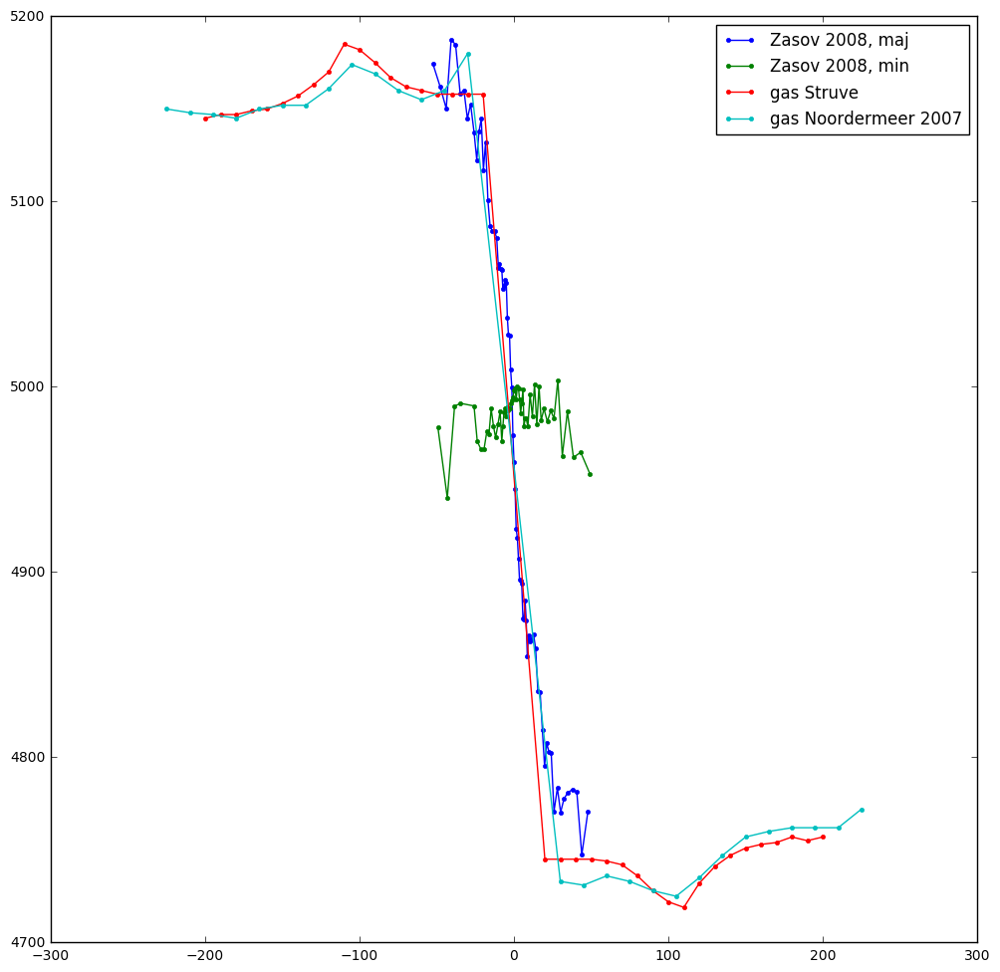

In [67]:
# Данные по звездной кинематике Засова 2012 вдоль большей полуоси, не исправленные за наклон 
zasov_raw_data = np.loadtxt("v_stars_maZ.dat", float)
r_ma, vel_ma, e_vel_ma, sig_ma, e_sig_ma = zip(*zasov_raw_data)

# Данные по звездной кинематике Засова 2012 вдоль малой полуоси, не исправленные за наклон 
zasov_raw_data = np.loadtxt("v_stars_miZ.dat", float)
r_mi, vel_mi, e_vel_mi, sig_mi, e_sig_mi = zip(*zasov_raw_data)

# Данные по кинематике газа Struve, WSRT (не исправлено за наклон)
wsrt_raw_data = np.loadtxt("v_gas_WSRT.dat", float)
r_wsrt, vel_wsrt, e_vel_wsrt = zip(*wsrt_raw_data)

# Данные по кинематике газа Noordermee 2007, WSRT (не исправлено за наклон?)
noord_raw_data = np.loadtxt("v_gas_noord.dat", float)
r_noord, vel_noord, e_vel_noord = zip(*noord_raw_data)

plt.plot(r_ma, vel_ma, '.-', label="Zasov 2008, maj")
plt.plot(r_mi, vel_mi, '.-', label="Zasov 2008, min")
plt.plot(r_wsrt, vel_wsrt, '.-', label="gas Struve")
plt.plot(r_noord, vel_noord, '.-', label="gas Noordermeer 2007")
plt.legend()
plt.plot()

[]

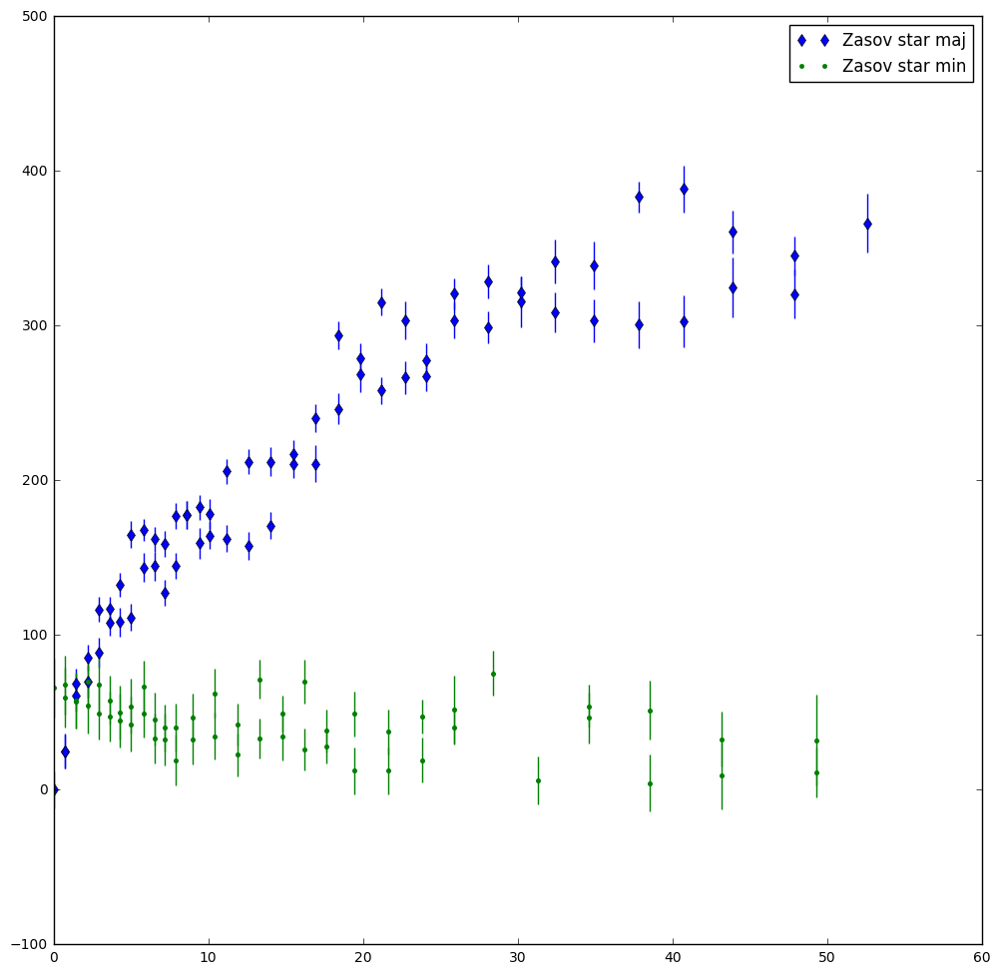

In [68]:
def incline_velocity(v, angle):
    return v / sin(angle * pi / 180)

# Переносит центр в (r0,v0) и перегибает кривую вращения, 
# а также исправляет за наклон если необходимо
def correct_rotation_curve(rdata, vdata, dvdata, r0, v0, incl):
    rdata_tmp = [abs(r-r0) for r in rdata]
    vdata_tmp = [incline_velocity(abs(v-v0), incl) for v in vdata]
    data = zip(rdata_tmp, vdata_tmp, dvdata)
    data.sort()
    return zip(*data)

r_ma_b, vel_ma_b, e_vel_b = correct_rotation_curve(r_ma, vel_ma, e_vel_ma,  0.0, 4959.3, incl)
r_mi_b, vel_mi_b, e_vel_mi_b = correct_rotation_curve(r_mi, vel_mi, e_vel_mi,  0.0, 4959.3, incl)

plt.plot(r_ma_b, vel_ma_b, 'd', label = 'Zasov star maj')
plt.errorbar(r_ma_b, vel_ma_b, yerr=e_vel_b, fmt='.', marker='.', mew=0, color='blue')
plt.plot(r_mi_b, vel_mi_b, '.', label = 'Zasov star min', color='green')
plt.errorbar(r_mi_b, vel_mi_b, yerr=e_vel_mi_b, fmt='.', marker='.', mew=0, color='green')
plt.legend()
plt.plot()

В дальнейшем используем только засовские данные по звездам по большой полуоси, приблизим их полиномом. 

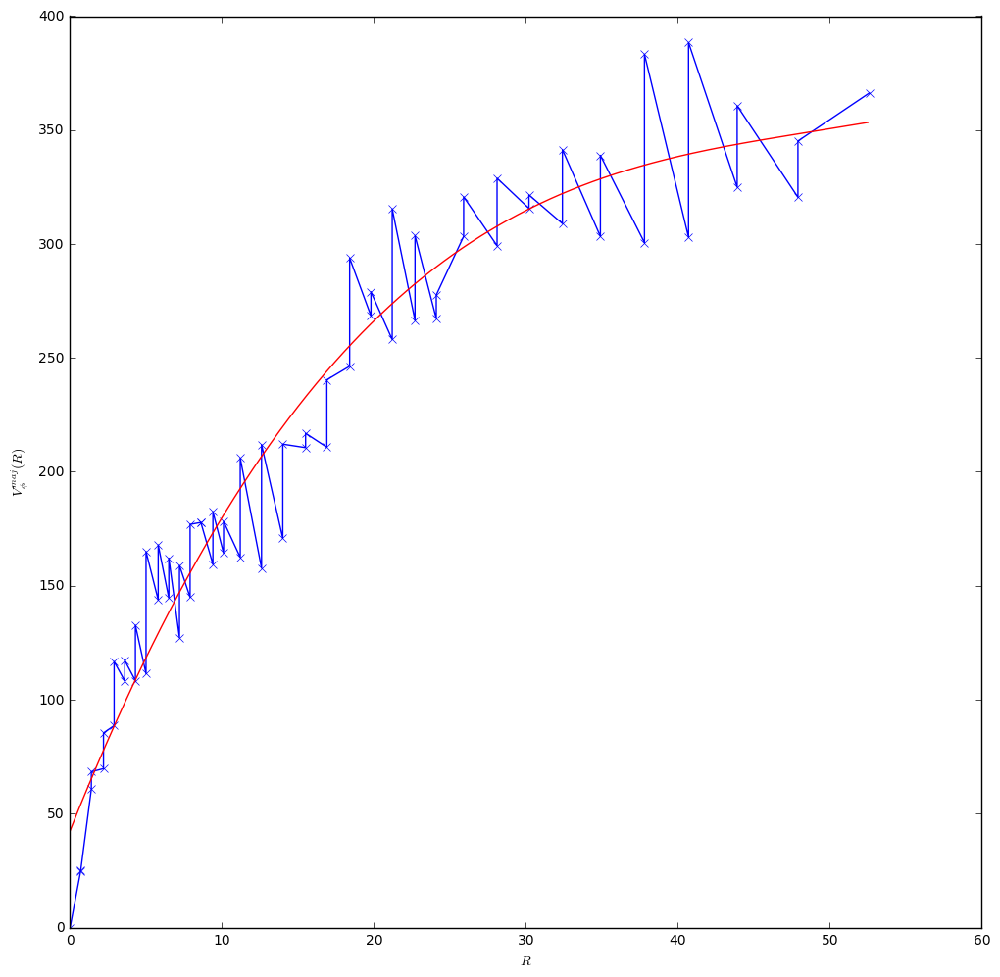

In [69]:
poly_star = poly1d(polyfit(r_ma_b, vel_ma_b, deg=3))

plt.plot(r_ma_b, vel_ma_b, 'x-', color='blue', markersize=6)
test_points = np.arange(0.0, max(r_ma_b), 0.1)
plt.plot(test_points, poly_star(test_points), '-', color='red')
plt.xlabel('$R$'); plt.ylim(0)
plt.ylabel('$V^{maj}_{\phi}(R)$')
plt.show()

In [70]:
os.chdir(tex_imgs_dir)

np.save('n1167_maj_rot', zip(r_ma_b, vel_ma_b, e_vel_b))
np.save('n1167_rot_poly', zip(test_points, poly_star(test_points)))

os.chdir("C:\\science\\2FInstability\\data\\ngc1167")

Кривая вращения нам нужна для нахождения соотношения $\sigma_{\varphi}^{2}/\sigma_{R}^{2}$, которое описывается уравнением ${\displaystyle \sigma_{\varphi}^{2}/\sigma_{R}^{2}=0.5\left(1+\frac{R}{\bar{v}_{\varphi}}\frac{d\bar{v}_{\varphi}}{dR}\right)}$ (Binney & Tremaine, 1987) и приближается гладко функцией $f=0.5(1+e^{-R/R_{0}}),$ где $R_{0}$ --- характерный масштаб. 

${\bf Примечание:}$ Такое приближение оправдано следующими соображениями. Для равновесного диска верно уравнение, описанное выше. Для твердотельного участка вращения в центральных областях выражение в скобках равно 2, а $\sigma_{\varphi}^{2}/\sigma_{R}^{2}=1$. На плоском участке кривой вращения на периферии диска $\sigma_{\varphi}^{2}/\sigma_{R}^{2}\thickapprox0.5$. Функция $f$ как раз аппроксимирует такое поведение отношения $\sigma_{\varphi}^{2}/\sigma_{R}^{2}$.

Изобразим получившийся профиль $\sigma_{\varphi}^{2}/\sigma_{R}^{2}$, вычисляемый через производную полинома:

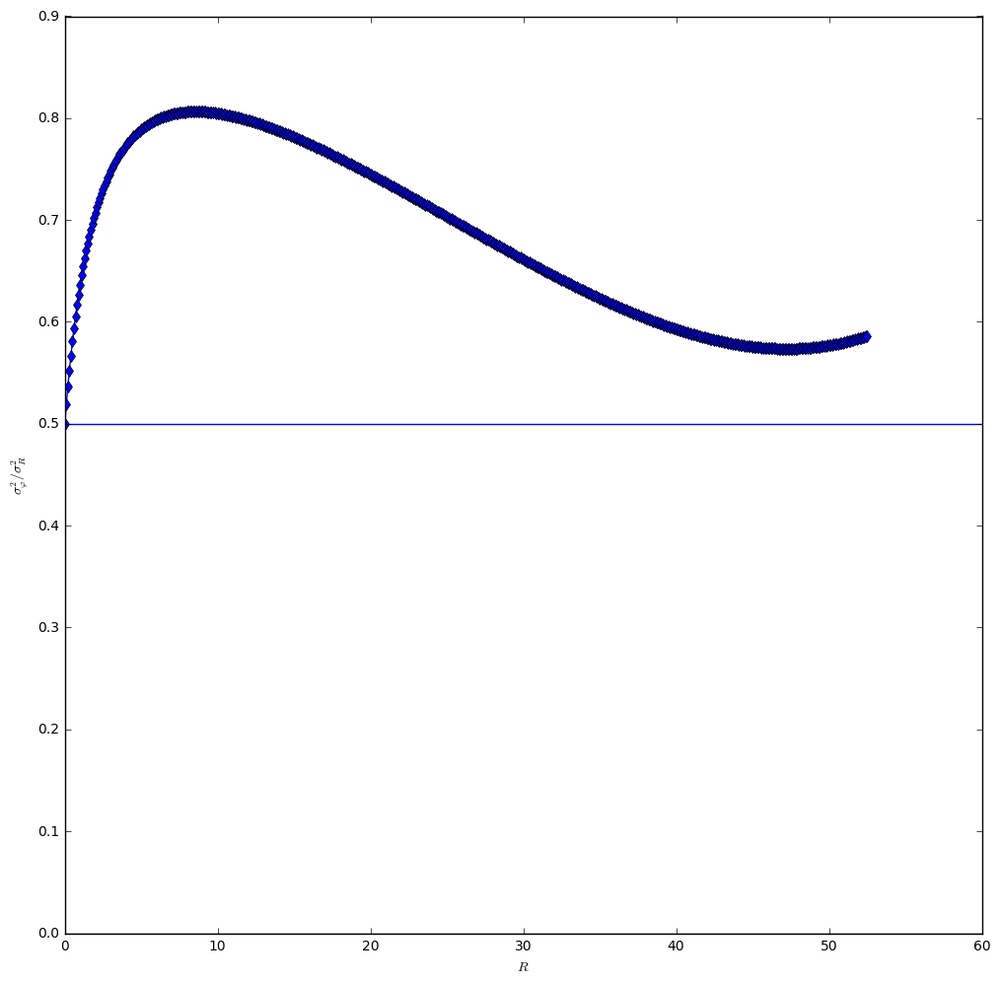

In [71]:
def sigPhi_to_sigR_real(R):
        return 0.5 * (1 + R*poly_star.deriv()(R) / poly_star(R))

plt.plot(test_points, [sigPhi_to_sigR_real(R) for R in test_points], 'd-', color='blue')
plt.axhline(y=0.5)
plt.axhline(y=0.0)
plt.xlabel('$R$')
plt.ylabel(r"$\sigma_{\varphi}^2/\sigma_{R}^2$")
plt.ylim(0)
plt.show()

Найдем теперь характерный масштаб $f=0.5(1+e^{-R/R_{0}})$:

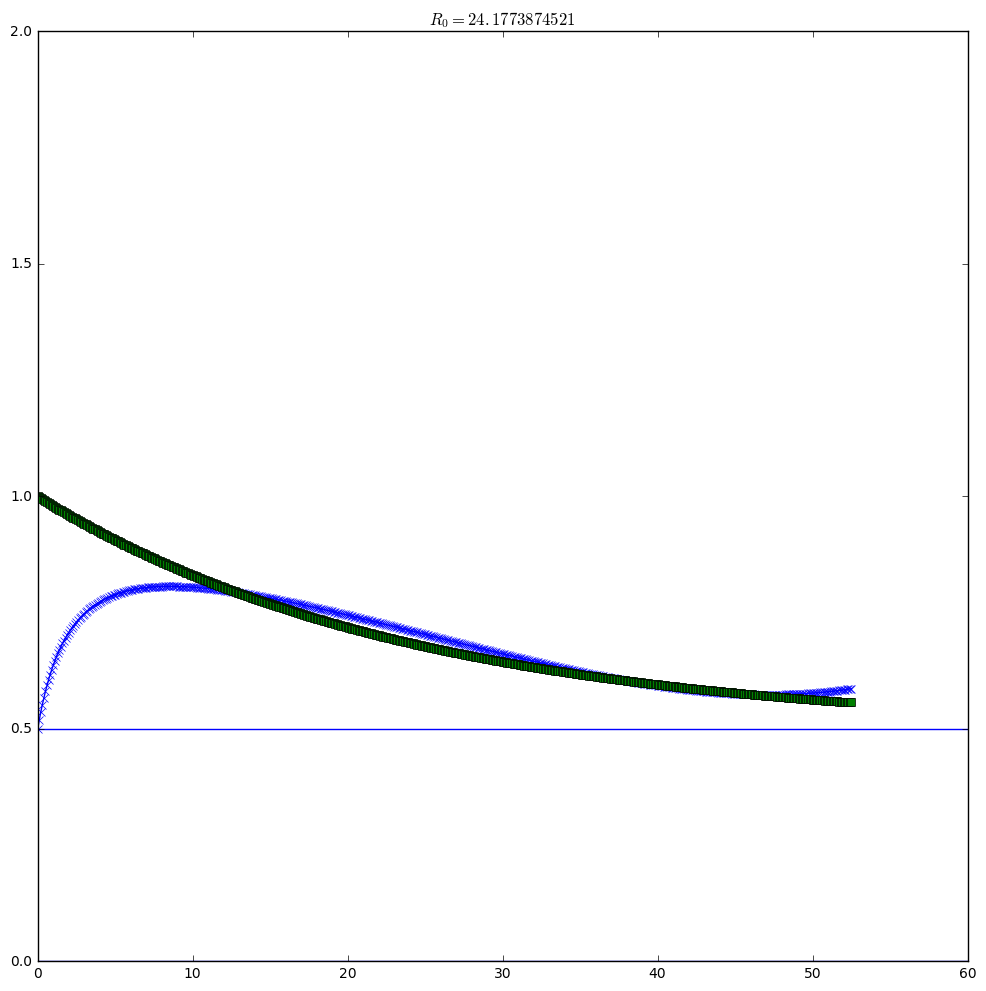

In [72]:
def f(R, Ro):
    return 0.5*(1 + np.exp( -R/Ro ))

xdata = test_points
ydata = sigPhi_to_sigR_real(xdata)

from scipy.optimize import curve_fit
popt, pcov = curve_fit(f, xdata, ydata, p0=[1.0])
Ro = popt[0]

plt.plot(xdata, ydata, 'x-')
plt.plot(xdata, [f(p, Ro) for p in xdata], 's')
plt.axhline(y=0.5)
plt.axhline(y=0.0)
plt.title('$R_{0} = %s $' % Ro)
plt.ylim(0, 2)
plt.show()

Теперь знаем значение отношения $\sigma_{\varphi}^{2}/\sigma_{R}^{2}$ в любой точке, заведем соответствующую функцию:

In [73]:
def sigPhi_to_sigR(R):
    return sqrt(f(R, Ro))

Построим графики дисперсий скоростей на луче зрения вдоль большой и малой оси ($\sigma_{los}^{maj}$ и $\sigma_{los}^{min}$):

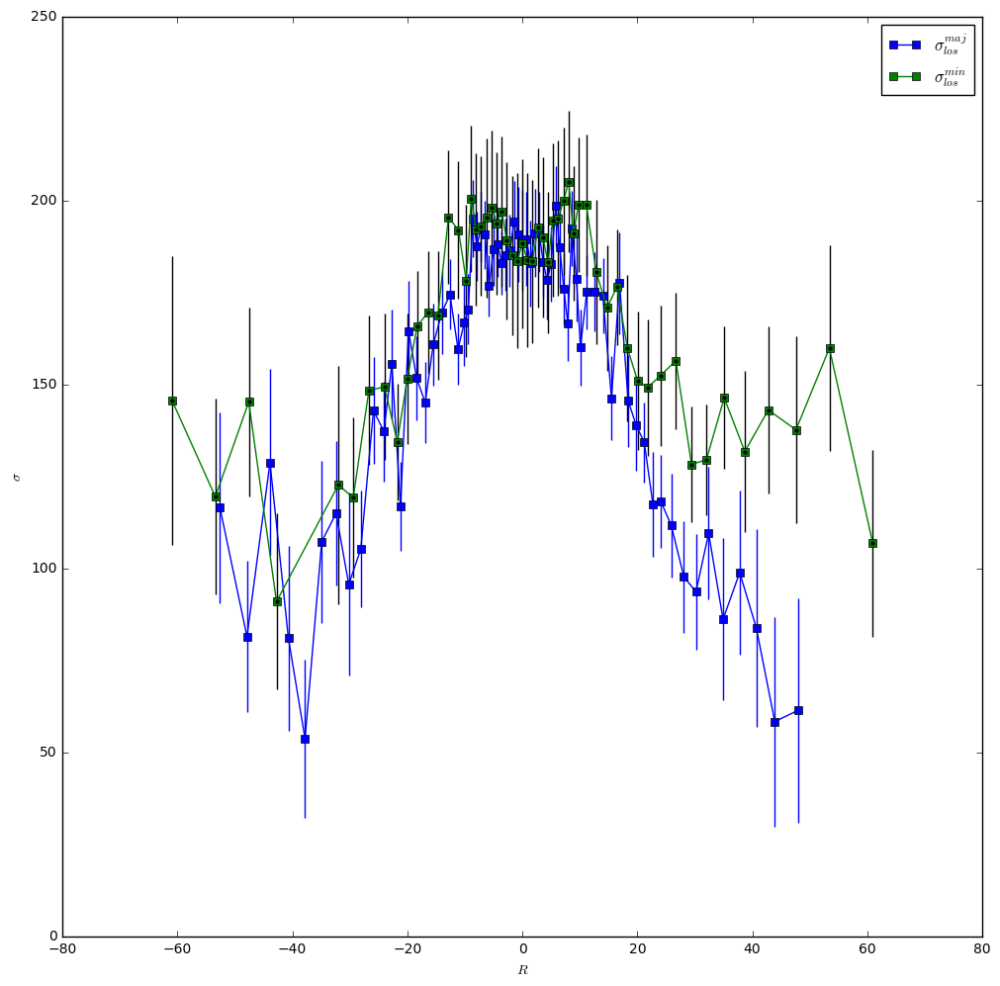

In [74]:
# Исправляем значения вдоль малой оси на синус угла:    
def correct_min(R):    
    return R / cos(incl * pi / 180) 

r_mi_extend = map(correct_min, r_mi)
    
plt.plot(r_ma, sig_ma, 's-', label='$\sigma_{los}^{maj}$')
plt.errorbar(r_ma, sig_ma, yerr=e_sig_ma, fmt='.', marker='.', mew=0, color='blue')
plt.plot(r_mi_extend, sig_mi, 's-', label='$\sigma_{los}^{min}$')
plt.errorbar(r_mi_extend, sig_mi, yerr=e_sig_mi, fmt='.', marker='.', mew=0, color='black')
plt.xlabel('$R$')
plt.ylabel('$\sigma$')
plt.legend()
plt.show()

Перегнем и приблизим полиномами:

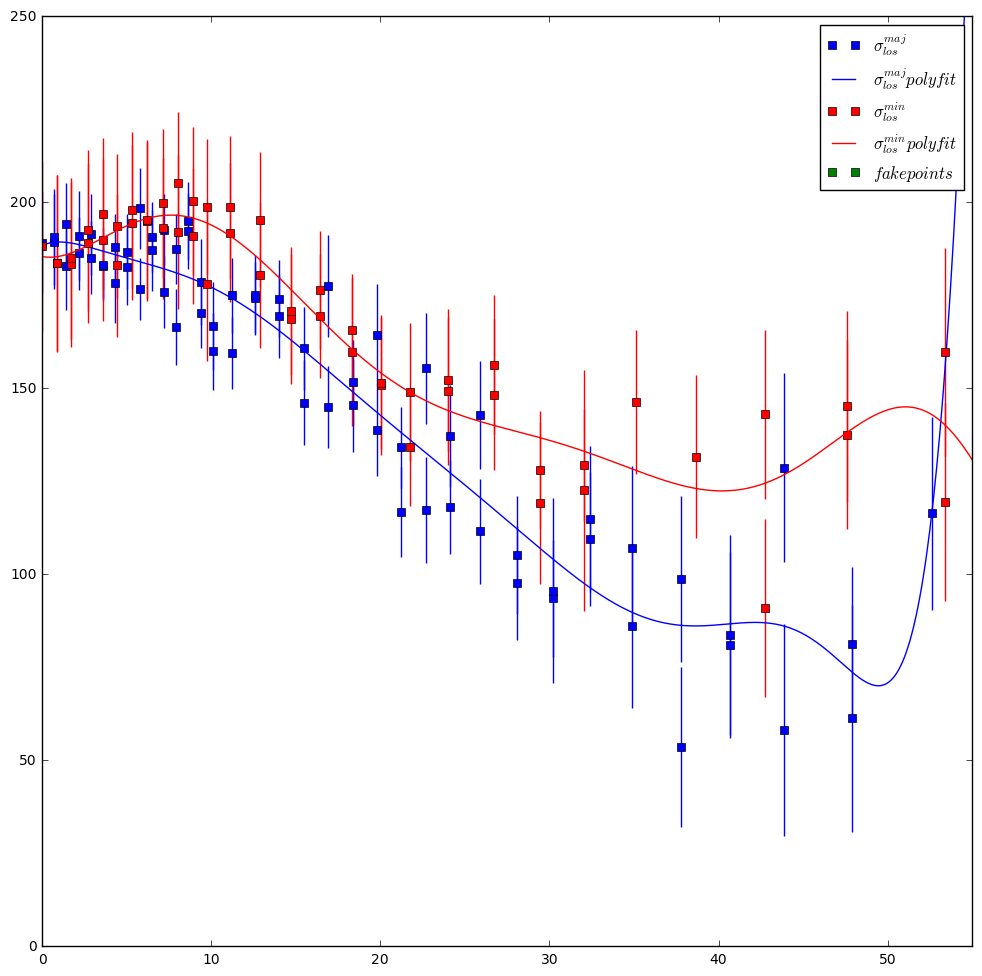

In [75]:
bind_curve = lambda p: (abs(p[0]), abs(p[1]), p[2])
sig_maj_data = zip(r_ma, sig_ma, e_sig_ma)
sig_maj_data = map(bind_curve, sig_maj_data)
sig_maj_data.sort()
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data) 

poly_sig_maj = poly1d(polyfit(radii_maj, sig_maj_p, deg=9))

sig_min_data = zip(r_mi_extend, sig_mi, e_sig_mi)
sig_min_data = map(bind_curve, sig_min_data)
sig_min_data.sort()
radii_min, sig_min_p, e_sig_min_p = zip(*sig_min_data) 

# Добавляем лишние точки чтобы протянуть дальше
num_fake_points = 10; expscale = 200.0
# fake_radii, fake_sig = zip(*[(31.0 + i, 115*exp(- i / expscale )) for i in range(1, num_fake_points+1)])
fake_radii, fake_sig = (),()

poly_sig_min = poly1d(polyfit(radii_min + fake_radii, sig_min_p + fake_sig, deg=9))

points = np.arange(0, max(radii_min), 0.1)
plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='.', marker='.', mew=0, color='blue')
plt.plot(points, poly_sig_maj(points), label = '$\sigma_{los}^{maj} polyfit$', color='blue')
plt.plot(radii_min, sig_min_p, 's', label='$\sigma_{los}^{min}$', color='red')
plt.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='.', marker='.', mew=0, color='red')
plt.plot(points, poly_sig_min(points), label = '$\sigma_{los}^{min} polyfit$', color='red')
plt.plot(fake_radii, fake_sig, 'bs', color='green', label='$fake points$')
plt.legend()
plt.ylim(0,250)
plt.xlim(0,55)
plt.show()

<h1 id="tocheading">Table of Contents</h1>
<div id="toc"></div>

In [76]:
%%javascript 
$.getScript('https://kmahelona.github.io/ipython_notebook_goodies/ipython_notebook_toc.js')

<IPython.core.display.Javascript object>

# 0. 0, sig_R_0=poly(0)

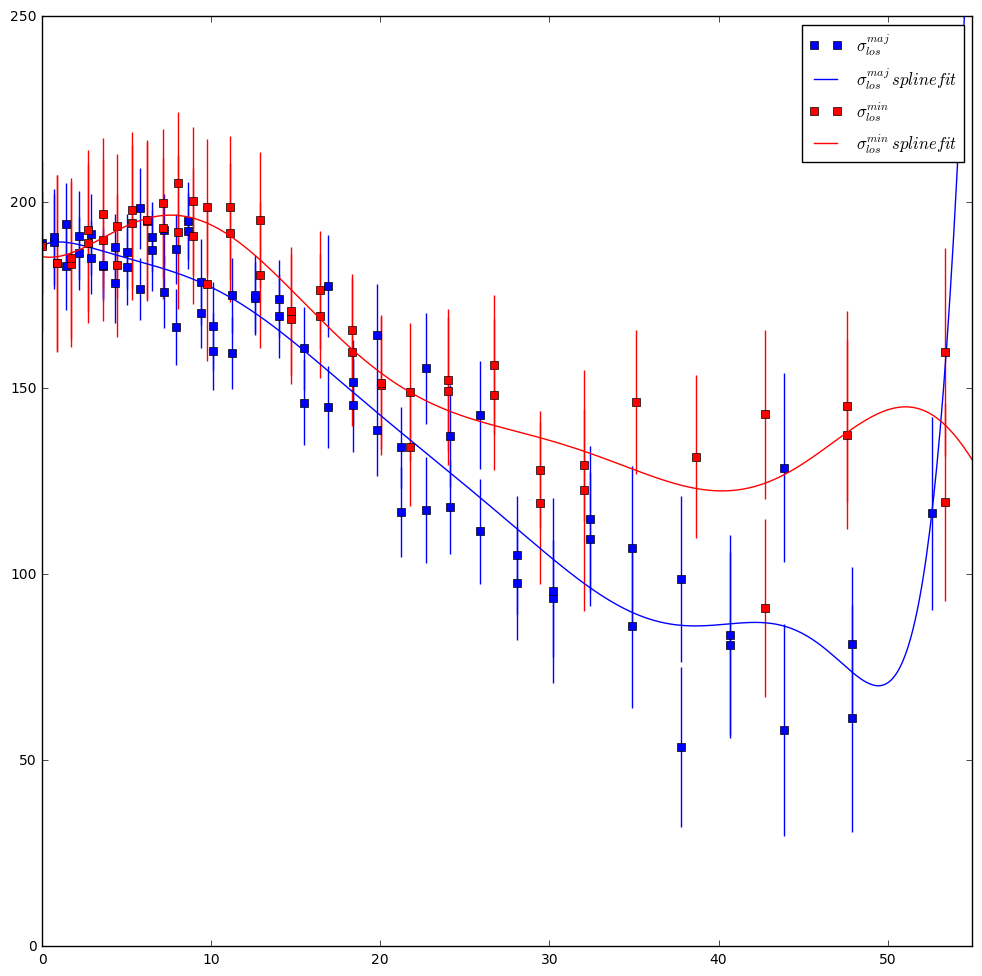

In [77]:
spl_maj = poly_sig_maj
spl_min = poly_sig_min

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='.', marker='.', mew=0, color='blue')
plt.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
plt.plot(radii_min, sig_min_p, 's', label='$\sigma_{los}^{min}$', color='red')
plt.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='.', marker='.', mew=0, color='red')
plt.plot(points, spl_min(points), label = '$\sigma_{los}^{min}\, splinefit$', color='red')
plt.legend()
plt.ylim(0,250)
plt.xlim(0,55)
plt.show()

poly_sig_maj = spl_maj
poly_sig_min = spl_min

In [78]:
#Значение sig_los_min в 0
sig_min_0 = poly_sig_min(0)
print sig_min_0

185.454960215


И восстановим профили $\sigma_{los}^{maj}$ и $\sigma_{los}^{min}$. Связь профилей описывается следующими уравнениями: $$\sigma_{los,maj}^2=\sigma_{\varphi}^2\sin^2i+\sigma_Z^2\cos^2i$$ $$\sigma_{los,min}^2=\sigma_R^2\sin^2i+\sigma_Z^2\cos^2i$$

In [79]:
# def sig_maj_exp(R):
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

# def sig_min_exp(R):
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)


cos_i, sin_i = cos(incl * pi / 180), sin(incl * pi / 180)


def sig_maj_exp(R):
    tmp = sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2
    if tmp > 0:
        return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2)
    else:
        return -1000000
#     return sig_R_0*spl_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR(R)**2 * sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

def sig_min_exp(R):
    return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

Теперь то, с чего надо было начинать - построим картинки для разных значений $\alpha$ и $\sigma_{R,0}$. Для того, чтобы найти где минимум, попробуем построить просто двумерные карты $\chi^2$ для разных $\sigma_{R,0}$  $\alpha$: (это очень долго, так что пересчитывать в крайнем случае) 

In [80]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

def compute_chi2_maps(alphas=(), sigmas=()):
    '''Вычисляем все изображения, чтобы потом только настройки менять'''
    image_min = np.random.uniform(size=(len(sigmas), len(alphas)))
    image_maj = np.random.uniform(size=(len(sigmas), len(alphas)))
    image = np.random.uniform(size=(len(sigmas), len(alphas)))
    for i,si in enumerate(sigmas):
        for j,al in enumerate(alphas):
            global alpha, sig_R_0
            alpha = al
            sig_R_0 = si
            sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
            sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
            sqerr_sum = 0.5*sqerr_maj+0.5*sqerr_min
            image[i][j] = sqerr_sum
            image_maj[i][j] = sqerr_maj
            image_min[i][j] = sqerr_min
    return image, image_maj, image_min
    
image, image_maj, image_min = compute_chi2_maps(alphas=alphas, sigmas=sigmas)

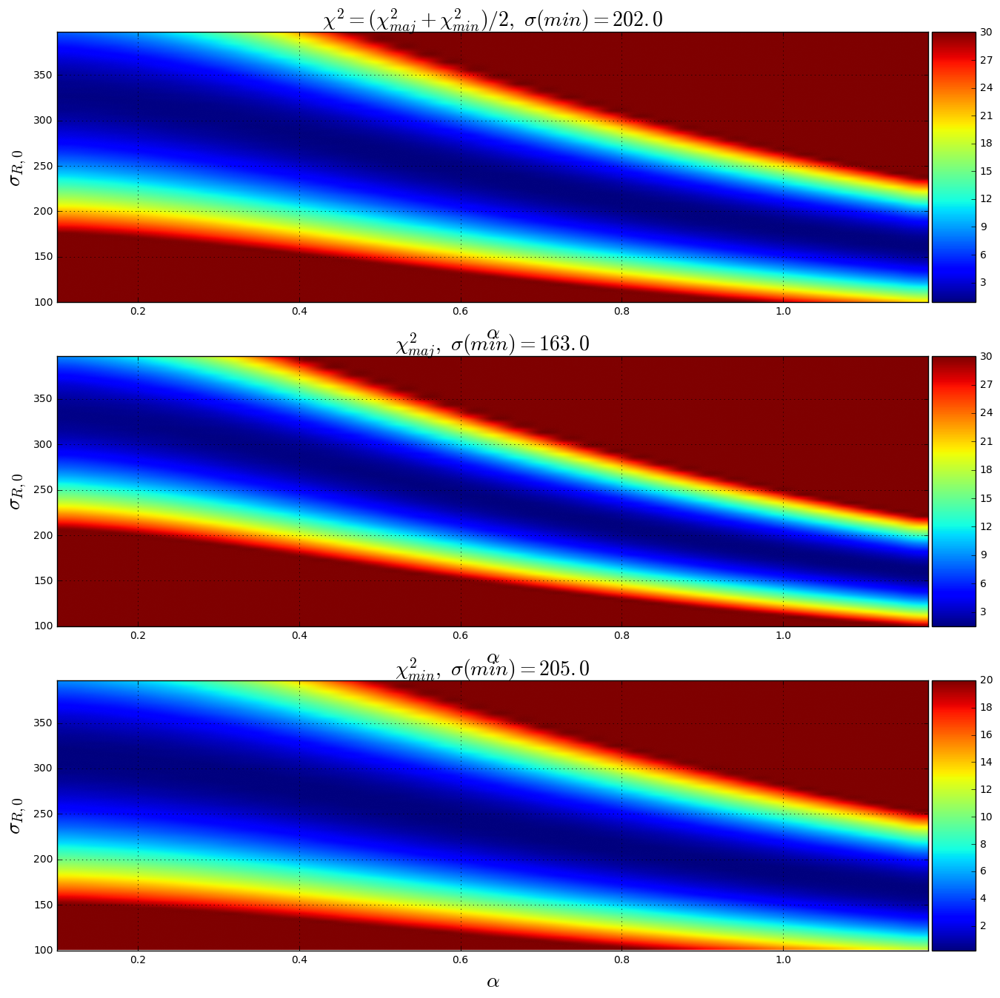

In [81]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_chi2_map(image, ax, log_scale=False, title='$\chi^2$', is_contour=False, vmax=0.):
    '''Рисуем получившиеся карты.
    Colormaps: http://wiki.scipy.org/Cookbook/Matplotlib/Show_colormaps'''
    if image is not None:
        if log_scale:
            image_log = np.apply_along_axis(np.log, 1, image)
            vmax = image_log.max()
        else:
            image_log = image
        if is_contour:
            norm = plt.cm.colors.Normalize(vmax=image.max(), vmin=-image.max())
            cmap = plt.cm.PRGn
            levels = np.concatenate([np.array([image_log.min()*1.1,]), np.linspace(start=image_log.min(), stop=vmax, num=10)])
            levels = sorted(levels)
            cset=ax.contour(image_log, levels, hold='on', colors = 'k', origin='lower', 
                            extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
            ax.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
        im = ax.imshow(image_log, cmap='jet', vmin=image_log.min(), vmax=vmax, interpolation='spline16', 
                   origin="lower", extent=[alphas[0], alphas[-1],sigmas[0],sigmas[-1]], aspect="auto")
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
        min_sigma = sigmas[int(np.where(image == image.min())[0])]        
        ax.set_title(title + '$,\ \sigma(min)=%s$' % min_sigma, size=20.)
        ax.set_ylabel('$\sigma_{R,0}$', size=20.)
        ax.set_xlabel(r'$\alpha$', size=20.)
        ax.grid(True)
 
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[16,16])
plot_chi2_map(image, axes[0], log_scale=False, title='$\chi^2 = (\chi^2_{maj} + \chi^2_{min})/2$', is_contour=False, vmax=30.)
plot_chi2_map(image_maj, axes[1], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=30.)
plot_chi2_map(image_min, axes[2], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=20.)
plt.show()

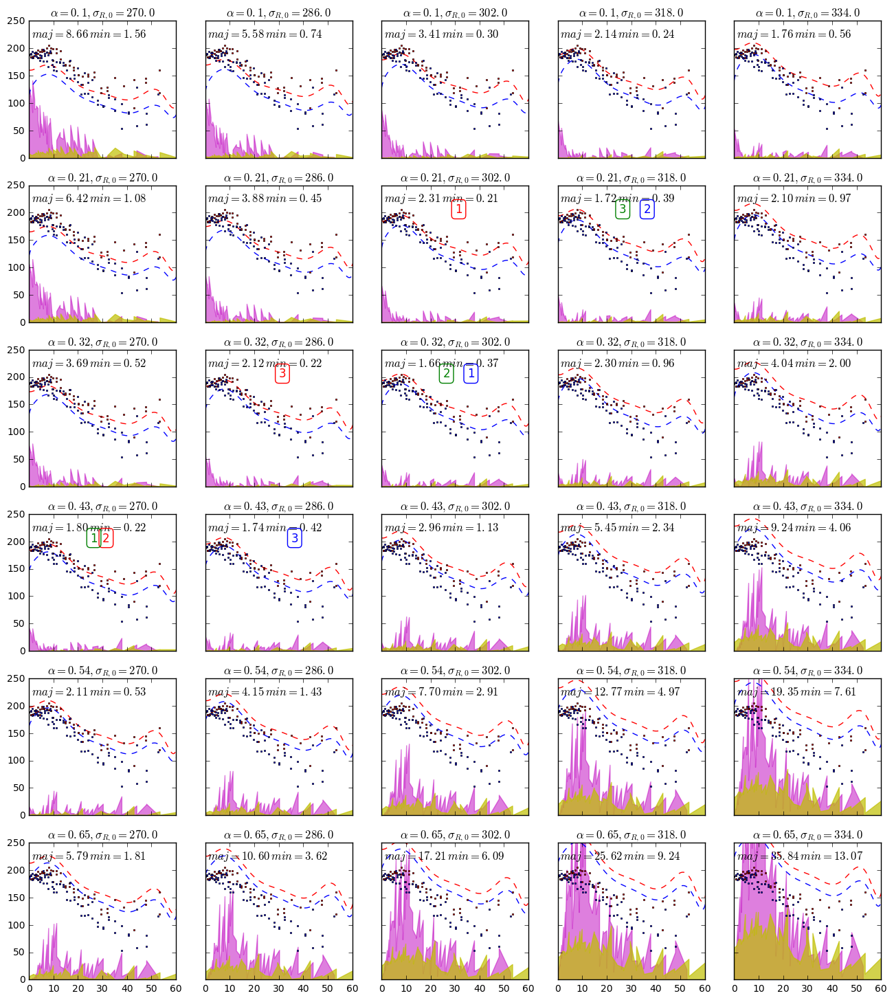

In [82]:
# Перебор alpha
alphas = np.arange(0.1, 0.7, 0.11)

# Перебор sig_R_0
sigmas = np.arange(270., 350., 16.)

# Те картинки, на которые стоит обратить особое внимание
good_pics = []
   
def plot_ranges(sigmas_range, alphas_range, good_pics=[], calc_chi=False, best_err=3, figsize=[16,18]):
    '''
    Для всех предложенных вариантов sigR и alpha
    рисует графики исходных и восстановленных дисперсий скоростей los.
    Если calc_chi = True, то также считает ошибку по наблюдаемым точкам.
    Если ошибка считается, то отмечаются best_err лучших (наименьших) результата.
    Синий - для большой оси, красный - малой, зеленый - полусумма.
    Изменяет глобальные значения sig_R_0 и alpha!'''
    nrows = alphas.size
    ncols = sigmas.size
    fig, axes = plt.subplots(nrows=nrows, ncols=ncols, sharex=True, sharey=True, figsize=figsize)
    plt_index = 0
    sqerr_majs, sqerr_mins, sqerr_mean = [],[],[]
    for al in alphas_range:
        for si in sigmas_range:
            global alpha, sig_R_0
            alpha = al
            sig_R_0 = si
            ax = axes[plt_index/ncols, plt_index % ncols]
            ax.set_title(r'$\alpha = %s, \sigma_{R,0}=%s$' % (al,si))
#             ax.plot(points, poly_sig_maj(points), '-', color='blue')
            ax.plot(points, [sig_maj_exp(Rr) for Rr in points], '--', color='blue')
#             ax.plot(points, poly_sig_min(points), '-', color='red')
            ax.plot(points, [sig_min_exp(R) for R in points], '--', color='red')
            if calc_chi:
                sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(p[0]) for p in sig_maj_data])
                sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(p[0]) for p in sig_min_data])
#                 sqerr_maj = sum(power([sig_maj_exp(p[0]) - p[1] for p in sig_maj_data], 2))/len(sig_maj_data)
#                 sqerr_min = sum(power([sig_min_exp(p[0]) - p[1] for p in sig_min_data], 2))/len(sig_min_data)
                ax.text(1, 220, "$maj=%5.2f\, min=%5.2f$" % (sqerr_maj, sqerr_min), fontsize=12)
                sqerr_majs.append(sqerr_maj);sqerr_mins.append(sqerr_min)
                sqerr_mean.append(0.5*sqerr_maj+0.5*sqerr_min)
            ax.set_ylim(0, 250)
            ax.set_xlim(0, 60)
            
            ax.plot(radii_min, sig_min_p, 's', color='red', ms=1.7)
            ax.plot(radii_maj, sig_maj_p, 's', color='blue', ms=1.7)
            
            chima = [300*(p[1]-sig_maj_exp(p[0]))**2/p[2]**2/len(sig_maj_data) for p in sig_maj_data]
#             ax.plot(radii_maj, chima, '.-', color='m')
            ax.fill_between(radii_maj, chima, [0]*len(chima), color='m', alpha=0.5)
    
#             print zip(chima, [(p[1]-sig_maj_exp(p[0]))**2 for p in sig_maj_data], sig_maj_p, 
#                       [sig_maj_exp(p[0]) for p in sig_maj_data], e_sig_maj_p)
    
            chimi = [300*(p[1]-sig_min_exp(p[0]))**2/p[2]**2/len(sig_min_data) for p in sig_min_data]
#             ax.plot(radii_maj, chima, '.-', color='m')
            ax.fill_between(radii_min, chimi, [0]*len(chimi), color='y', alpha=0.7)
            
            if (plt_index/ncols, plt_index % ncols) in good_pics:
                ax.plot([40], [200], 'o', markersize=12., color=(0.2,1.0,0.))
            plt_index = plt_index + 1
    if calc_chi:
        best_maj_err = heapq.nsmallest(best_err, sqerr_majs)
        for b_maj in best_maj_err:
            b_maj_ind = sqerr_majs.index(b_maj)
            ax = axes[b_maj_ind/ncols, b_maj_ind % ncols]
            #ax.plot([35], [200], 'o', markersize=12., color='b')
            ax.text(35, 200, "%s" % (best_maj_err.index(b_maj)+1), fontsize=12, color='b', 
                    bbox=dict(facecolor='none', edgecolor='b', boxstyle='round'))
        best_min_err = heapq.nsmallest(best_err, sqerr_mins)
        for b_min in best_min_err:
            b_min_ind = sqerr_mins.index(b_min)
            ax = axes[b_min_ind/ncols, b_min_ind % ncols]
            #ax.plot([30], [200], 'o', markersize=12., color='r')
            ax.text(30, 200, "%s" % (best_min_err.index(b_min)+1), fontsize=12, color='r', 
                    bbox=dict(facecolor='none', edgecolor='r', boxstyle='round'))
        best_mean_err = heapq.nsmallest(best_err, sqerr_mean)
        for b_mean in best_mean_err:
            b_mean_ind = sqerr_mean.index(b_mean)
            ax = axes[b_mean_ind/ncols, b_mean_ind % ncols]
            ax.text(25, 200, "%s" % (best_mean_err.index(b_mean)+1), fontsize=12, color='g', 
                    bbox=dict(facecolor='none', edgecolor='g', boxstyle='round'))

plot_ranges(sigmas, alphas, good_pics=good_pics, calc_chi=True)
plt.show()

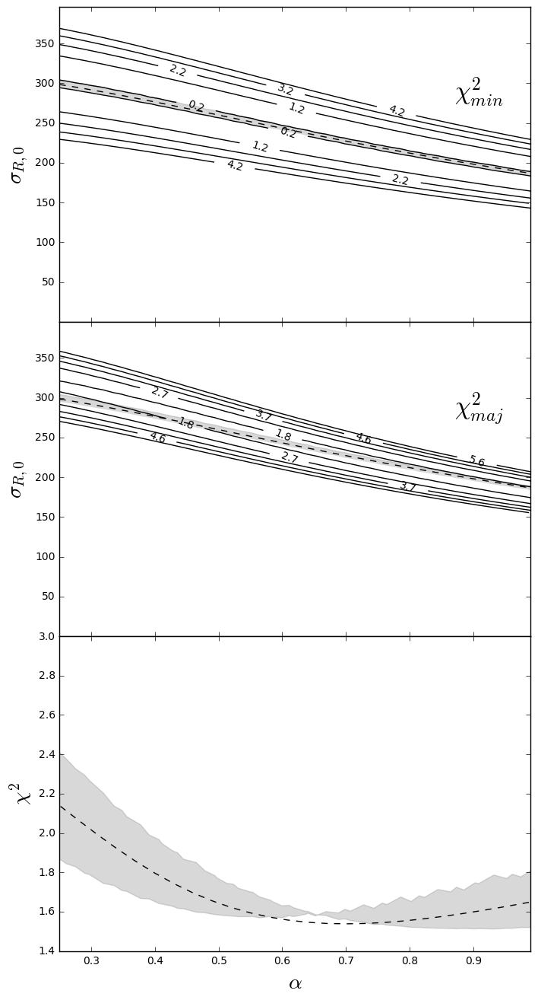

In [83]:
main_slice = lambda l: sig_min_0/sqrt(sin_i**2 + cos_i**2 * l**2)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

# os.chdir("C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\paper1\\text\\imgs")

alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
# levels = np.linspace(start=image_min.min(), stop=20., num=5)
# levels = [100., 125., 150., 175., 200.]
# levels = [image_min.min()+0.02, image_min.min()+0.4, image_min.min()+1.1, image_min.min()+2., 
#           image_min.min()+3.1, image_min.min()+4.1]
# levels = np.linspace(start=image_min.min()+0.1, stop=image_min.min()+4.1, num=5)
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
# im = ax.imshow(image_min, cmap='jet', vmin=image_min.min(), vmax=20., interpolation='spline16', 
#                    origin="lower", aspect="auto")
# plt.show()
cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()
v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
# ax.set_ylim(180, 300)
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')

ax = axes[1]
# levels = np.linspace(start=image_maj.min()-4.3, stop=10., num=10)
# levels = [7., 10., 50., 100.]
# levels = [image_maj.min()+0.2, image_maj.min()+0.7, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = np.linspace(start=image_maj.min()+0.3, stop=image_maj.min()+4.1, num=5)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')

ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
# ax.set_ylim(150, 320)

ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)


ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

# ax.set_ylim(3.1, 3.5)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)

# plt.savefig('ngc1167_maps.eps', format='eps')
# plt.savefig('ngc1167_maps.png', format='png')
# plt.savefig('ngc1167_maps.pdf', format='pdf', dpi=150)

plt.show()

N1_maj=68,	 N2_min=55,	 chi^2_corr[0][0]=68.7042177525 (was 33.8471376299 and 96.8974443223)


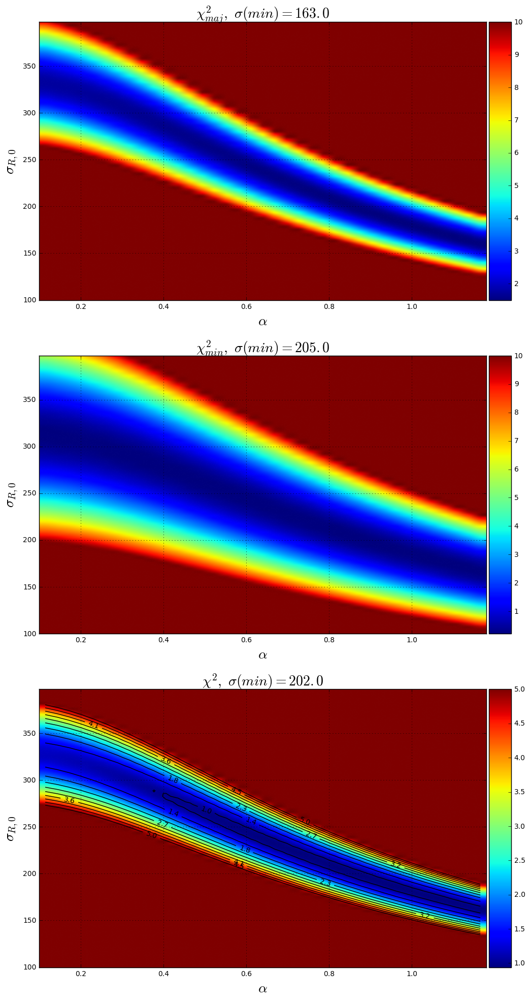

In [84]:
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[12,24])
plot_chi2_map(image_maj, axes[0], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=10.)
plot_chi2_map(image_min, axes[1], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=10.)
corr_image = (image_min*len(sig_min_p) + image_maj*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
print 'N1_maj={},\t N2_min={},\t chi^2_corr[0][0]={} (was {} and {})'.format(len(sig_maj_p), len(sig_min_p), corr_image[0][0], 
                                                                            image_min[0][0], image_maj[0][0])
plot_chi2_map(corr_image, axes[2], log_scale=False, title='$\chi^2$', is_contour=True, vmax=5.)
plt.show()

In [85]:
import scipy.optimize as opt

def chisqfunc((x_sig, x_alpha)):
    global sig_R_0, alpha
    sig_R_0 = x_sig
    alpha = x_alpha
    sqerr_ma = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    sqerr_mi = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
    chisq = (sqerr_mi*len(sig_min_p) + sqerr_ma*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
    return chisq

x0 = np.array([100., 0.5])

res = opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B')
print res

      fun: 0.94009584881792119
 hess_inv: <2x2 LbfgsInvHessProduct with dtype=float64>
      jac: array([  1.11022302e-08,  -1.68753900e-06])
  message: 'CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL'
     nfev: 84
      nit: 19
   status: 0
  success: True
        x: array([ 206.97295129,    0.81899936])


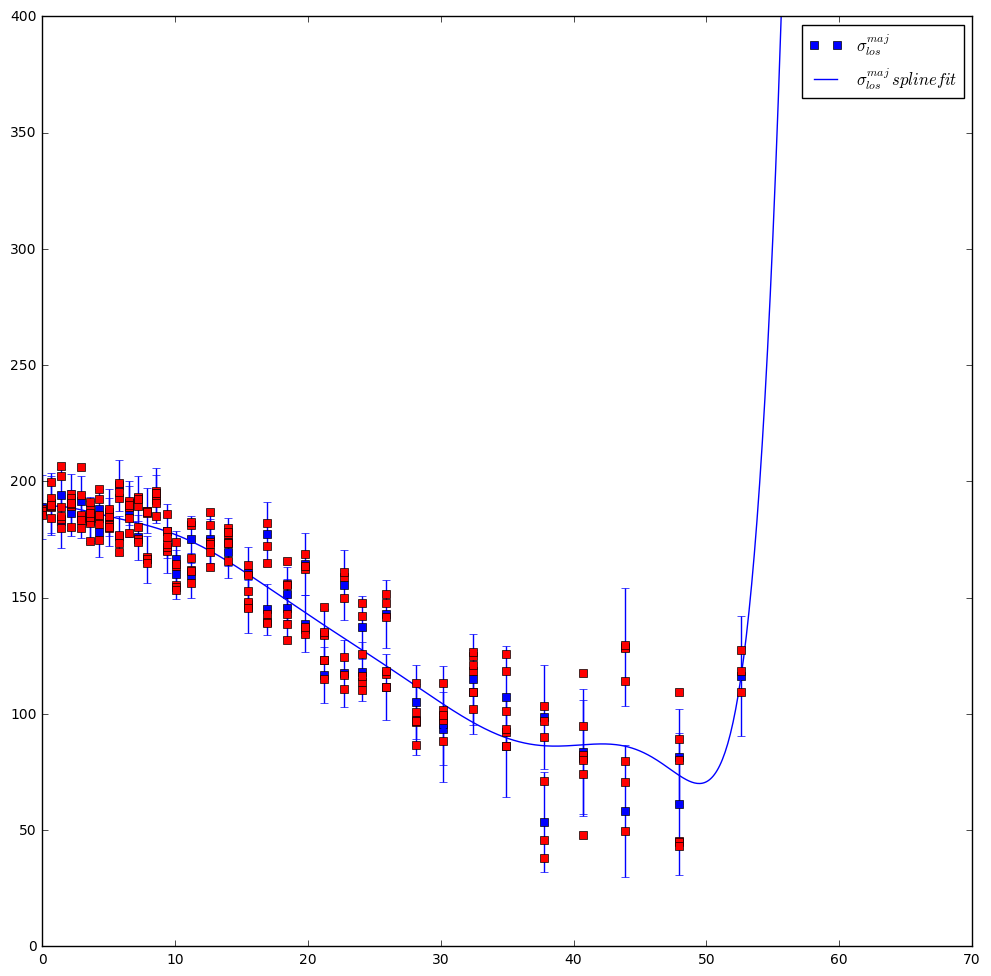

In [86]:
def gen_next_normal(radii, sig, esig):
    randomDelta =  np.array([np.random.normal(0., derr/2, 1)[0] for derr in esig] ) 
    randomdataY = sig + randomDelta
    return zip(radii, randomdataY)

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='o', marker='.', color='blue')
plt.plot(points, poly_sig_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
 
for i in range(3):
    r, s = zip(*gen_next_normal(radii_maj, sig_maj_p, e_sig_maj_p))
    plt.plot(r, s, 's', color='red')

plt.ylim(0., 400.)
plt.legend()
plt.show()

In [87]:
os.chdir("C:\\science\\2FInstability\\data\\ngc1167")
pics_path = '.cutted\\pics\\'
import time

N = 300

result = []

start_time = time.time()

if not os.path.exists(pics_path):
    os.makedirs(pics_path)
if os.path.isfile(pics_path + 'monte_carlo_pm.npy'):
    result = np.load(pics_path + "monte_carlo_pm.npy")
else:
    for i in log_progress(range(N)):
        global poly_sig_maj, poly_sig_min
        r, s = zip(*gen_next_normal(radii_maj, sig_maj_p, e_sig_maj_p))
    #     poly_sig_maj = inter.UnivariateSpline(r, s, k=3, s=10000., w=w(e_sig_maj_p))
        poly_sig_maj = poly1d(polyfit(r, s,  deg=9))

        r, s = zip(*gen_next_normal(radii_min, sig_min_p, e_sig_min_p))
    #     poly_sig_min = inter.UnivariateSpline(r, s, k=3, s=10000., w=w(e_sig_min_p))
        poly_sig_min = poly1d(polyfit(r, s,  deg=9))

    #     result.append((opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B').x,
    #                   poly_sig_maj.get_coeffs(), poly_sig_min.get_coeffs()))
        result.append((opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B').x,
                      poly_sig_maj.coeffs, poly_sig_min.coeffs))
    np.save(pics_path + 'monte_carlo_pm', np.array(result))
print("--- %s seconds ---" % (time.time() - start_time))

--- 0.0150001049042 seconds ---


In [88]:
len(result)

300

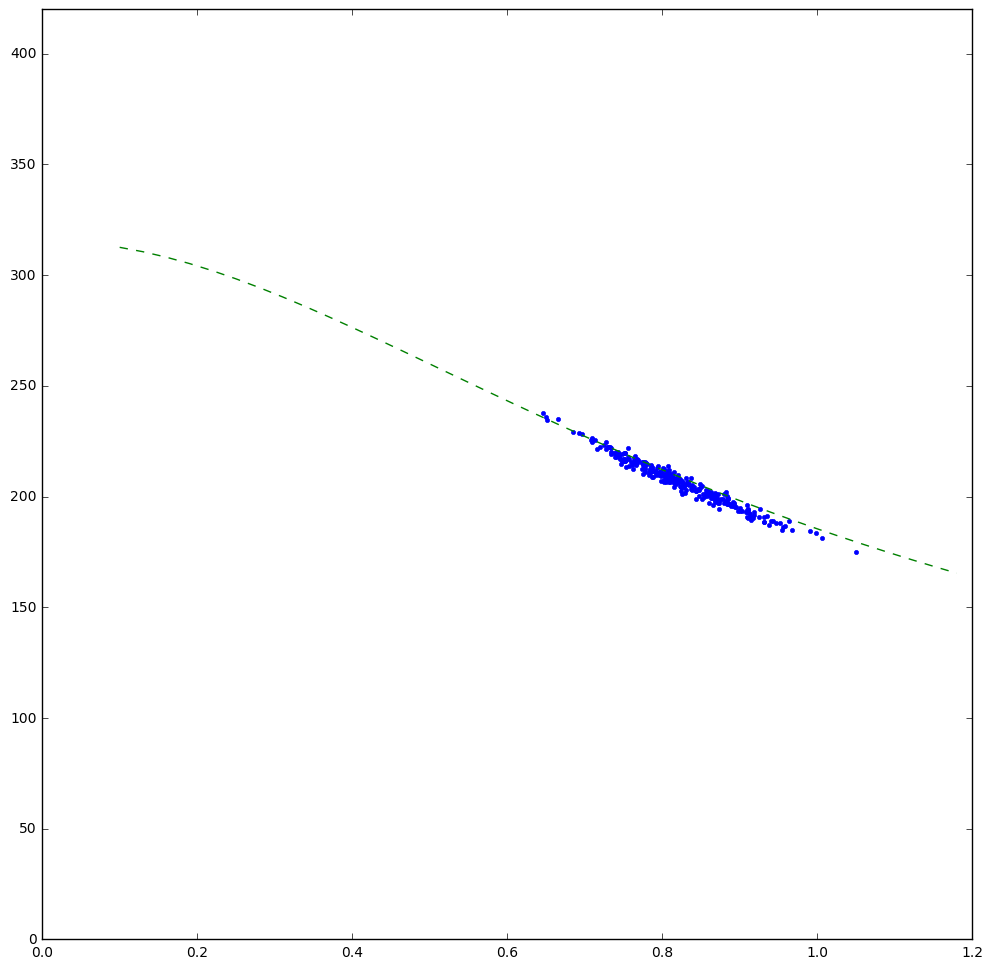

In [89]:
s, _, _ = zip(*result)
s,a = zip(*s)
plt.plot(a, s, '.')
plt.plot(alphas, map(main_slice, alphas), '--')
# plt.xlim(0.0, 0.99)
plt.ylim(0, 420)
plt.show()

In [90]:
# sig_maj_data = zip(r_ma[:-1], sig_ma[:-1], e_sig_ma[:-1]) #почему тут до -1?
sig_maj_data = zip(r_ma, sig_ma, e_sig_ma)
sig_maj_data = map(bind_curve, sig_maj_data)
sig_maj_data.sort()
radii_maj1, sig_maj_p1, e_sig_maj_p1 = zip(*sig_maj_data) 

sig_min_data = zip(r_mi_extend, sig_mi, e_sig_mi)
sig_min_data = map(bind_curve, sig_min_data)
sig_min_data.sort()
radii_min1, sig_min_p1, e_sig_min_p1 = zip(*sig_min_data) 

points = np.arange(0, max(radii_min), 0.1)

# 1. r_ef, sig_R_0=spline(0)

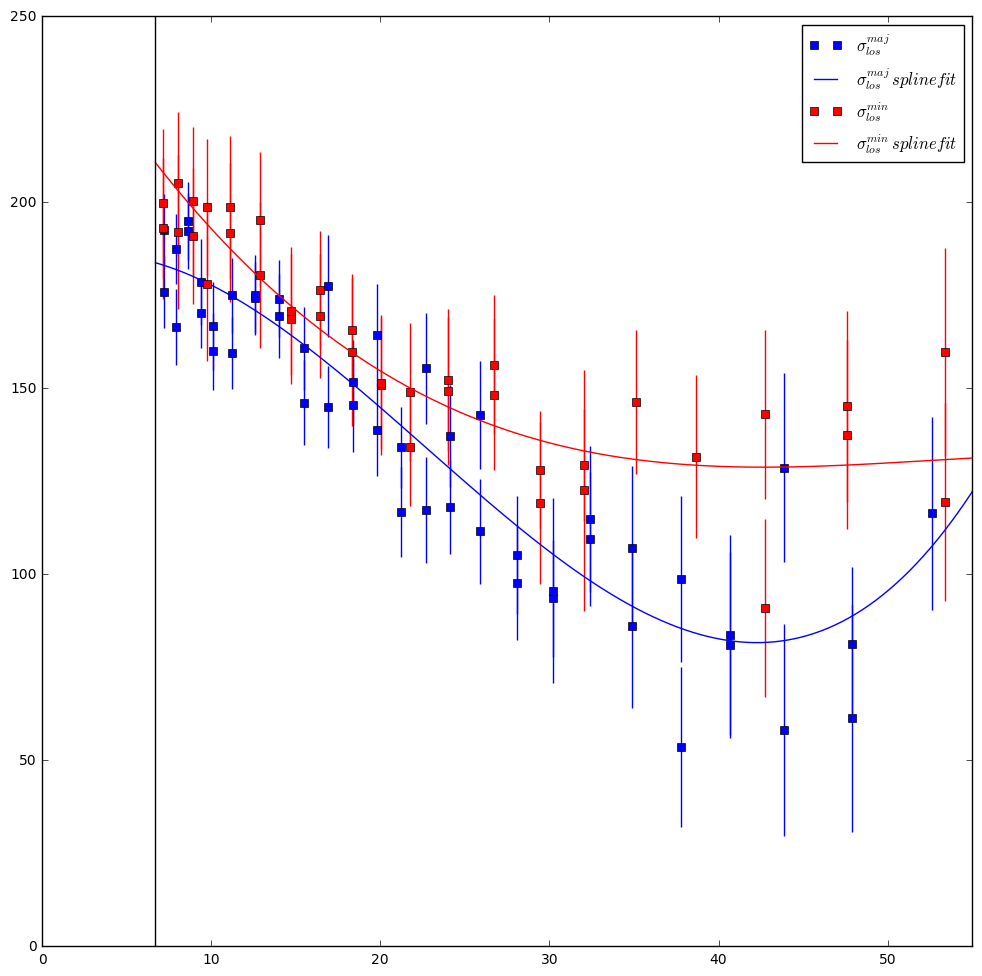

In [91]:
# Граница. по которой обрезаем
cutted = r_eb

sig_maj_data = zip(radii_maj1, sig_maj_p1, e_sig_maj_p1)
sig_maj_data = filter(lambda l: l[0] > cutted, sig_maj_data)
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data) 

sig_min_data = zip(radii_min1, sig_min_p1, e_sig_min_p1)
sig_min_data = filter(lambda l: l[0] > cutted, sig_min_data)
radii_min, sig_min_p, e_sig_min_p = zip(*sig_min_data) 

points = np.arange(cutted, max(radii_min), 0.1)

def w(arr):
    return map(lambda l: 1/(1. + l**2), arr)

spl_maj = inter.UnivariateSpline(radii_maj[::-1], sig_maj_p[::-1], k=3, s=10000., w=w(e_sig_maj_p))
spl_min = inter.UnivariateSpline(radii_min[::-1], sig_min_p[::-1], k=3, s=10000., w=w(e_sig_min_p))

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='.', marker='.', mew=0, color='blue')
plt.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
plt.plot(radii_min, sig_min_p, 's', label='$\sigma_{los}^{min}$', color='red')
plt.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='.', marker='.', mew=0, color='red')
plt.plot(points, spl_min(points), label = '$\sigma_{los}^{min}\, splinefit$', color='red')
plt.axvline(x=cutted, color='black')
plt.legend()
plt.ylim(0,250)
plt.xlim(0,55)
plt.show()

poly_sig_maj = spl_maj
poly_sig_min = spl_min

In [92]:
#Значение sig_los_min в 0
sig_min_0 = poly_sig_min(0)
print sig_min_0

255.840463841


И восстановим профили $\sigma_{los}^{maj}$ и $\sigma_{los}^{min}$. Связь профилей описывается следующими уравнениями: $$\sigma_{los,maj}^2=\sigma_{\varphi}^2\sin^2i+\sigma_Z^2\cos^2i$$ $$\sigma_{los,min}^2=\sigma_R^2\sin^2i+\sigma_Z^2\cos^2i$$

In [93]:
# def sig_maj_exp(R):
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

# def sig_min_exp(R):
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)


cos_i, sin_i = cos(incl * pi / 180), sin(incl * pi / 180)


def sig_maj_exp(R):
    tmp = sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2
    if tmp > 0:
        return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2)
    else:
        return -1000000
#     return sig_R_0*spl_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR(R)**2 * sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

def sig_min_exp(R):
    return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

Теперь то, с чего надо было начинать - построим картинки для разных значений $\alpha$ и $\sigma_{R,0}$. Для того, чтобы найти где минимум, попробуем построить просто двумерные карты $\chi^2$ для разных $\sigma_{R,0}$  $\alpha$: (это очень долго, так что пересчитывать в крайнем случае) 

In [94]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

def compute_chi2_maps(alphas=(), sigmas=()):
    '''Вычисляем все изображения, чтобы потом только настройки менять'''
    image_min = np.random.uniform(size=(len(sigmas), len(alphas)))
    image_maj = np.random.uniform(size=(len(sigmas), len(alphas)))
    image = np.random.uniform(size=(len(sigmas), len(alphas)))
    for i,si in enumerate(sigmas):
        for j,al in enumerate(alphas):
            global alpha, sig_R_0
            alpha = al
            sig_R_0 = si
            sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
            sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
            sqerr_sum = 0.5*sqerr_maj+0.5*sqerr_min
            image[i][j] = sqerr_sum
            image_maj[i][j] = sqerr_maj
            image_min[i][j] = sqerr_min
    return image, image_maj, image_min
    
image, image_maj, image_min = compute_chi2_maps(alphas=alphas, sigmas=sigmas)

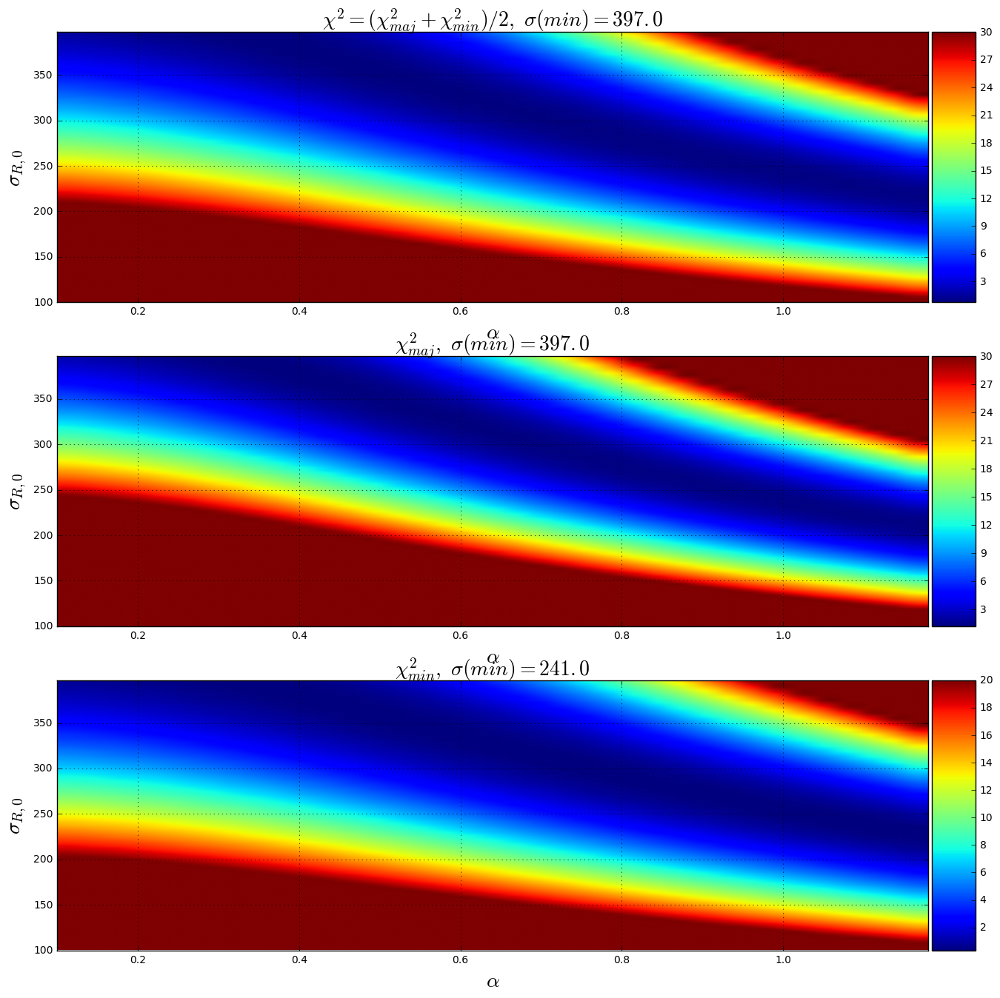

In [95]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_chi2_map(image, ax, log_scale=False, title='$\chi^2$', is_contour=False, vmax=0.):
    '''Рисуем получившиеся карты.
    Colormaps: http://wiki.scipy.org/Cookbook/Matplotlib/Show_colormaps'''
    if image is not None:
        if log_scale:
            image_log = np.apply_along_axis(np.log, 1, image)
            vmax = image_log.max()
        else:
            image_log = image
        if is_contour:
            norm = plt.cm.colors.Normalize(vmax=image.max(), vmin=-image.max())
            cmap = plt.cm.PRGn
            levels = np.concatenate([np.array([image_log.min()*1.1,]), np.linspace(start=image_log.min(), stop=vmax, num=10)])
            levels = sorted(levels)
            cset=ax.contour(image_log, levels, hold='on', colors = 'k', origin='lower', 
                            extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
            ax.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
        im = ax.imshow(image_log, cmap='jet', vmin=image_log.min(), vmax=vmax, interpolation='spline16', 
                   origin="lower", extent=[alphas[0], alphas[-1],sigmas[0],sigmas[-1]], aspect="auto")
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
        min_sigma = sigmas[int(np.where(image == image.min())[0])]        
        ax.set_title(title + '$,\ \sigma(min)=%s$' % min_sigma, size=20.)
        ax.set_ylabel('$\sigma_{R,0}$', size=20.)
        ax.set_xlabel(r'$\alpha$', size=20.)
        ax.grid(True)
 
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[16,16])
plot_chi2_map(image, axes[0], log_scale=False, title='$\chi^2 = (\chi^2_{maj} + \chi^2_{min})/2$', is_contour=False, vmax=30.)
plot_chi2_map(image_maj, axes[1], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=30.)
plot_chi2_map(image_min, axes[2], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=20.)
plt.show()

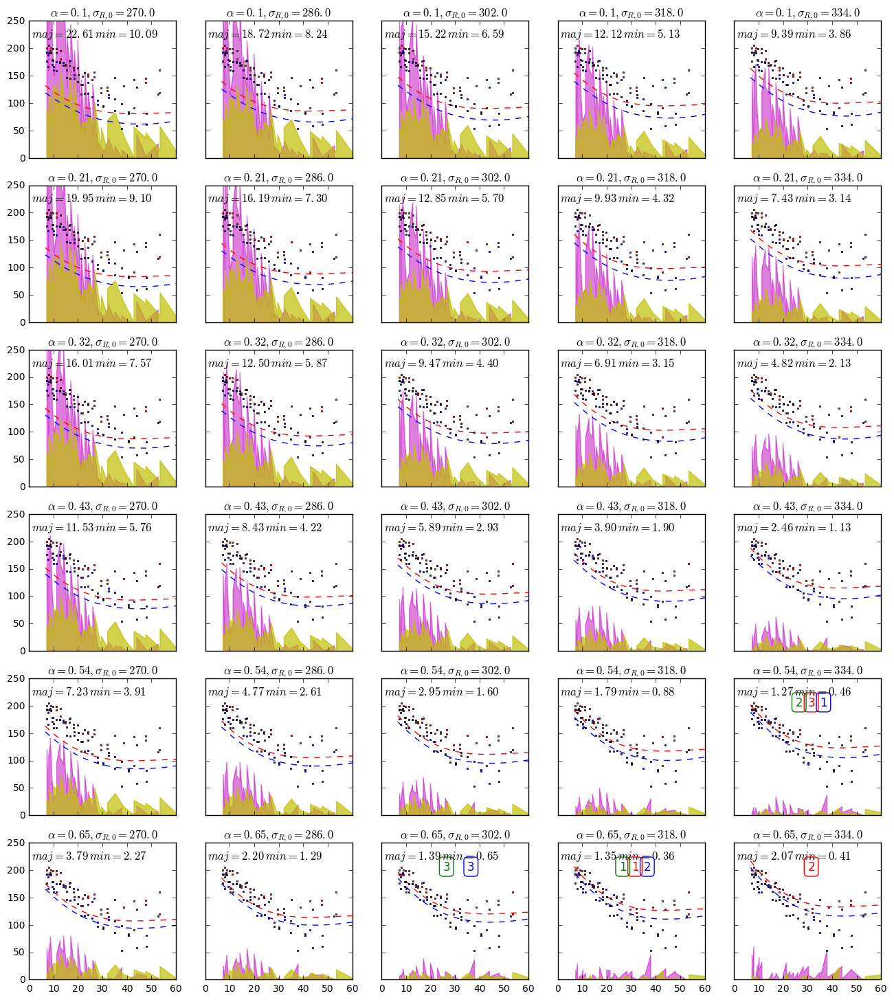

In [96]:
# Перебор alpha
alphas = np.arange(0.1, 0.7, 0.11)

# Перебор sig_R_0
sigmas = np.arange(270., 350., 16.)

# Те картинки, на которые стоит обратить особое внимание
good_pics = []

# def plot_ranges(sigmas_range, alphas_range, good_pics=[], calc_chi=False, best_err=3):
#     '''
#     Для всех предложенных вариантов sigR и alpha
#     рисует графики исходных и восстановленных дисперсий скоростей los.
#     Если calc_chi = True, то также считает ошибку по наблюдаемым точкам.
#     Если ошибка считается, то отмечаются best_err лучших (наименьших) результата.
#     Синий - для большой оси, красный - малой, зеленый - полусумма.
#     Изменяет глобальные значения sig_R_0 и alpha!'''
#     nrows = alphas.size
#     ncols = sigmas.size
#     fig, axes = plt.subplots(nrows=nrows, ncols=ncols, sharex=True, sharey=True, figsize=[16,12])
#     plt_index = 0
#     # Последнее - среднее геометрическое
#     sqerr_majs, sqerr_mins, sqerr_mean = [],[],[]
#     for al in alphas_range:
#         for si in sigmas_range:
#             global alpha, sig_R_0
#             alpha = al
#             sig_R_0 = si
#             ax = axes[plt_index/ncols, plt_index % ncols]
#             ax.set_title(r'$\alpha = %s, \sigma_{R,0}=%s$' % (al,si))
#             ax.plot(points, poly_sig_maj(points), '-', color='blue')
#             ax.plot(points, [sig_maj_exp(Rr) for Rr in points], '--', color='blue')
#             ax.plot(points, poly_sig_min(points), '-', color='red')
#             ax.plot(points, [sig_min_exp(R) for R in points], '--', color='red')
#             if calc_chi:
#                 sqerr_maj = sum(power([sig_maj_exp(p[0]) - p[1] for p in sig_maj_data], 2))/len(sig_maj_data)
#                 sqerr_min = sum(power([sig_min_exp(p[0]) - p[1] for p in sig_min_data], 2))/len(sig_min_data)
#                 ax.text(1, 5, "$\chi^2_{maj}=%5.0f\, \chi^2_{min}=%5.0f$" % (sqerr_maj, sqerr_min), fontsize=12)
#                 sqerr_majs.append(sqerr_maj);sqerr_mins.append(sqerr_min)
#                 sqerr_mean.append(0.5*sqerr_maj+0.5*sqerr_min)
#             ax.set_ylim(0, 250)
#             ax.set_xlim(0, 50)
#             if (plt_index/ncols, plt_index % ncols) in good_pics:
#                 ax.plot([40], [200], 'o', markersize=12., color=(0.2,1.0,0.))
#             plt_index = plt_index + 1
#     if calc_chi:
#         best_maj_err = heapq.nsmallest(best_err, sqerr_majs)
#         for b_maj in best_maj_err:
#             b_maj_ind = sqerr_majs.index(b_maj)
#             ax = axes[b_maj_ind/ncols, b_maj_ind % ncols]
#             #ax.plot([35], [200], 'o', markersize=12., color='b')
#             ax.text(35, 200, "%s" % (best_maj_err.index(b_maj)+1), fontsize=12, color='b', 
#                     bbox=dict(facecolor='none', edgecolor='b', boxstyle='round'))
#         best_min_err = heapq.nsmallest(best_err, sqerr_mins)
#         for b_min in best_min_err:
#             b_min_ind = sqerr_mins.index(b_min)
#             ax = axes[b_min_ind/ncols, b_min_ind % ncols]
#             #ax.plot([30], [200], 'o', markersize=12., color='r')
#             ax.text(30, 200, "%s" % (best_min_err.index(b_min)+1), fontsize=12, color='r', 
#                     bbox=dict(facecolor='none', edgecolor='r', boxstyle='round'))
#         best_mean_err = heapq.nsmallest(best_err, sqerr_mean)
#         for b_mean in best_mean_err:
#             b_mean_ind = sqerr_mean.index(b_mean)
#             ax = axes[b_mean_ind/ncols, b_mean_ind % ncols]
#             ax.text(25, 200, "%s" % (best_mean_err.index(b_mean)+1), fontsize=12, color='g', 
#                     bbox=dict(facecolor='none', edgecolor='g', boxstyle='round'))

plot_ranges(sigmas, alphas, good_pics=good_pics, calc_chi=True)
plt.show()

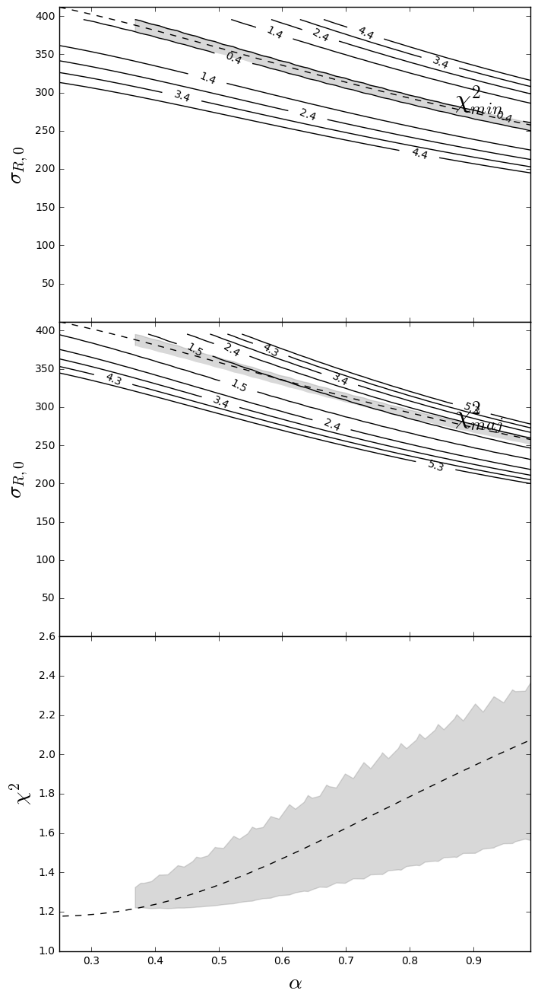

In [97]:
main_slice = lambda l: sig_min_0/sqrt(sin_i**2 + cos_i**2 * l**2)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

# os.chdir("C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\paper1\\text\\imgs")

alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
# levels = np.linspace(start=image_min.min(), stop=20., num=5)
# levels = [100., 125., 150., 175., 200.]
# levels = [image_min.min()+0.02, image_min.min()+0.4, image_min.min()+1.1, image_min.min()+2., 
#           image_min.min()+3.1, image_min.min()+4.1]
# levels = np.linspace(start=image_min.min()+0.1, stop=image_min.min()+4.1, num=5)
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
# im = ax.imshow(image_min, cmap='jet', vmin=image_min.min(), vmax=20., interpolation='spline16', 
#                    origin="lower", aspect="auto")
# plt.show()
cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()
v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
# ax.set_ylim(180, 300)
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')

ax = axes[1]
# levels = np.linspace(start=image_maj.min()-4.3, stop=10., num=10)
# levels = [7., 10., 50., 100.]
# levels = [image_maj.min()+0.2, image_maj.min()+0.7, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = np.linspace(start=image_maj.min()+0.3, stop=image_maj.min()+4.1, num=5)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')

ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
# ax.set_ylim(150, 320)

ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)


ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

# ax.set_ylim(3.1, 3.5)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)

plt.show()

N1_maj=49,	 N2_min=40,	 chi^2_corr[0][0]=67.1097147121 (was 41.74180031 and 87.8182162649)


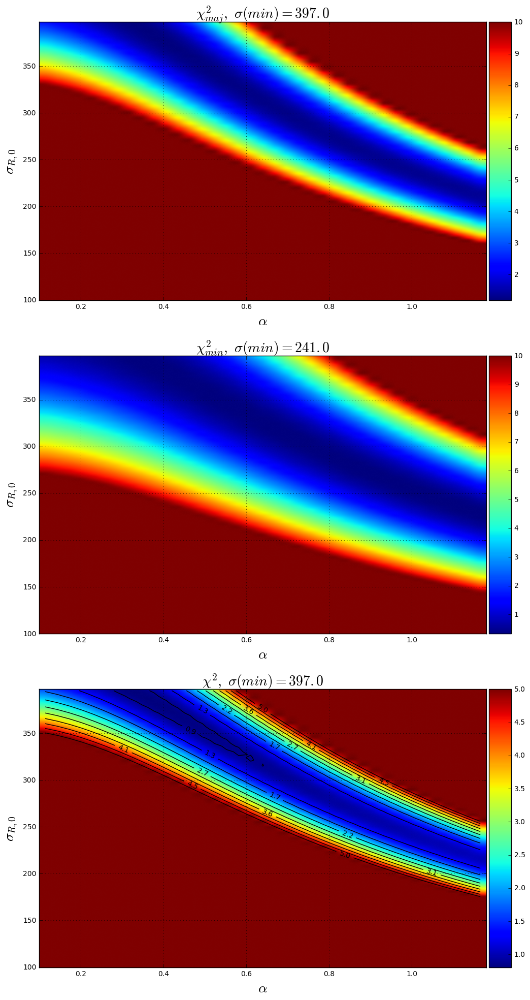

In [98]:
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[12,24])
plot_chi2_map(image_maj, axes[0], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=10.)
plot_chi2_map(image_min, axes[1], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=10.)
corr_image = (image_min*len(sig_min_p) + image_maj*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
print 'N1_maj={},\t N2_min={},\t chi^2_corr[0][0]={} (was {} and {})'.format(len(sig_maj_p), len(sig_min_p), corr_image[0][0], 
                                                                            image_min[0][0], image_maj[0][0])
plot_chi2_map(corr_image, axes[2], log_scale=False, title='$\chi^2$', is_contour=True, vmax=5.)
plt.show()

# 2. r_ef, sig_R_0 < spline(0)

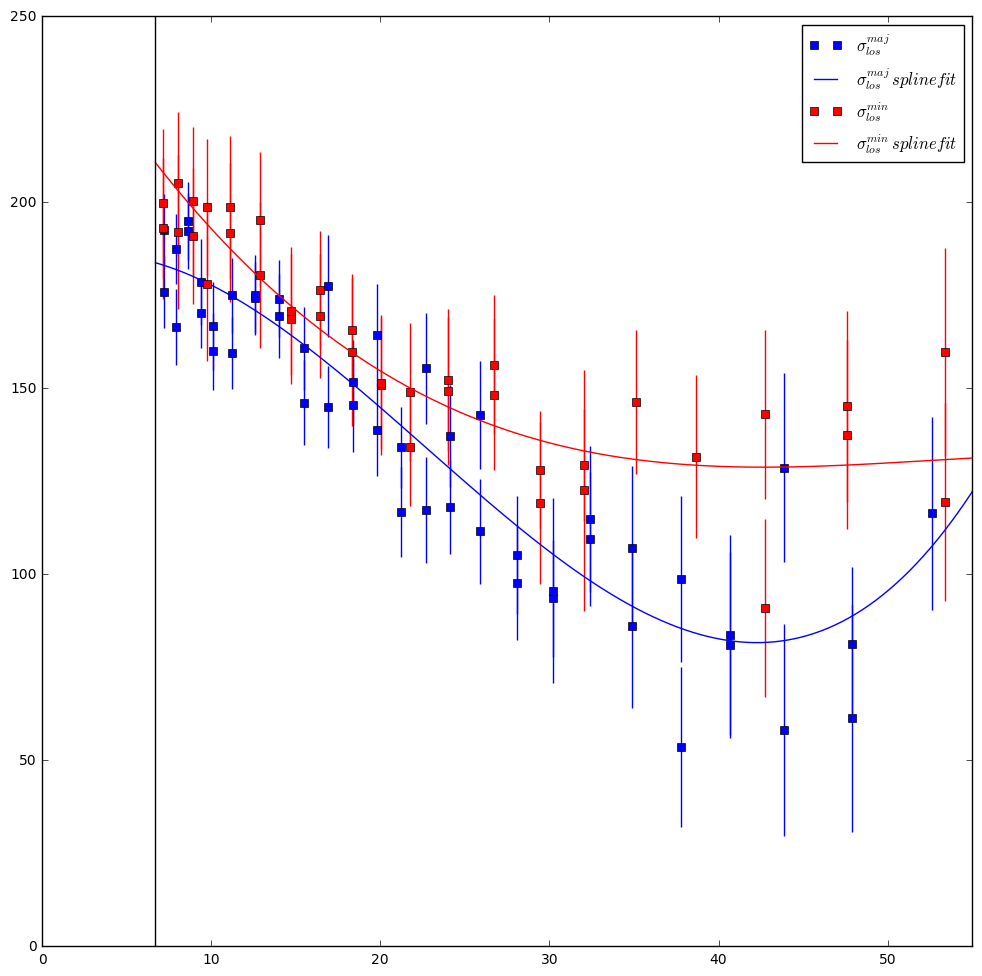

In [99]:
# Граница. по которой обрезаем
cutted = r_eb

sig_maj_data = zip(radii_maj1, sig_maj_p1, e_sig_maj_p1)
sig_maj_data = filter(lambda l: l[0] > cutted, sig_maj_data)
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data) 

sig_min_data = zip(radii_min1, sig_min_p1, e_sig_min_p1)
sig_min_data = filter(lambda l: l[0] > cutted, sig_min_data)
radii_min, sig_min_p, e_sig_min_p = zip(*sig_min_data) 

points = np.arange(cutted, max(radii_min), 0.1)

def w(arr):
    return map(lambda l: 1/(1. + l**2), arr)

spl_maj = inter.UnivariateSpline(radii_maj[::-1], sig_maj_p[::-1], k=3, s=10000., w=w(e_sig_maj_p))
spl_min = inter.UnivariateSpline(radii_min[::-1], sig_min_p[::-1], k=3, s=10000., w=w(e_sig_min_p))

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='.', marker='.', mew=0, color='blue')
plt.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
plt.plot(radii_min, sig_min_p, 's', label='$\sigma_{los}^{min}$', color='red')
plt.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='.', marker='.', mew=0, color='red')
plt.plot(points, spl_min(points), label = '$\sigma_{los}^{min}\, splinefit$', color='red')
plt.axvline(x=cutted, color='black')
plt.legend()
plt.ylim(0,250)
plt.xlim(0,55)
plt.show()

poly_sig_maj = spl_maj
poly_sig_min = spl_min

In [100]:
#Значение sig_los_min в 0
# sig_min_0 = poly_sig_min(0)
sig_min_0 = 205
print sig_min_0

205


И восстановим профили $\sigma_{los}^{maj}$ и $\sigma_{los}^{min}$. Связь профилей описывается следующими уравнениями: $$\sigma_{los,maj}^2=\sigma_{\varphi}^2\sin^2i+\sigma_Z^2\cos^2i$$ $$\sigma_{los,min}^2=\sigma_R^2\sin^2i+\sigma_Z^2\cos^2i$$

In [101]:
# def sig_maj_exp(R):
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

# def sig_min_exp(R):
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)


cos_i, sin_i = cos(incl * pi / 180), sin(incl * pi / 180)


def sig_maj_exp(R):
    tmp = sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2
    if tmp > 0:
        return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2)
    else:
        return -1000000
#     return sig_R_0*spl_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR(R)**2 * sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

def sig_min_exp(R):
    return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

Теперь то, с чего надо было начинать - построим картинки для разных значений $\alpha$ и $\sigma_{R,0}$. Для того, чтобы найти где минимум, попробуем построить просто двумерные карты $\chi^2$ для разных $\sigma_{R,0}$  $\alpha$: (это очень долго, так что пересчитывать в крайнем случае) 

In [102]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

def compute_chi2_maps(alphas=(), sigmas=()):
    '''Вычисляем все изображения, чтобы потом только настройки менять'''
    image_min = np.random.uniform(size=(len(sigmas), len(alphas)))
    image_maj = np.random.uniform(size=(len(sigmas), len(alphas)))
    image = np.random.uniform(size=(len(sigmas), len(alphas)))
    for i,si in enumerate(sigmas):
        for j,al in enumerate(alphas):
            global alpha, sig_R_0
            alpha = al
            sig_R_0 = si
            sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
            sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
            sqerr_sum = 0.5*sqerr_maj+0.5*sqerr_min
            image[i][j] = sqerr_sum
            image_maj[i][j] = sqerr_maj
            image_min[i][j] = sqerr_min
    return image, image_maj, image_min
    
image, image_maj, image_min = compute_chi2_maps(alphas=alphas, sigmas=sigmas)

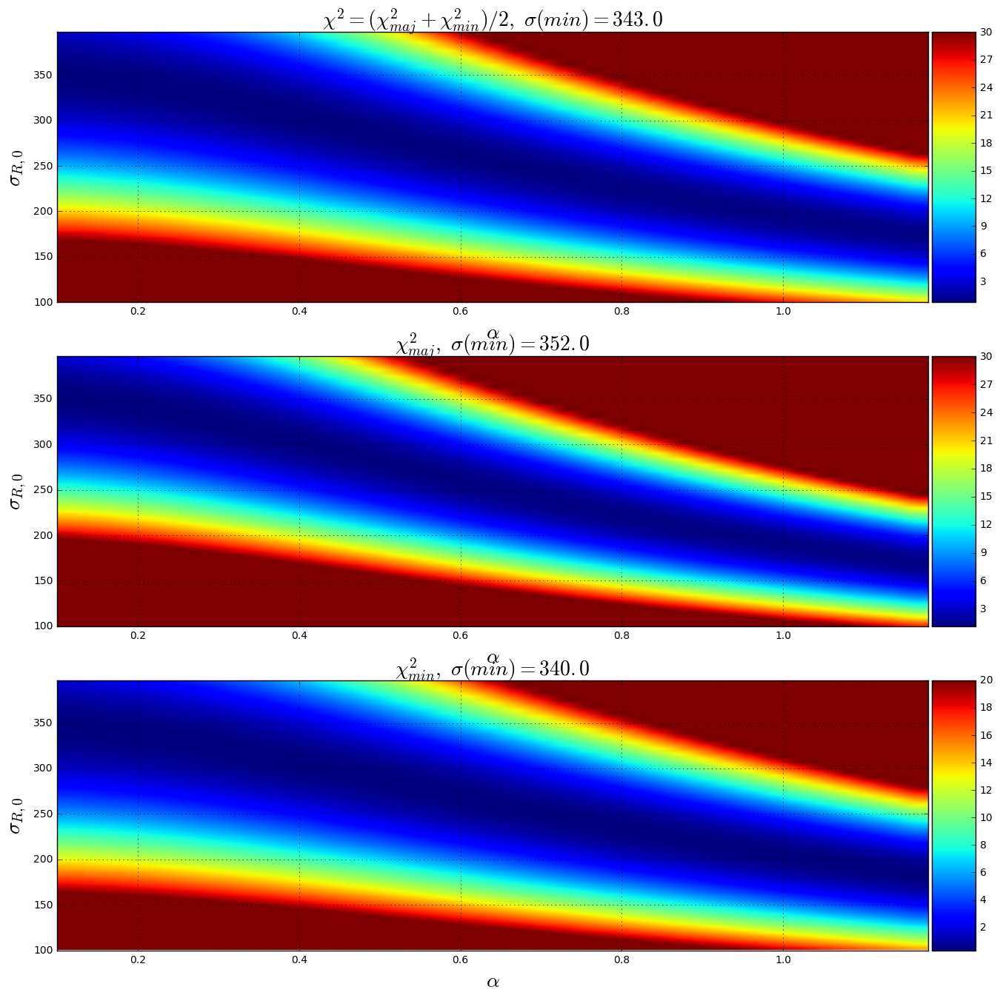

In [103]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_chi2_map(image, ax, log_scale=False, title='$\chi^2$', is_contour=False, vmax=0.):
    '''Рисуем получившиеся карты.
    Colormaps: http://wiki.scipy.org/Cookbook/Matplotlib/Show_colormaps'''
    if image is not None:
        if log_scale:
            image_log = np.apply_along_axis(np.log, 1, image)
            vmax = image_log.max()
        else:
            image_log = image
        if is_contour:
            norm = plt.cm.colors.Normalize(vmax=image.max(), vmin=-image.max())
            cmap = plt.cm.PRGn
            levels = np.concatenate([np.array([image_log.min()*1.1,]), np.linspace(start=image_log.min(), stop=vmax, num=10)])
            levels = sorted(levels)
            cset=ax.contour(image_log, levels, hold='on', colors = 'k', origin='lower', 
                            extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
            ax.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
        im = ax.imshow(image_log, cmap='jet', vmin=image_log.min(), vmax=vmax, interpolation='spline16', 
                   origin="lower", extent=[alphas[0], alphas[-1],sigmas[0],sigmas[-1]], aspect="auto")
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
        min_sigma = sigmas[int(np.where(image == image.min())[0])]        
        ax.set_title(title + '$,\ \sigma(min)=%s$' % min_sigma, size=20.)
        ax.set_ylabel('$\sigma_{R,0}$', size=20.)
        ax.set_xlabel(r'$\alpha$', size=20.)
        ax.grid(True)
 
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[16,16])
plot_chi2_map(image, axes[0], log_scale=False, title='$\chi^2 = (\chi^2_{maj} + \chi^2_{min})/2$', is_contour=False, vmax=30.)
plot_chi2_map(image_maj, axes[1], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=30.)
plot_chi2_map(image_min, axes[2], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=20.)
plt.show()

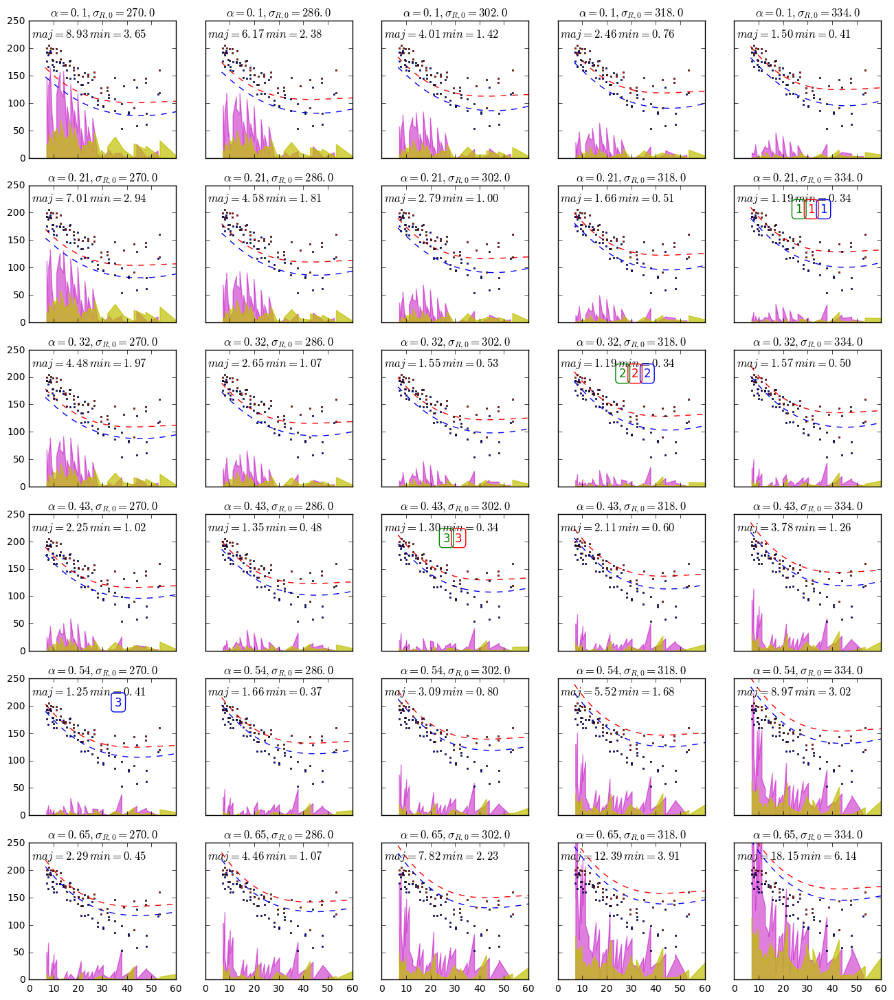

In [104]:
# Перебор alpha
alphas = np.arange(0.1, 0.7, 0.11)

# Перебор sig_R_0
sigmas = np.arange(270., 350., 16.)

# Те картинки, на которые стоит обратить особое внимание
good_pics = []

# def plot_ranges(sigmas_range, alphas_range, good_pics=[], calc_chi=False, best_err=3):
#     '''
#     Для всех предложенных вариантов sigR и alpha
#     рисует графики исходных и восстановленных дисперсий скоростей los.
#     Если calc_chi = True, то также считает ошибку по наблюдаемым точкам.
#     Если ошибка считается, то отмечаются best_err лучших (наименьших) результата.
#     Синий - для большой оси, красный - малой, зеленый - полусумма.
#     Изменяет глобальные значения sig_R_0 и alpha!'''
#     nrows = alphas.size
#     ncols = sigmas.size
#     fig, axes = plt.subplots(nrows=nrows, ncols=ncols, sharex=True, sharey=True, figsize=[16,12])
#     plt_index = 0
#     # Последнее - среднее геометрическое
#     sqerr_majs, sqerr_mins, sqerr_mean = [],[],[]
#     for al in alphas_range:
#         for si in sigmas_range:
#             global alpha, sig_R_0
#             alpha = al
#             sig_R_0 = si
#             ax = axes[plt_index/ncols, plt_index % ncols]
#             ax.set_title(r'$\alpha = %s, \sigma_{R,0}=%s$' % (al,si))
#             ax.plot(points, poly_sig_maj(points), '-', color='blue')
#             ax.plot(points, [sig_maj_exp(Rr) for Rr in points], '--', color='blue')
#             ax.plot(points, poly_sig_min(points), '-', color='red')
#             ax.plot(points, [sig_min_exp(R) for R in points], '--', color='red')
#             if calc_chi:
#                 sqerr_maj = sum(power([sig_maj_exp(p[0]) - p[1] for p in sig_maj_data], 2))/len(sig_maj_data)
#                 sqerr_min = sum(power([sig_min_exp(p[0]) - p[1] for p in sig_min_data], 2))/len(sig_min_data)
#                 ax.text(1, 5, "$\chi^2_{maj}=%5.0f\, \chi^2_{min}=%5.0f$" % (sqerr_maj, sqerr_min), fontsize=12)
#                 sqerr_majs.append(sqerr_maj);sqerr_mins.append(sqerr_min)
#                 sqerr_mean.append(0.5*sqerr_maj+0.5*sqerr_min)
#             ax.set_ylim(0, 250)
#             ax.set_xlim(0, 50)
#             if (plt_index/ncols, plt_index % ncols) in good_pics:
#                 ax.plot([40], [200], 'o', markersize=12., color=(0.2,1.0,0.))
#             plt_index = plt_index + 1
#     if calc_chi:
#         best_maj_err = heapq.nsmallest(best_err, sqerr_majs)
#         for b_maj in best_maj_err:
#             b_maj_ind = sqerr_majs.index(b_maj)
#             ax = axes[b_maj_ind/ncols, b_maj_ind % ncols]
#             #ax.plot([35], [200], 'o', markersize=12., color='b')
#             ax.text(35, 200, "%s" % (best_maj_err.index(b_maj)+1), fontsize=12, color='b', 
#                     bbox=dict(facecolor='none', edgecolor='b', boxstyle='round'))
#         best_min_err = heapq.nsmallest(best_err, sqerr_mins)
#         for b_min in best_min_err:
#             b_min_ind = sqerr_mins.index(b_min)
#             ax = axes[b_min_ind/ncols, b_min_ind % ncols]
#             #ax.plot([30], [200], 'o', markersize=12., color='r')
#             ax.text(30, 200, "%s" % (best_min_err.index(b_min)+1), fontsize=12, color='r', 
#                     bbox=dict(facecolor='none', edgecolor='r', boxstyle='round'))
#         best_mean_err = heapq.nsmallest(best_err, sqerr_mean)
#         for b_mean in best_mean_err:
#             b_mean_ind = sqerr_mean.index(b_mean)
#             ax = axes[b_mean_ind/ncols, b_mean_ind % ncols]
#             ax.text(25, 200, "%s" % (best_mean_err.index(b_mean)+1), fontsize=12, color='g', 
#                     bbox=dict(facecolor='none', edgecolor='g', boxstyle='round'))

plot_ranges(sigmas, alphas, good_pics=good_pics, calc_chi=True)
plt.show()

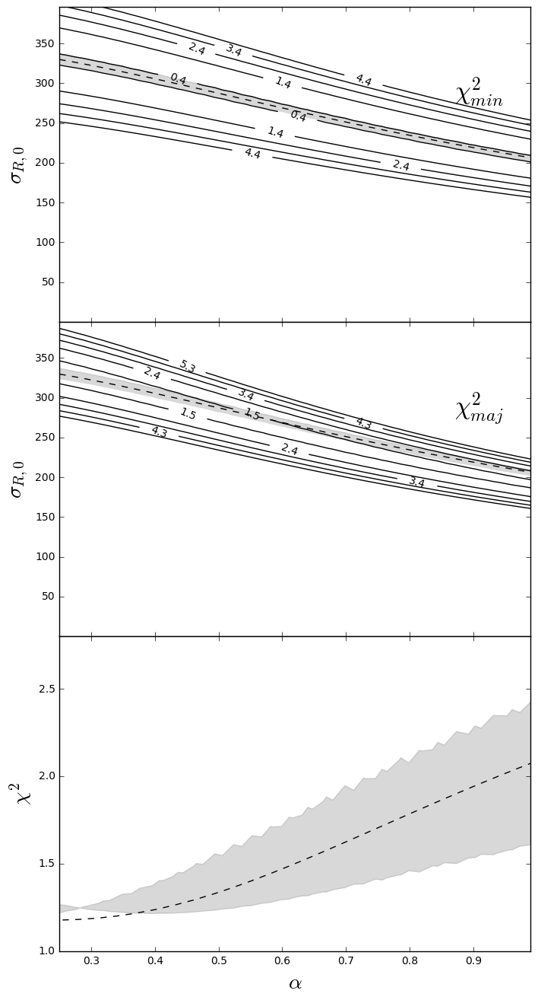

In [105]:
main_slice = lambda l: sig_min_0/sqrt(sin_i**2 + cos_i**2 * l**2)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

# os.chdir("C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\paper1\\text\\imgs")

alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
# levels = np.linspace(start=image_min.min(), stop=20., num=5)
# levels = [100., 125., 150., 175., 200.]
# levels = [image_min.min()+0.02, image_min.min()+0.4, image_min.min()+1.1, image_min.min()+2., 
#           image_min.min()+3.1, image_min.min()+4.1]
# levels = np.linspace(start=image_min.min()+0.1, stop=image_min.min()+4.1, num=5)
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
# im = ax.imshow(image_min, cmap='jet', vmin=image_min.min(), vmax=20., interpolation='spline16', 
#                    origin="lower", aspect="auto")
# plt.show()
cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()
v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
# ax.set_ylim(180, 300)
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')

ax = axes[1]
# levels = np.linspace(start=image_maj.min()-4.3, stop=10., num=10)
# levels = [7., 10., 50., 100.]
# levels = [image_maj.min()+0.2, image_maj.min()+0.7, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = np.linspace(start=image_maj.min()+0.3, stop=image_maj.min()+4.1, num=5)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')

ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
# ax.set_ylim(150, 320)

ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)

ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

# ax.set_ylim(3.1, 3.5)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)

plt.show()

N1_maj=49,	 N2_min=40,	 chi^2_corr[0][0]=57.6819329439 (was 35.7589672909 and 75.5782314361)


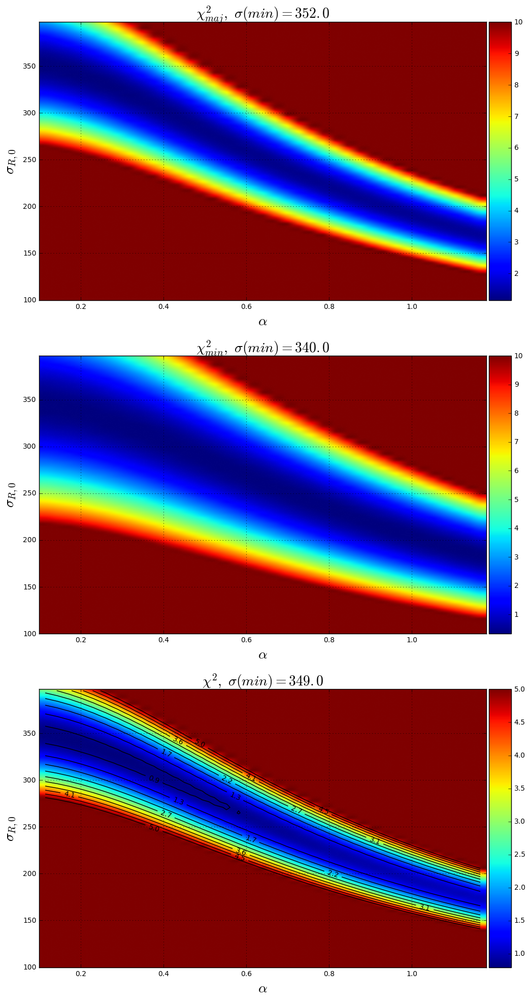

In [106]:
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[12,24])
plot_chi2_map(image_maj, axes[0], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=10.)
plot_chi2_map(image_min, axes[1], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=10.)
corr_image = (image_min*len(sig_min_p) + image_maj*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
print 'N1_maj={},\t N2_min={},\t chi^2_corr[0][0]={} (was {} and {})'.format(len(sig_maj_p), len(sig_min_p), corr_image[0][0], 
                                                                            image_min[0][0], image_maj[0][0])
plot_chi2_map(corr_image, axes[2], log_scale=False, title='$\chi^2$', is_contour=True, vmax=5.)
plt.show()

# 7. r_ef, sig_R_0=spline(r_ef)

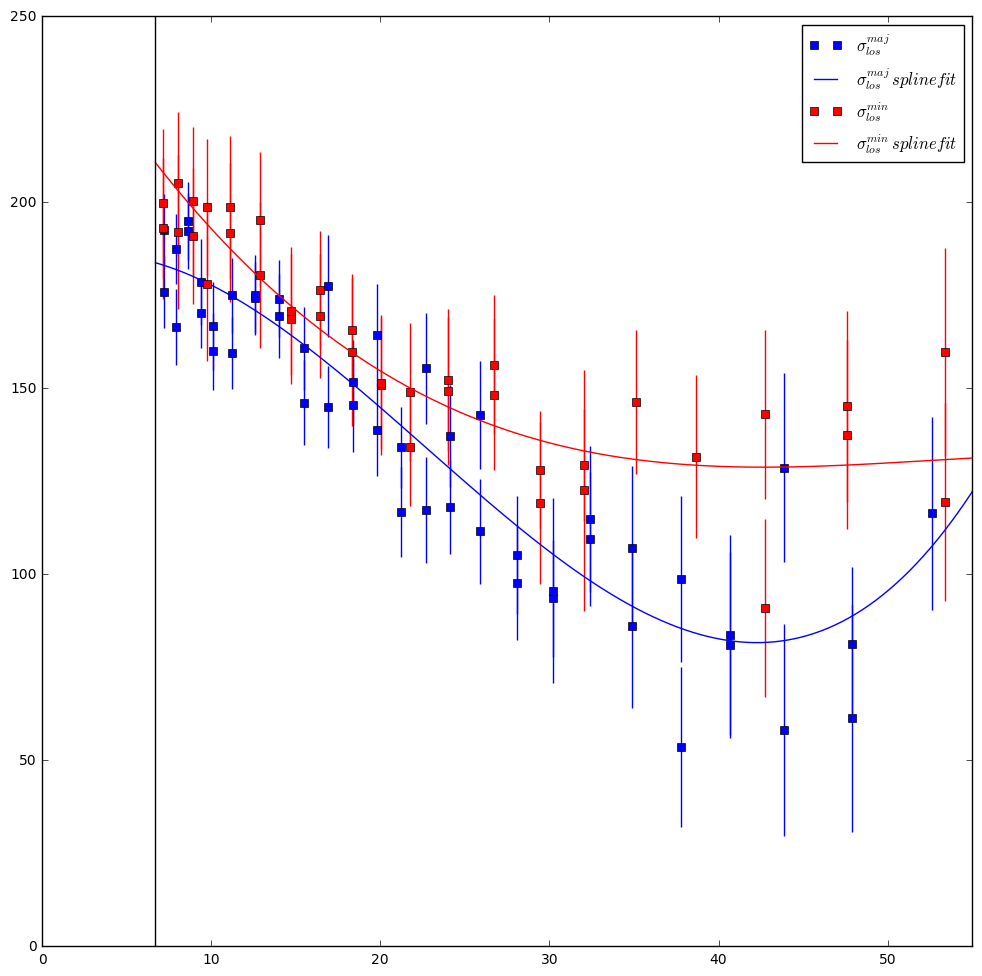

In [111]:
# Граница. по которой обрезаем
cutted = r_eb

os.chdir(tex_imgs_dir)

sig_maj_data = zip(radii_maj1, sig_maj_p1, e_sig_maj_p1)
np.save('n1167_maj', sig_maj_data)
sig_maj_data = filter(lambda l: l[0] > cutted, sig_maj_data)
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data)

sig_min_data = zip(radii_min1, sig_min_p1, e_sig_min_p1)
np.save('n1167_min', sig_min_data)
sig_min_data = filter(lambda l: l[0] > cutted, sig_min_data)
radii_min, sig_min_p, e_sig_min_p = zip(*sig_min_data)

os.chdir("C:\\science\\2FInstability\\data\\ngc1167")

points = np.arange(cutted, max(radii_min), 0.1)

def w(arr):
    return map(lambda l: 1/(1. + l**2), arr)

spl_maj = inter.UnivariateSpline(radii_maj[::-1], sig_maj_p[::-1], k=3, s=10000., w=w(e_sig_maj_p))
spl_min = inter.UnivariateSpline(radii_min[::-1], sig_min_p[::-1], k=3, s=10000., w=w(e_sig_min_p))

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='.', marker='.', mew=0, color='blue')
plt.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
plt.plot(radii_min, sig_min_p, 's', label='$\sigma_{los}^{min}$', color='red')
plt.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='.', marker='.', mew=0, color='red')
plt.plot(points, spl_min(points), label = '$\sigma_{los}^{min}\, splinefit$', color='red')
plt.axvline(x=cutted, color='black')
plt.legend()
plt.ylim(0,250)
plt.xlim(0,55)
plt.show()

poly_sig_maj = spl_maj
poly_sig_min = spl_min

In [47]:
os.chdir(tex_imgs_dir)

np.save('n1167_min_poly', zip(points, spl_min(points)))
np.save('n1167_maj_poly', zip(points, spl_maj(points)))

os.chdir("C:\\science\\2FInstability\\data\\ngc1167")

In [43]:
#Значение sig_los_min в 0
sig_min_0 = poly_sig_min(cutted)
print sig_min_0

210.677489398


И восстановим профили $\sigma_{los}^{maj}$ и $\sigma_{los}^{min}$. Связь профилей описывается следующими уравнениями: $$\sigma_{los,maj}^2=\sigma_{\varphi}^2\sin^2i+\sigma_Z^2\cos^2i$$ $$\sigma_{los,min}^2=\sigma_R^2\sin^2i+\sigma_Z^2\cos^2i$$

In [44]:
# def sig_maj_exp(R):
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

# def sig_min_exp(R):
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)


def sig_maj_exp(R):
    tmp = sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2
    if tmp > 0:
        return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2)
    else:
        return -1000000
#     return sig_R_0*spl_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR(R)**2 * sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

def sig_min_exp(R):
    if R >= cutted:
        return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sin_i**2 + alpha**2 * cos_i**2)
    else:
        return -1000000


Теперь то, с чего надо было начинать - построим картинки для разных значений $\alpha$ и $\sigma_{R,0}$. Для того, чтобы найти где минимум, попробуем построить просто двумерные карты $\chi^2$ для разных $\sigma_{R,0}$  $\alpha$: (это очень долго, так что пересчитывать в крайнем случае) 

In [45]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

def compute_chi2_maps(alphas=(), sigmas=()):
    '''Вычисляем все изображения, чтобы потом только настройки менять'''
    image_min = np.random.uniform(size=(len(sigmas), len(alphas)))
    image_maj = np.random.uniform(size=(len(sigmas), len(alphas)))
    image = np.random.uniform(size=(len(sigmas), len(alphas)))
    for i,si in enumerate(sigmas):
        for j,al in enumerate(alphas):
            global alpha, sig_R_0
            alpha = al
            sig_R_0 = si
            sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
            sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
            sqerr_sum = 0.5*sqerr_maj+0.5*sqerr_min
            image[i][j] = sqerr_sum
            image_maj[i][j] = sqerr_maj
            image_min[i][j] = sqerr_min
    return image, image_maj, image_min
    
image, image_maj, image_min = compute_chi2_maps(alphas=alphas, sigmas=sigmas)

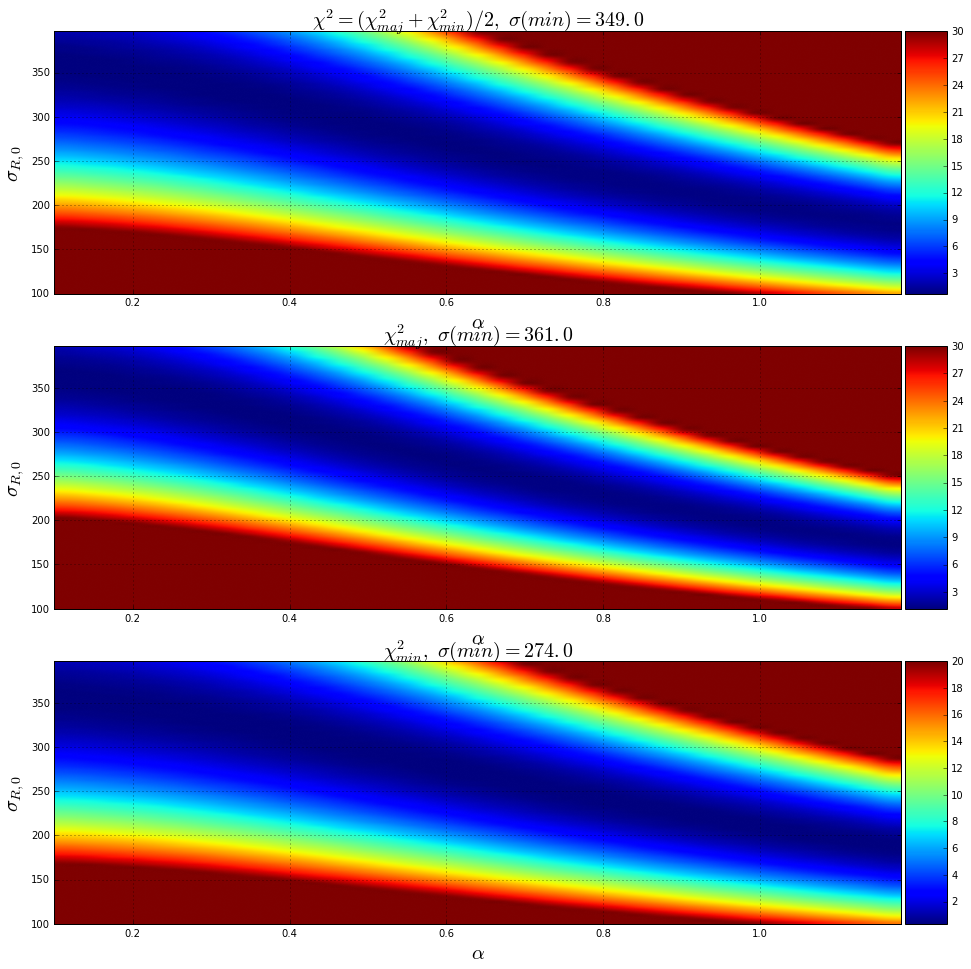

In [46]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_chi2_map(image, ax, log_scale=False, title='$\chi^2$', is_contour=False, vmax=0.):
    '''Рисуем получившиеся карты.
    Colormaps: http://wiki.scipy.org/Cookbook/Matplotlib/Show_colormaps'''
    if image is not None:
        if log_scale:
            image_log = np.apply_along_axis(np.log, 1, image)
            vmax = image_log.max()
        else:
            image_log = image
        if is_contour:
            norm = plt.cm.colors.Normalize(vmax=image.max(), vmin=-image.max())
            cmap = plt.cm.PRGn
            levels = np.concatenate([np.array([image_log.min()*1.1,]), np.linspace(start=image_log.min(), stop=vmax, num=10)])
            levels = sorted(levels)
            cset=ax.contour(image_log, levels, hold='on', colors = 'k', origin='lower', 
                            extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
            ax.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
        im = ax.imshow(image_log, cmap='jet', vmin=image_log.min(), vmax=vmax, interpolation='spline16', 
                   origin="lower", extent=[alphas[0], alphas[-1],sigmas[0],sigmas[-1]], aspect="auto")
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
        min_sigma = sigmas[int(np.where(image == image.min())[0])]        
        ax.set_title(title + '$,\ \sigma(min)=%s$' % min_sigma, size=20.)
        ax.set_ylabel('$\sigma_{R,0}$', size=20.)
        ax.set_xlabel(r'$\alpha$', size=20.)
        ax.grid(True)
 
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[16,16])
plot_chi2_map(image, axes[0], log_scale=False, title='$\chi^2 = (\chi^2_{maj} + \chi^2_{min})/2$', is_contour=False, vmax=30.)
plot_chi2_map(image_maj, axes[1], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=30.)
plot_chi2_map(image_min, axes[2], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=20.)
plt.show()

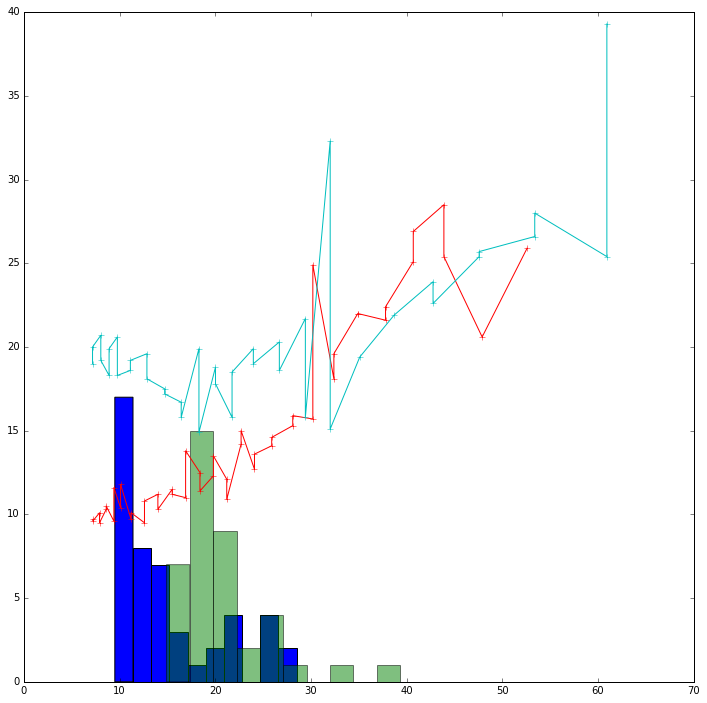

In [47]:
plt.hist(e_sig_maj_p)
plt.hist(e_sig_min_p, alpha=0.5)
plt.plot(radii_maj, e_sig_maj_p, '+-')
plt.plot(radii_min, e_sig_min_p, '+-')
plt.show()

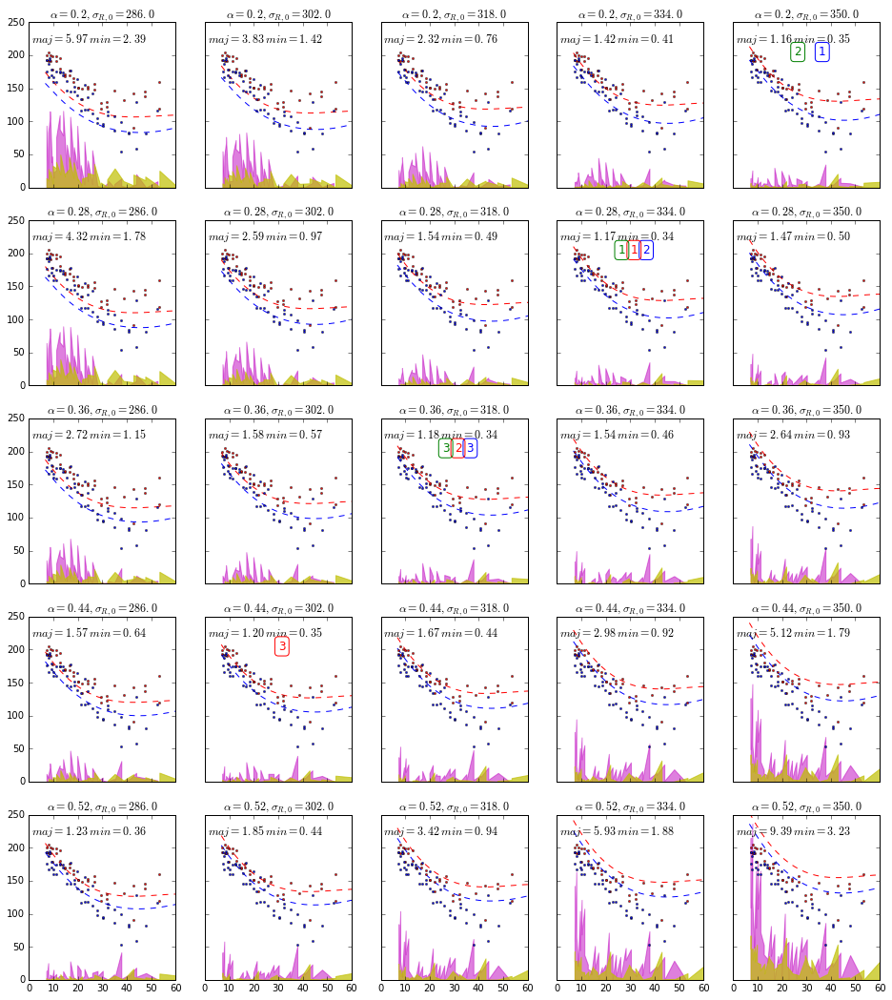

In [48]:
# Перебор alpha
alphas = np.arange(0.2, 0.6, 0.08)

# Перебор sig_R_0
sigmas = np.arange(286., 366., 16.)

# Те картинки, на которые стоит обратить особое внимание
good_pics = []

# def plot_ranges(sigmas_range, alphas_range, good_pics=[], calc_chi=False, best_err=3):
    
#     nrows = alphas.size
#     ncols = sigmas.size
#     fig, axes = plt.subplots(nrows=nrows, ncols=ncols, sharex=True, sharey=True, figsize=[16,18])
#     plt_index = 0
#     sqerr_majs, sqerr_mins, sqerr_mean = [],[],[]
#     for al in alphas_range:
#         for si in sigmas_range:
#             global alpha, sig_R_0
#             alpha = al
#             sig_R_0 = si
#             ax = axes[plt_index/ncols, plt_index % ncols]
#             ax.set_title(r'$\alpha = %s, \sigma_{R,0}=%s$' % (al,si))
# #             ax.plot(points, poly_sig_maj(points), '-', color='blue')
#             ax.plot(points, [sig_maj_exp(Rr) for Rr in points], '--', color='blue')
# #             ax.plot(points, poly_sig_min(points), '-', color='red')
#             ax.plot(points, [sig_min_exp(R) for R in points], '--', color='red')
#             if calc_chi:
#                 sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(p[0]) for p in sig_maj_data])
#                 sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(p[0]) for p in sig_min_data])
# #                 sqerr_maj = sum(power([sig_maj_exp(p[0]) - p[1] for p in sig_maj_data], 2))/len(sig_maj_data)
# #                 sqerr_min = sum(power([sig_min_exp(p[0]) - p[1] for p in sig_min_data], 2))/len(sig_min_data)
#                 ax.text(1, 220, "$maj=%5.2f\, min=%5.2f$" % (sqerr_maj, sqerr_min), fontsize=12)
#                 sqerr_majs.append(sqerr_maj);sqerr_mins.append(sqerr_min)
#                 sqerr_mean.append(0.5*sqerr_maj+0.5*sqerr_min)
#             ax.set_ylim(0, 250)
#             ax.set_xlim(0, 60)
            
#             ax.plot(radii_min, sig_min_p, 's', color='red', ms=1.7)
#             ax.plot(radii_maj, sig_maj_p, 's', color='blue', ms=1.7)
            
#             chima = [300*(p[1]-sig_maj_exp(p[0]))**2/p[2]**2/len(sig_maj_data) for p in sig_maj_data]
# #             ax.plot(radii_maj, chima, '.-', color='m')
#             ax.fill_between(radii_maj, chima, [0]*len(chima), color='m', alpha=0.5)
    
# #             print zip(chima, [(p[1]-sig_maj_exp(p[0]))**2 for p in sig_maj_data], sig_maj_p, 
# #                       [sig_maj_exp(p[0]) for p in sig_maj_data], e_sig_maj_p)
    
#             chimi = [300*(p[1]-sig_min_exp(p[0]))**2/p[2]**2/len(sig_min_data) for p in sig_min_data]
# #             ax.plot(radii_maj, chima, '.-', color='m')
#             ax.fill_between(radii_min, chimi, [0]*len(chimi), color='y', alpha=0.7)
            
#             if (plt_index/ncols, plt_index % ncols) in good_pics:
#                 ax.plot([40], [200], 'o', markersize=12., color=(0.2,1.0,0.))
#             plt_index = plt_index + 1
#     if calc_chi:
#         best_maj_err = heapq.nsmallest(best_err, sqerr_majs)
#         for b_maj in best_maj_err:
#             b_maj_ind = sqerr_majs.index(b_maj)
#             ax = axes[b_maj_ind/ncols, b_maj_ind % ncols]
#             #ax.plot([35], [200], 'o', markersize=12., color='b')
#             ax.text(35, 200, "%s" % (best_maj_err.index(b_maj)+1), fontsize=12, color='b', 
#                     bbox=dict(facecolor='none', edgecolor='b', boxstyle='round'))
#         best_min_err = heapq.nsmallest(best_err, sqerr_mins)
#         for b_min in best_min_err:
#             b_min_ind = sqerr_mins.index(b_min)
#             ax = axes[b_min_ind/ncols, b_min_ind % ncols]
#             #ax.plot([30], [200], 'o', markersize=12., color='r')
#             ax.text(30, 200, "%s" % (best_min_err.index(b_min)+1), fontsize=12, color='r', 
#                     bbox=dict(facecolor='none', edgecolor='r', boxstyle='round'))
#         best_mean_err = heapq.nsmallest(best_err, sqerr_mean)
#         for b_mean in best_mean_err:
#             b_mean_ind = sqerr_mean.index(b_mean)
#             ax = axes[b_mean_ind/ncols, b_mean_ind % ncols]
#             ax.text(25, 200, "%s" % (best_mean_err.index(b_mean)+1), fontsize=12, color='g', 
#                     bbox=dict(facecolor='none', edgecolor='g', boxstyle='round'))

plot_ranges(sigmas, alphas, good_pics=good_pics, calc_chi=True)
plt.show()

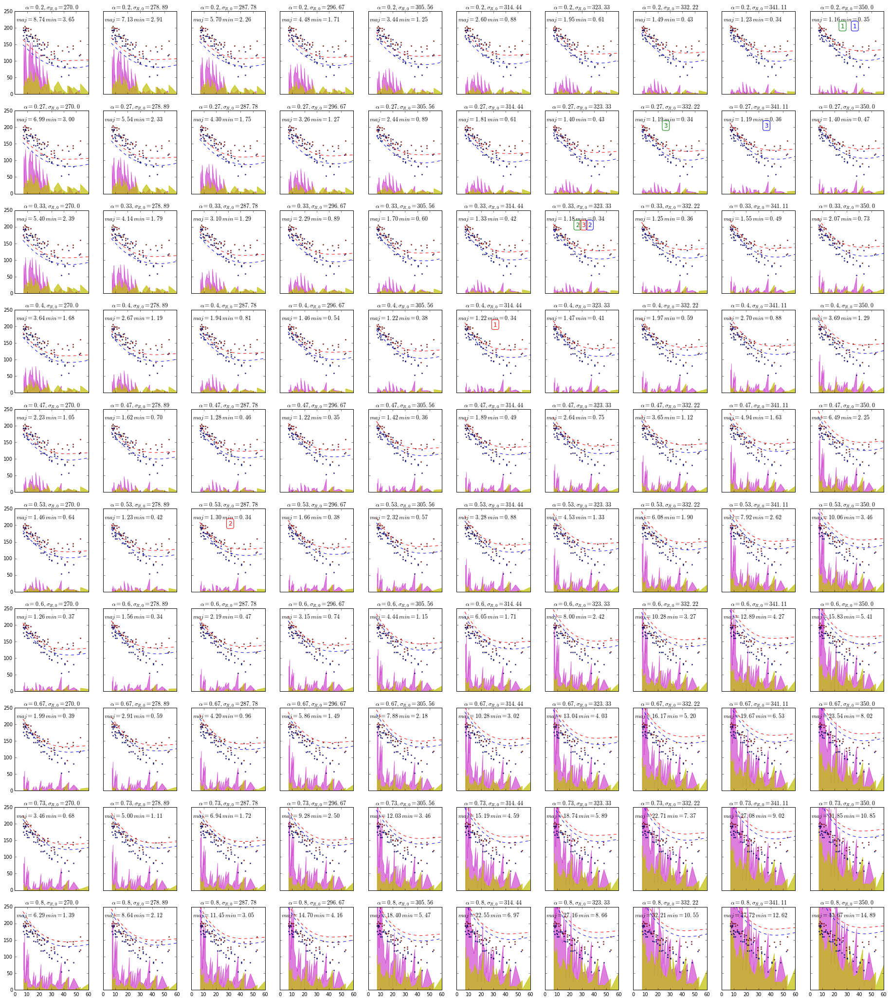

In [49]:
# Перебор alpha
# alphas = np.arange(0.2, 0.6, 0.08)
alphas = np.array(map(lambda l: np.round(l, 2), np.linspace(0.2, 0.8, 10)))

# Перебор sig_R_0
# sigmas = np.arange(286., 366., 16.)
sigmas = np.array(map(lambda l: np.round(l, 2), np.linspace(270., 350., 10)))

# Те картинки, на которые стоит обратить особое внимание
good_pics = []

plot_ranges(sigmas, alphas, good_pics=good_pics, calc_chi=True, figsize=[32, 36])
plt.show()

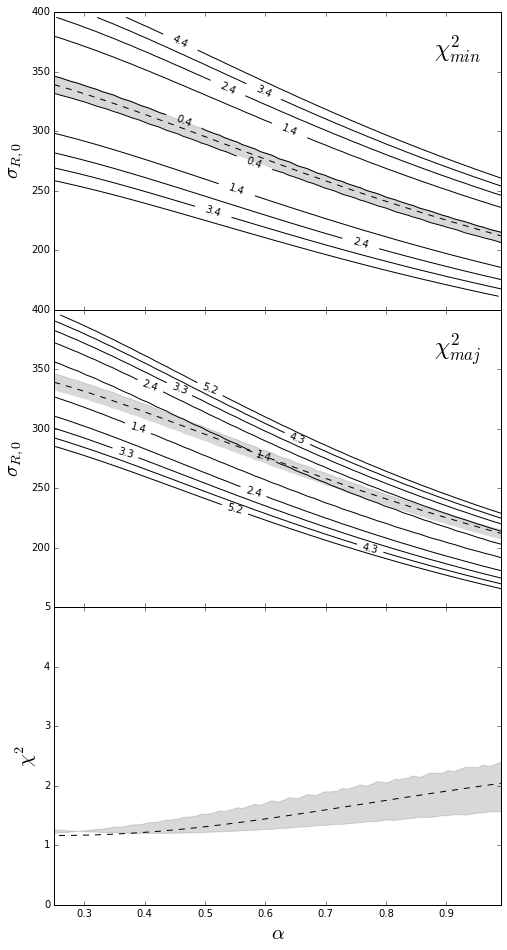

In [50]:
def main_slice(l):
    return sig_min_0/sqrt(sin_i**2 + cos_i**2 * l**2)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

os.chdir("C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\paper1\\text\\imgs")

alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
# levels = np.linspace(start=image_min.min(), stop=20., num=5)
# levels = [100., 125., 150., 175., 200.]
# levels = [image_min.min()+0.02, image_min.min()+0.4, image_min.min()+1.1, image_min.min()+2., 
#           image_min.min()+3.1, image_min.min()+4.1]
# levels = np.linspace(start=image_min.min()+0.1, stop=image_min.min()+4.1, num=5)
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
# im = ax.imshow(image_min, cmap='jet', vmin=image_min.min(), vmax=20., interpolation='spline16', 
#                    origin="lower", aspect="auto")
# plt.show()
cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()
v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
# ax.text(0.87, 280, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
ax.set_ylim(150, 400)
ax.set_xlim(0.25, 0.99)
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
xlim, ylim = ax.get_xlim(), ax.get_ylim()
ax.text(0.85*(xlim[1]-xlim[0])+xlim[0], 0.85*(ylim[1]-ylim[0]) + ylim[0], '$\chi^2_{min}$', size = 24.)


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')

ax = axes[1]
# levels = np.linspace(start=image_maj.min()-4.3, stop=10., num=10)
# levels = [7., 10., 50., 100.]
# levels = [image_maj.min()+0.2, image_maj.min()+0.7, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = np.linspace(start=image_maj.min()+0.3, stop=image_maj.min()+4.1, num=5)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
# ax.text(0.87, 280, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
ax.set_ylim(150, 400)
xlim, ylim = ax.get_xlim(), ax.get_ylim()
ax.text(0.85*(xlim[1]-xlim[0])+xlim[0], 0.85*(ylim[1]-ylim[0]) + ylim[0], '$\chi^2_{maj}$', size = 24.)


ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)


ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

ax.set_ylim(0.0, 5.)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)

plt.savefig('ngc1167_maps.eps', format='eps')
plt.savefig('ngc1167_maps.png', format='png')
plt.savefig('ngc1167_maps.pdf', format='pdf', dpi=150)

plt.show()

os.chdir("C:\\science\\2FInstability\\data\\ngc1167")

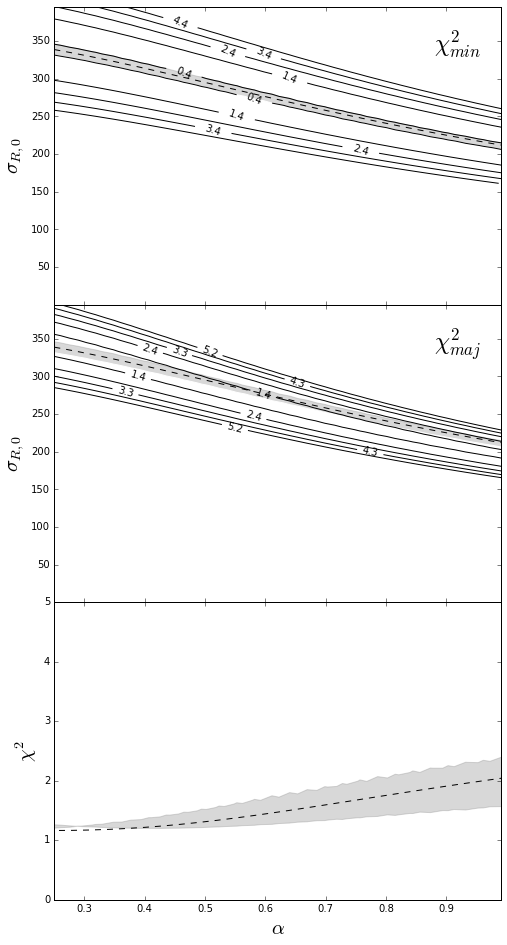

In [51]:
def main_slice(l):
    return sig_min_0/sqrt(sin_i**2 + cos_i**2 * l**2)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

os.chdir("C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\paper1\\text\\imgs")

alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
# levels = np.linspace(start=image_min.min(), stop=20., num=5)
# levels = [100., 125., 150., 175., 200.]
# levels = [image_min.min()+0.02, image_min.min()+0.4, image_min.min()+1.1, image_min.min()+2., 
#           image_min.min()+3.1, image_min.min()+4.1]
# levels = np.linspace(start=image_min.min()+0.1, stop=image_min.min()+4.1, num=5)
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
# im = ax.imshow(image_min, cmap='jet', vmin=image_min.min(), vmax=20., interpolation='spline16', 
#                    origin="lower", aspect="auto")
# plt.show()
cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()
v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
# ax.text(0.87, 280, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
# ax.set_ylim(0, 400)
ax.set_xlim(0.25, 0.99)
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
xlim, ylim = ax.get_xlim(), ax.get_ylim()
ax.text(0.85*(xlim[1]-xlim[0])+xlim[0], 0.85*(ylim[1]-ylim[0]) + ylim[0], '$\chi^2_{min}$', size = 24.)


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')

ax = axes[1]
# levels = np.linspace(start=image_maj.min()-4.3, stop=10., num=10)
# levels = [7., 10., 50., 100.]
# levels = [image_maj.min()+0.2, image_maj.min()+0.7, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = np.linspace(start=image_maj.min()+0.3, stop=image_maj.min()+4.1, num=5)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
# ax.text(0.87, 280, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
# ax.set_ylim(0, 400)
xlim, ylim = ax.get_xlim(), ax.get_ylim()
ax.text(0.85*(xlim[1]-xlim[0])+xlim[0], 0.85*(ylim[1]-ylim[0]) + ylim[0], '$\chi^2_{maj}$', size = 24.)


ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)


ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

ax.set_ylim(0.0, 5.)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)


plt.show()


N1_maj=48,	 N2_min=40,	 chi^2_corr[0][0]=59.5740201463 (was 36.5429632165 and 78.7665675878)


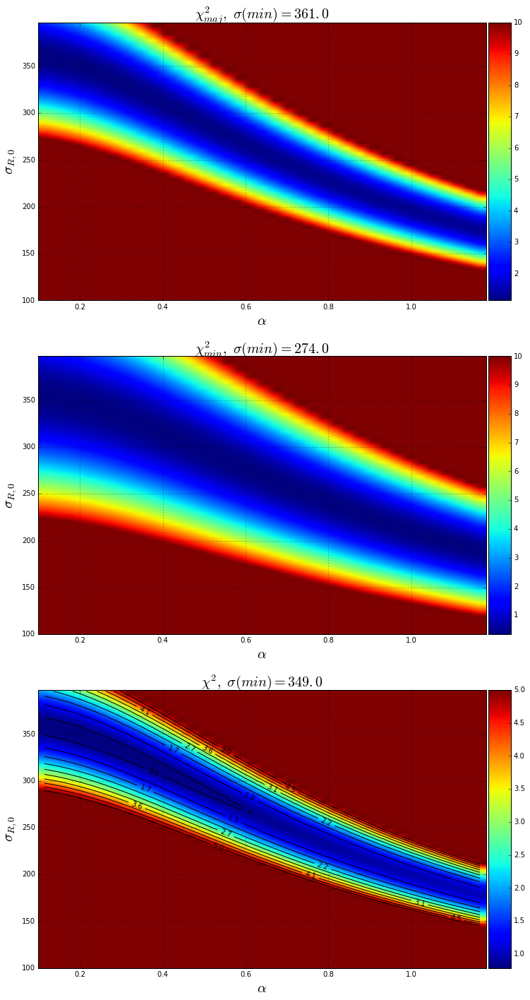

In [52]:
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[12,24])
plot_chi2_map(image_maj, axes[0], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=10.)
plot_chi2_map(image_min, axes[1], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=10.)
corr_image = (image_min*len(sig_min_p) + image_maj*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
print 'N1_maj={},\t N2_min={},\t chi^2_corr[0][0]={} (was {} and {})'.format(len(sig_maj_p), len(sig_min_p), corr_image[0][0], 
                                                                            image_min[0][0], image_maj[0][0])
plot_chi2_map(corr_image, axes[2], log_scale=False, title='$\chi^2$', is_contour=True, vmax=5.)
plt.show()

In [53]:
import scipy.optimize as opt

def chisqfunc((x_sig, x_alpha)):
    global sig_R_0, alpha
    sig_R_0 = x_sig
    alpha = x_alpha
    sqerr_ma = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    sqerr_mi = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
    chisq = (sqerr_mi*len(sig_min_p) + sqerr_ma*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
    return chisq

x0 = np.array([100., 0.5])

res = opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B')
print res

      fun: 0.7846122234183418
 hess_inv: <2x2 LbfgsInvHessProduct with dtype=float64>
      jac: array([ -5.55111512e-08,  -3.10862447e-06])
  message: 'CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL'
     nfev: 96
      nit: 23
   status: 0
  success: True
        x: array([  3.53429186e+02,   1.57233511e-01])


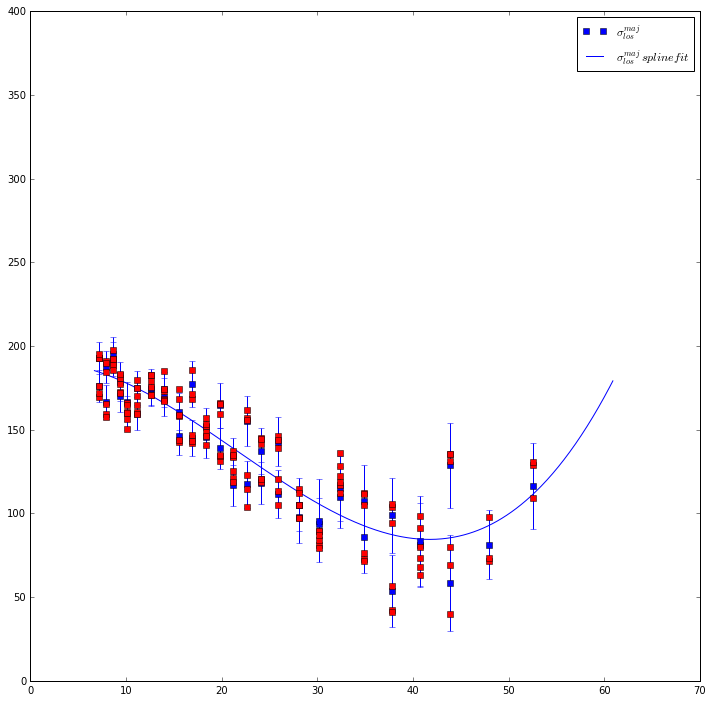

In [54]:
def gen_next_normal(radii, sig, esig):
    randomDelta =  np.array([np.random.normal(0., derr/2, 1)[0] for derr in esig] ) 
    randomdataY = sig + randomDelta
    return zip(radii, randomdataY)

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='o', marker='.', color='blue')
plt.plot(points, poly_sig_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
 
for i in range(3):
    r, s = zip(*gen_next_normal(radii_maj, sig_maj_p, e_sig_maj_p))
    plt.plot(r, s, 's', color='red')

plt.ylim(0., 400.)
plt.legend()
plt.show()

In [55]:
os.chdir("C:\\science\\2FInstability\\data\\ngc1167")
pics_path = '.cutted\\pics\\'
import time

alphas = np.arange(0.2, 0.6, 0.03)
sigmas = np.arange(100.0, 400, 3.)

N = 20000

result = []

start_time = time.time()


if not os.path.exists(pics_path):
    os.makedirs(pics_path)
if os.path.isfile(pics_path + 'monte_carlo_nm.npy'):
    result = np.load(pics_path + "monte_carlo_nm.npy")
else:
    for i in log_progress(range(N)):
        global poly_sig_maj, poly_sig_min
    #     r, s = zip(*gen_next_normal(radii_maj, sig_maj_p, e_sig_maj_p))
#         poly_sig_maj = inter.UnivariateSpline(r, s, k=3, s=10000.)
    #     poly_sig_maj = poly1d(polyfit(r, s,  deg=9))

        r, s = zip(*gen_next_normal(radii_min, sig_min_p, e_sig_min_p))
        poly_sig_min = inter.UnivariateSpline(r, s, k=3, s=10000., w=w(e_sig_min_p))
    #     poly_sig_min = poly1d(polyfit(r, s,  deg=9))

        result.append((opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B').x,
                      poly_sig_maj.get_coeffs(), poly_sig_min.get_coeffs()))
#         result.append((opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (0., alphas[-1])], method='L-BFGS-B').x,
#                       poly_sig_maj.get_coeffs(), poly_sig_min.get_coeffs()))
    #     result.append((opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B').x,
    #                   poly_sig_maj.coeffs, poly_sig_min.coeffs))
    np.save(pics_path + 'monte_carlo_nm', np.array(result))

print("--- %s seconds ---" % (time.time() - start_time))

--- 4.66600012779 seconds ---


In [56]:
len(result)

200000

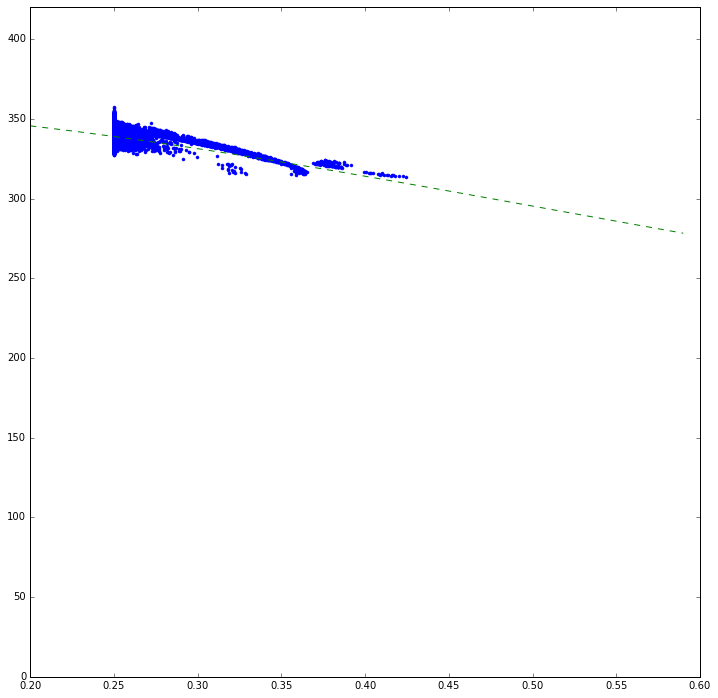

In [57]:
s, _, _ = zip(*result)
s,a = zip(*s)
plt.plot(a, s, '.')
plt.plot(alphas, map(main_slice, alphas), '--')
# plt.xlim(0.0, 0.99)
plt.ylim(0, 420)
plt.show()

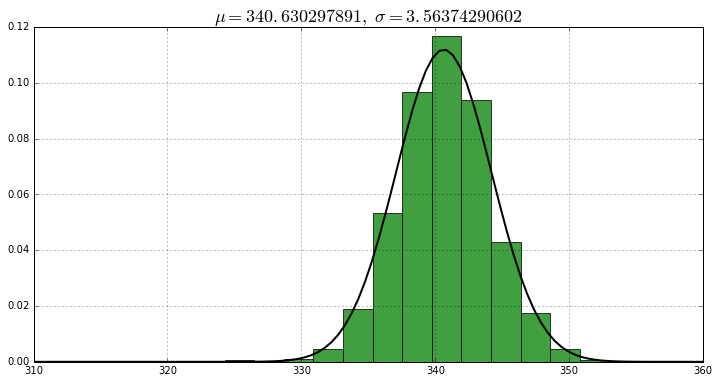

In [58]:
from scipy.stats import norm

fig = plt.figure(figsize=(12,6))
ax = fig.add_subplot(111)

n, bins, patches = ax.hist(s, 20, normed=1, facecolor='green', alpha=0.75)
mu, std = norm.fit(s)

xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)
plt.plot(x, p, 'k', linewidth=2)

ax.set_title('$\mu=%s,\ \sigma=%s$' % (mu, std), fontsize=18)
ax.grid(True)

plt.show()

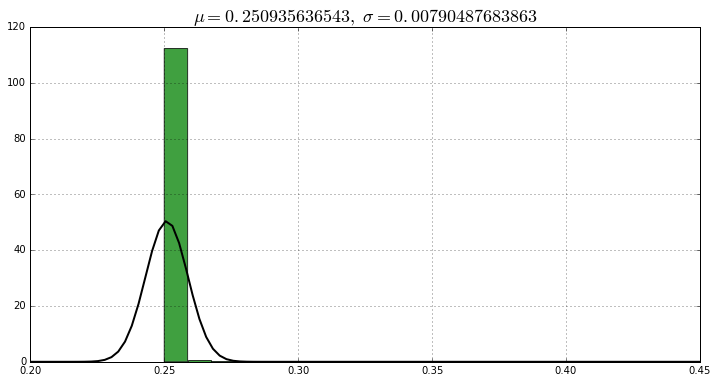

In [59]:
from scipy.stats import norm

fig = plt.figure(figsize=(12,6))
ax = fig.add_subplot(111)

n, bins, patches = ax.hist(a, 20, normed=1, facecolor='green', alpha=0.75)
mu, std = norm.fit(a)

xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)
plt.plot(x, p, 'k', linewidth=2)

ax.set_title('$\mu=%s,\ \sigma=%s$' % (mu, std), fontsize=18)
ax.grid(True)

plt.show()

# 7. r_ef < r < 42, sig_R_0=spline(r_ef)

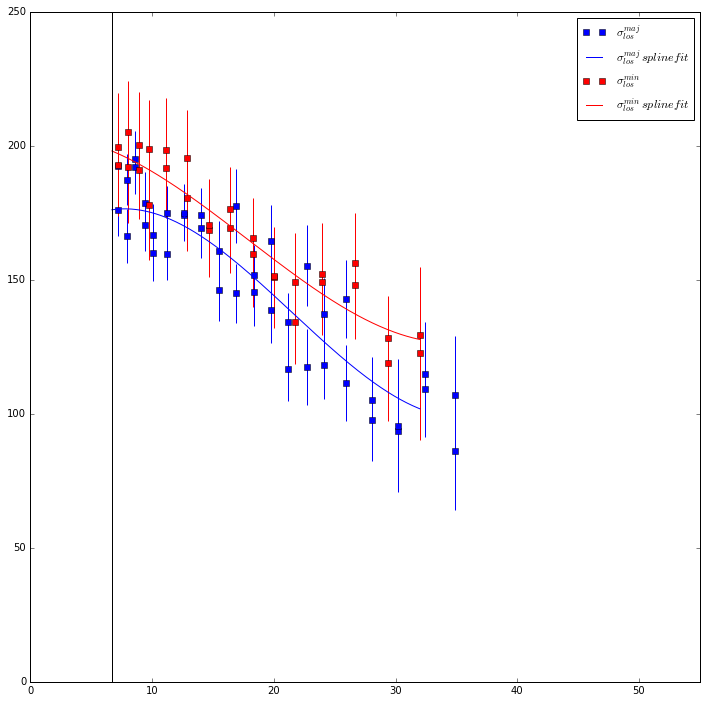

In [60]:
# Граница. по которой обрезаем
cutted = r_eb

sig_maj_data = zip(radii_maj1, sig_maj_p1, e_sig_maj_p1)
sig_maj_data = filter(lambda l: l[0] > cutted and l[0] < 35, sig_maj_data)
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data) 

sig_min_data = zip(radii_min1, sig_min_p1, e_sig_min_p1)
sig_min_data = filter(lambda l: l[0] > cutted and l[0] < 35, sig_min_data)
radii_min, sig_min_p, e_sig_min_p = zip(*sig_min_data) 

points = np.arange(cutted, max(radii_min), 0.1)

points = np.arange(cutted, max(radii_min), 0.1)

def w(arr):
    return map(lambda l: 1/(1. + l**2), arr)

spl_maj = inter.UnivariateSpline(radii_maj[::-1], sig_maj_p[::-1], k=3, s=10000., w=w(e_sig_maj_p))
spl_min = inter.UnivariateSpline(radii_min[::-1], sig_min_p[::-1], k=3, s=10000., w=w(e_sig_min_p))

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='.', marker='.', mew=0, color='blue')
plt.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
plt.plot(radii_min, sig_min_p, 's', label='$\sigma_{los}^{min}$', color='red')
plt.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='.', marker='.', mew=0, color='red')
plt.plot(points, spl_min(points), label = '$\sigma_{los}^{min}\, splinefit$', color='red')
plt.axvline(x=cutted, color='black')
plt.legend()
plt.ylim(0,250)
plt.xlim(0,55)
plt.show()

poly_sig_maj = spl_maj
poly_sig_min = spl_min

In [61]:
#Значение sig_los_min в 0
sig_min_0 = poly_sig_min(cutted)
print sig_min_0

198.185691317


И восстановим профили $\sigma_{los}^{maj}$ и $\sigma_{los}^{min}$. Связь профилей описывается следующими уравнениями: $$\sigma_{los,maj}^2=\sigma_{\varphi}^2\sin^2i+\sigma_Z^2\cos^2i$$ $$\sigma_{los,min}^2=\sigma_R^2\sin^2i+\sigma_Z^2\cos^2i$$

In [62]:
# def sig_maj_exp(R):
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

# def sig_min_exp(R):
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)


def sig_maj_exp(R):
    tmp = sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2
    if tmp > 0:
        return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2)
    else:
        return -1000000
#     return sig_R_0*spl_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR(R)**2 * sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

def sig_min_exp(R):
    if R >= cutted:
        return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sin_i**2 + alpha**2 * cos_i**2)
    else:
        return -1000000


Теперь то, с чего надо было начинать - построим картинки для разных значений $\alpha$ и $\sigma_{R,0}$. Для того, чтобы найти где минимум, попробуем построить просто двумерные карты $\chi^2$ для разных $\sigma_{R,0}$  $\alpha$: (это очень долго, так что пересчитывать в крайнем случае) 

In [63]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

def compute_chi2_maps(alphas=(), sigmas=()):
    '''Вычисляем все изображения, чтобы потом только настройки менять'''
    image_min = np.random.uniform(size=(len(sigmas), len(alphas)))
    image_maj = np.random.uniform(size=(len(sigmas), len(alphas)))
    image = np.random.uniform(size=(len(sigmas), len(alphas)))
    for i,si in enumerate(sigmas):
        for j,al in enumerate(alphas):
            global alpha, sig_R_0
            alpha = al
            sig_R_0 = si
            sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
            sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
            sqerr_sum = 0.5*sqerr_maj+0.5*sqerr_min
            image[i][j] = sqerr_sum
            image_maj[i][j] = sqerr_maj
            image_min[i][j] = sqerr_min
    return image, image_maj, image_min
    
image, image_maj, image_min = compute_chi2_maps(alphas=alphas, sigmas=sigmas)

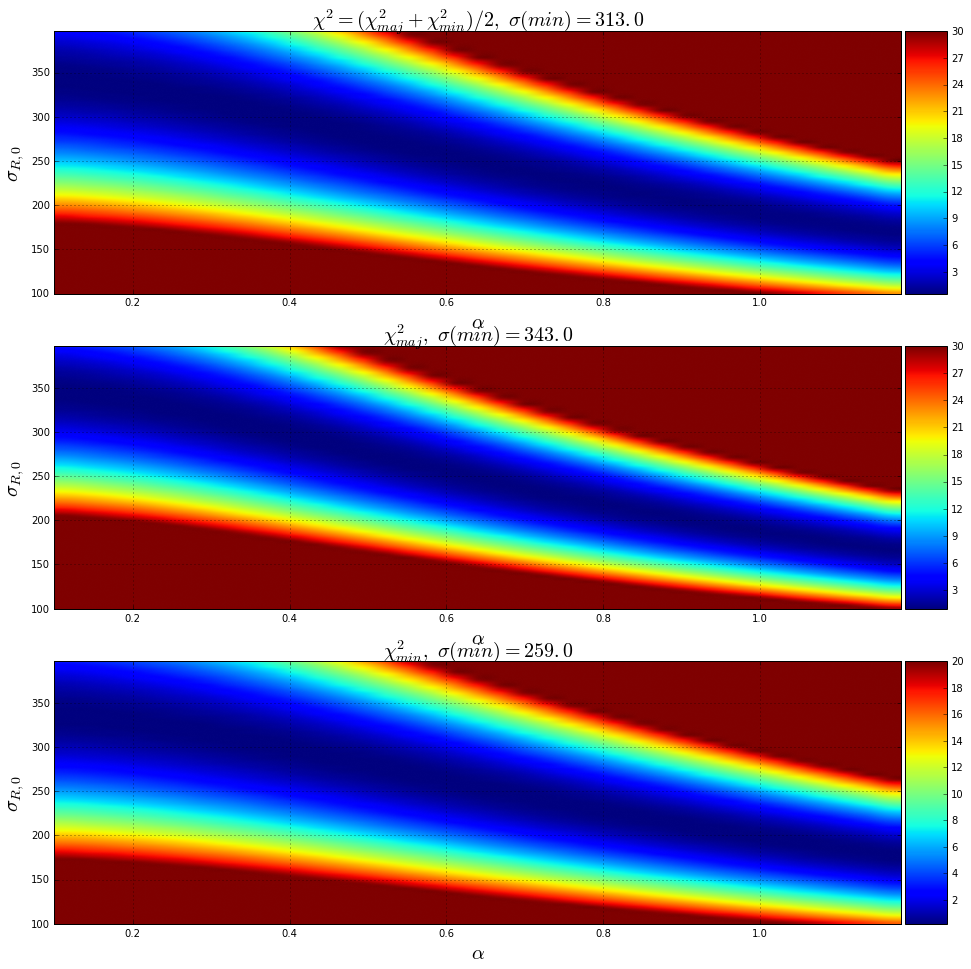

In [64]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_chi2_map(image, ax, log_scale=False, title='$\chi^2$', is_contour=False, vmax=0.):
    '''Рисуем получившиеся карты.
    Colormaps: http://wiki.scipy.org/Cookbook/Matplotlib/Show_colormaps'''
    if image is not None:
        if log_scale:
            image_log = np.apply_along_axis(np.log, 1, image)
            vmax = image_log.max()
        else:
            image_log = image
        if is_contour:
            norm = plt.cm.colors.Normalize(vmax=image.max(), vmin=-image.max())
            cmap = plt.cm.PRGn
            levels = np.concatenate([np.array([image_log.min()*1.1,]), np.linspace(start=image_log.min(), stop=vmax, num=10)])
            levels = sorted(levels)
            cset=ax.contour(image_log, levels, hold='on', colors = 'k', origin='lower', 
                            extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
            ax.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
        im = ax.imshow(image_log, cmap='jet', vmin=image_log.min(), vmax=vmax, interpolation='spline16', 
                   origin="lower", extent=[alphas[0], alphas[-1],sigmas[0],sigmas[-1]], aspect="auto")
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
        min_sigma = sigmas[int(np.where(image == image.min())[0])]        
        ax.set_title(title + '$,\ \sigma(min)=%s$' % min_sigma, size=20.)
        ax.set_ylabel('$\sigma_{R,0}$', size=20.)
        ax.set_xlabel(r'$\alpha$', size=20.)
        ax.grid(True)
 
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[16,16])
plot_chi2_map(image, axes[0], log_scale=False, title='$\chi^2 = (\chi^2_{maj} + \chi^2_{min})/2$', is_contour=False, vmax=30.)
plot_chi2_map(image_maj, axes[1], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=30.)
plot_chi2_map(image_min, axes[2], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=20.)
plt.show()

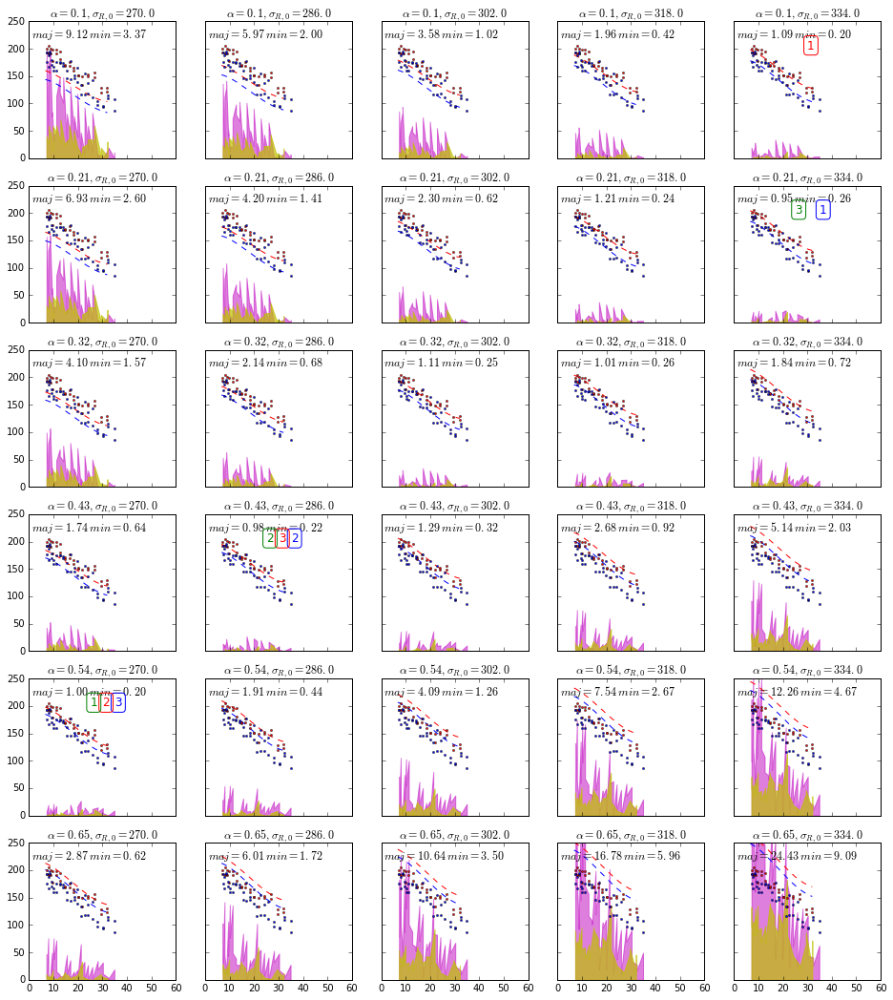

In [65]:
# Перебор alpha
alphas = np.arange(0.1, 0.7, 0.11)

# Перебор sig_R_0
sigmas = np.arange(270., 350., 16.)

# Те картинки, на которые стоит обратить особое внимание
good_pics = []

# def plot_ranges(sigmas_range, alphas_range, good_pics=[], calc_chi=False, best_err=3):
    
#     nrows = alphas.size
#     ncols = sigmas.size
#     fig, axes = plt.subplots(nrows=nrows, ncols=ncols, sharex=True, sharey=True, figsize=[16,18])
#     plt_index = 0
#     sqerr_majs, sqerr_mins, sqerr_mean = [],[],[]
#     for al in alphas_range:
#         for si in sigmas_range:
#             global alpha, sig_R_0
#             alpha = al
#             sig_R_0 = si
#             ax = axes[plt_index/ncols, plt_index % ncols]
#             ax.set_title(r'$\alpha = %s, \sigma_{R,0}=%s$' % (al,si))
# #             ax.plot(points, poly_sig_maj(points), '-', color='blue')
#             ax.plot(points, [sig_maj_exp(Rr) for Rr in points], '--', color='blue')
# #             ax.plot(points, poly_sig_min(points), '-', color='red')
#             ax.plot(points, [sig_min_exp(R) for R in points], '--', color='red')
#             if calc_chi:
#                 sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(p[0]) for p in sig_maj_data])
#                 sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(p[0]) for p in sig_min_data])
# #                 sqerr_maj = sum(power([sig_maj_exp(p[0]) - p[1] for p in sig_maj_data], 2))/len(sig_maj_data)
# #                 sqerr_min = sum(power([sig_min_exp(p[0]) - p[1] for p in sig_min_data], 2))/len(sig_min_data)
#                 ax.text(1, 220, "$maj=%5.2f\, min=%5.2f$" % (sqerr_maj, sqerr_min), fontsize=12)
#                 sqerr_majs.append(sqerr_maj);sqerr_mins.append(sqerr_min)
#                 sqerr_mean.append(0.5*sqerr_maj+0.5*sqerr_min)
#             ax.set_ylim(0, 250)
#             ax.set_xlim(0, 60)
            
#             ax.plot(radii_min, sig_min_p, 's', color='red', ms=1.7)
#             ax.plot(radii_maj, sig_maj_p, 's', color='blue', ms=1.7)
            
#             chima = [300*(p[1]-sig_maj_exp(p[0]))**2/p[2]**2/len(sig_maj_data) for p in sig_maj_data]
# #             ax.plot(radii_maj, chima, '.-', color='m')
#             ax.fill_between(radii_maj, chima, [0]*len(chima), color='m', alpha=0.5)
    
# #             print zip(chima, [(p[1]-sig_maj_exp(p[0]))**2 for p in sig_maj_data], sig_maj_p, 
# #                       [sig_maj_exp(p[0]) for p in sig_maj_data], e_sig_maj_p)
    
#             chimi = [300*(p[1]-sig_min_exp(p[0]))**2/p[2]**2/len(sig_min_data) for p in sig_min_data]
# #             ax.plot(radii_maj, chima, '.-', color='m')
#             ax.fill_between(radii_min, chimi, [0]*len(chimi), color='y', alpha=0.7)
            
#             if (plt_index/ncols, plt_index % ncols) in good_pics:
#                 ax.plot([40], [200], 'o', markersize=12., color=(0.2,1.0,0.))
#             plt_index = plt_index + 1
#     if calc_chi:
#         best_maj_err = heapq.nsmallest(best_err, sqerr_majs)
#         for b_maj in best_maj_err:
#             b_maj_ind = sqerr_majs.index(b_maj)
#             ax = axes[b_maj_ind/ncols, b_maj_ind % ncols]
#             #ax.plot([35], [200], 'o', markersize=12., color='b')
#             ax.text(35, 200, "%s" % (best_maj_err.index(b_maj)+1), fontsize=12, color='b', 
#                     bbox=dict(facecolor='none', edgecolor='b', boxstyle='round'))
#         best_min_err = heapq.nsmallest(best_err, sqerr_mins)
#         for b_min in best_min_err:
#             b_min_ind = sqerr_mins.index(b_min)
#             ax = axes[b_min_ind/ncols, b_min_ind % ncols]
#             #ax.plot([30], [200], 'o', markersize=12., color='r')
#             ax.text(30, 200, "%s" % (best_min_err.index(b_min)+1), fontsize=12, color='r', 
#                     bbox=dict(facecolor='none', edgecolor='r', boxstyle='round'))
#         best_mean_err = heapq.nsmallest(best_err, sqerr_mean)
#         for b_mean in best_mean_err:
#             b_mean_ind = sqerr_mean.index(b_mean)
#             ax = axes[b_mean_ind/ncols, b_mean_ind % ncols]
#             ax.text(25, 200, "%s" % (best_mean_err.index(b_mean)+1), fontsize=12, color='g', 
#                     bbox=dict(facecolor='none', edgecolor='g', boxstyle='round'))

plot_ranges(sigmas, alphas, good_pics=good_pics, calc_chi=True)
plt.show()

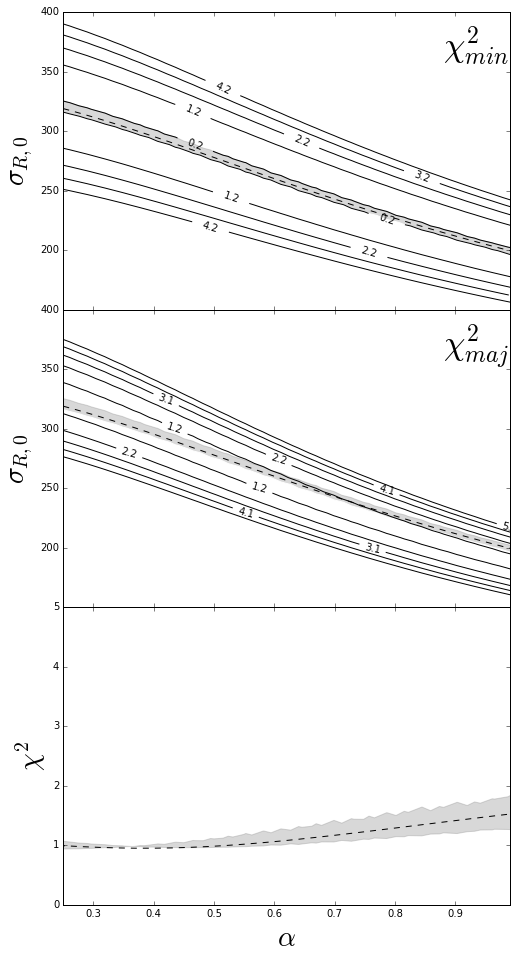

In [67]:
def main_slice(l):
    return sig_min_0/sqrt(sin_i**2 + cos_i**2 * l**2)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

os.chdir("C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\paper1\\text\\imgs")

alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
# levels = np.linspace(start=image_min.min(), stop=20., num=5)
# levels = [100., 125., 150., 175., 200.]
# levels = [image_min.min()+0.02, image_min.min()+0.4, image_min.min()+1.1, image_min.min()+2., 
#           image_min.min()+3.1, image_min.min()+4.1]
# levels = np.linspace(start=image_min.min()+0.1, stop=image_min.min()+4.1, num=5)
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
# im = ax.imshow(image_min, cmap='jet', vmin=image_min.min(), vmax=20., interpolation='spline16', 
#                    origin="lower", aspect="auto")
# plt.show()
cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()
v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
# ax.text(0.87, 280, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=28.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
ax.set_ylim(150, 400)
ax.set_xlim(0.25, 0.99)
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
xlim, ylim = ax.get_xlim(), ax.get_ylim()
ax.text(0.85*(xlim[1]-xlim[0])+xlim[0], 0.85*(ylim[1]-ylim[0]) + ylim[0], '$\chi^2_{min}$', size = 34.)


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')

ax = axes[1]
# levels = np.linspace(start=image_maj.min()-4.3, stop=10., num=10)
# levels = [7., 10., 50., 100.]
# levels = [image_maj.min()+0.2, image_maj.min()+0.7, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = np.linspace(start=image_maj.min()+0.3, stop=image_maj.min()+4.1, num=5)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
# ax.text(0.87, 280, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=28.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
ax.set_ylim(150, 400)
xlim, ylim = ax.get_xlim(), ax.get_ylim()
ax.text(0.85*(xlim[1]-xlim[0])+xlim[0], 0.85*(ylim[1]-ylim[0]) + ylim[0], '$\chi^2_{maj}$', size = 34.)


ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=28.)
ax.set_xlabel(r'$\alpha$', size=28.)

import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)


ax.set_ylabel(r'$\chi^2$', size=28.)
ax.set_xlabel(r'$\alpha$', size=28.)

ax.set_ylim(0.0, 5.)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)

# plt.savefig('ngc1167_maps.eps', format='eps')
plt.savefig(tex_vkr_dir+'ngc1167_maps_large.png', format='png',bbox_inches='tight')
# plt.savefig('ngc1167_maps.pdf', format='pdf', dpi=150)

plt.show()

os.chdir("C:\\science\\2FInstability\\data\\ngc1167")

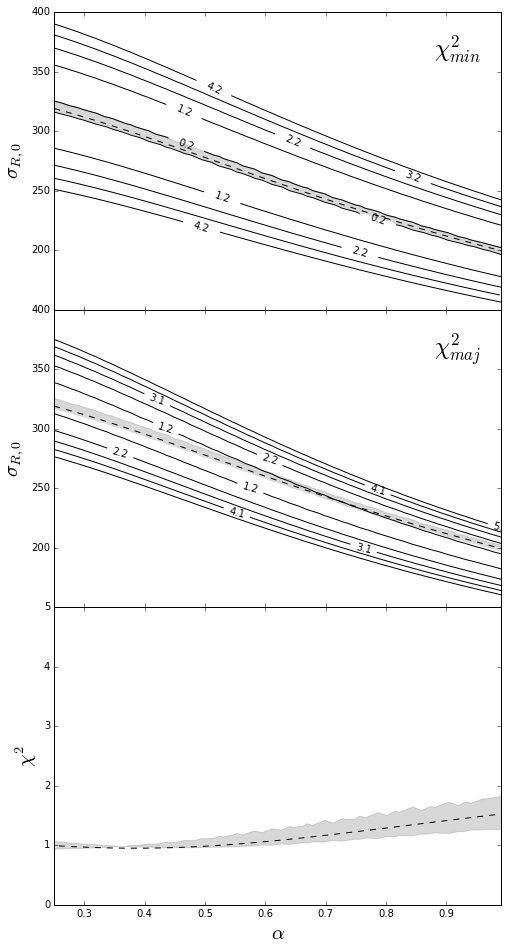

In [68]:
def main_slice(l):
    return sig_min_0/sqrt(sin_i**2 + cos_i**2 * l**2)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

os.chdir("C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\paper1\\text\\imgs")

alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
# levels = np.linspace(start=image_min.min(), stop=20., num=5)
# levels = [100., 125., 150., 175., 200.]
# levels = [image_min.min()+0.02, image_min.min()+0.4, image_min.min()+1.1, image_min.min()+2., 
#           image_min.min()+3.1, image_min.min()+4.1]
# levels = np.linspace(start=image_min.min()+0.1, stop=image_min.min()+4.1, num=5)
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
# im = ax.imshow(image_min, cmap='jet', vmin=image_min.min(), vmax=20., interpolation='spline16', 
#                    origin="lower", aspect="auto")
# plt.show()
cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()
v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
# ax.text(0.87, 280, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
ax.set_ylim(150, 400)
ax.set_xlim(0.25, 0.99)
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
xlim, ylim = ax.get_xlim(), ax.get_ylim()
ax.text(0.85*(xlim[1]-xlim[0])+xlim[0], 0.85*(ylim[1]-ylim[0]) + ylim[0], '$\chi^2_{min}$', size = 24.)


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')

ax = axes[1]
# levels = np.linspace(start=image_maj.min()-4.3, stop=10., num=10)
# levels = [7., 10., 50., 100.]
# levels = [image_maj.min()+0.2, image_maj.min()+0.7, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = np.linspace(start=image_maj.min()+0.3, stop=image_maj.min()+4.1, num=5)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
# ax.text(0.87, 280, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
ax.set_ylim(150, 400)
xlim, ylim = ax.get_xlim(), ax.get_ylim()
ax.text(0.85*(xlim[1]-xlim[0])+xlim[0], 0.85*(ylim[1]-ylim[0]) + ylim[0], '$\chi^2_{maj}$', size = 24.)


ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)


ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

ax.set_ylim(0.0, 5.)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)

plt.savefig(tex_imgs_dir+'ngc1167_maps.eps', format='eps',bbox_inches='tight')
plt.savefig(tex_imgs_dir+'ngc1167_maps.png', format='png',bbox_inches='tight')
plt.savefig(tex_imgs_dir+'ngc1167_maps.pdf', format='pdf', dpi=150,bbox_inches='tight')

plt.show()

os.chdir("C:\\science\\2FInstability\\data\\ngc1167")

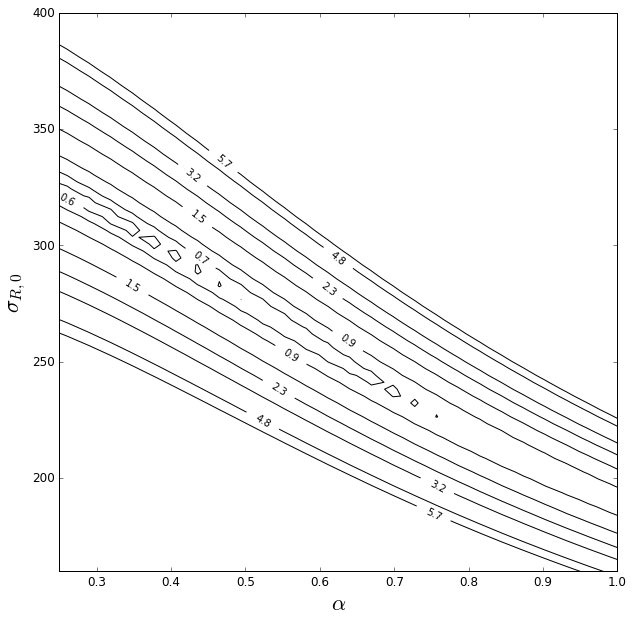

In [80]:
os.chdir(tex_imgs_dir)

alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

fig = plt.figure(figsize=[10,10])
ax = fig.add_subplot(111)
corr_image = (image_min*len(sig_min_p) + image_maj*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
# plot_chi2_map(corr_image, ax, log_scale=False, title='$\chi^2$', is_contour=True, vmax=10.)

levels = np.linspace(start=0.65, stop=corr_image.min()*1.1+5, num=7)
levels = [0.64, 0.7, 0.9, 1.5, 2.3, 3.2, 4.8, 5.7]

cset=ax.contour(corr_image, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()

plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)

ax.set_ylim(160, 400)
ax.set_xlim(0.25, 1.)
ax.set_ylabel('$\sigma_{R,0}$', size=22.)
ax.set_xlabel(r'$\alpha$', size=22.)

for tick in ax.yaxis.get_major_ticks():
    tick.label.set_fontsize(12)
for tick in ax.xaxis.get_major_ticks():
    tick.label.set_fontsize(12)

plt.savefig(tex_imgs_dir+'n1167_pure_chi.eps', format='eps', bbox_inches='tight')
plt.savefig(tex_imgs_dir+'n1167_pure_chi.png', format='png', bbox_inches='tight')
plt.savefig(tex_imgs_dir+'n1167_pure_chi.pdf', format='pdf', dpi=150, bbox_inches='tight')
plt.show()

os.chdir("C:\\science\\2FInstability\\data\\ngc1167")

N1_maj=40,	 N2_min=30,	 chi^2_corr[0][0]=68.9460026686 (was 41.6235443891 and 89.4378463782)


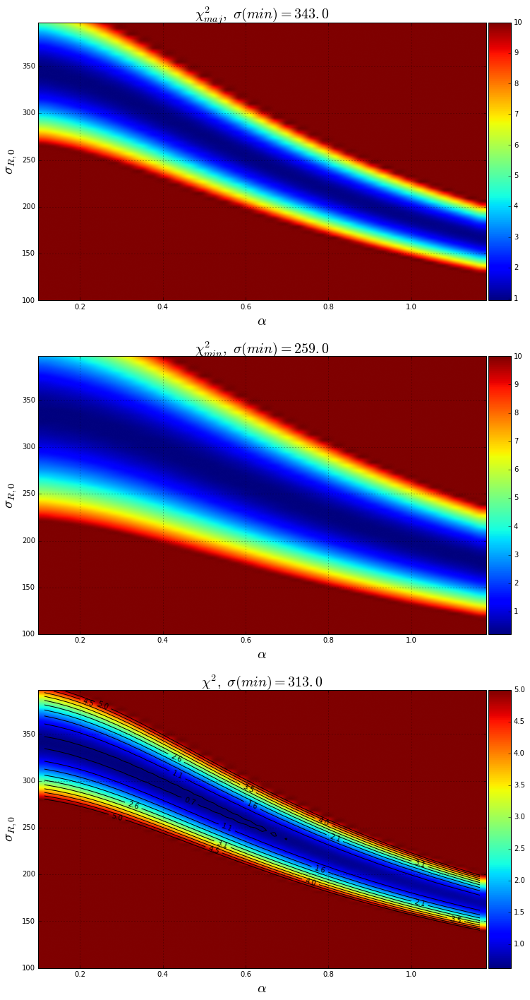

In [67]:
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[12,24])
plot_chi2_map(image_maj, axes[0], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=10.)
plot_chi2_map(image_min, axes[1], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=10.)
corr_image = (image_min*len(sig_min_p) + image_maj*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
print 'N1_maj={},\t N2_min={},\t chi^2_corr[0][0]={} (was {} and {})'.format(len(sig_maj_p), len(sig_min_p), corr_image[0][0], 
                                                                            image_min[0][0], image_maj[0][0])
plot_chi2_map(corr_image, axes[2], log_scale=False, title='$\chi^2$', is_contour=True, vmax=5.)
plt.show()

In [68]:
import scipy.optimize as opt

def chisqfunc((x_sig, x_alpha)):
    global sig_R_0, alpha
    sig_R_0 = x_sig
    alpha = x_alpha
    sqerr_ma = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    sqerr_mi = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
    chisq = (sqerr_mi*len(sig_min_p) + sqerr_ma*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
    return chisq

x0 = np.array([100., 0.5])

res = opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B')
print res

      fun: 0.62490784152722978
 hess_inv: <2x2 LbfgsInvHessProduct with dtype=float64>
      jac: array([  4.66293670e-07,   8.38440428e-05])
  message: 'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 75
      nit: 19
   status: 0
  success: True
        x: array([  3.12946058e+02,   3.10263355e-01])


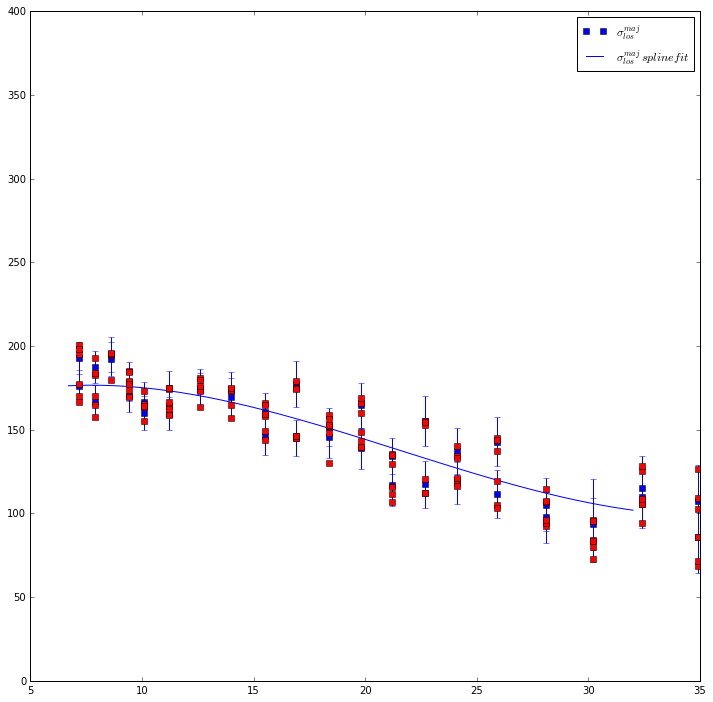

In [69]:
def gen_next_normal(radii, sig, esig):
    randomDelta =  np.array([np.random.normal(0., derr/2, 1)[0] for derr in esig] ) 
    randomdataY = sig + randomDelta
    return zip(radii, randomdataY)

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='o', marker='.', color='blue')
plt.plot(points, poly_sig_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
 
for i in range(3):
    r, s = zip(*gen_next_normal(radii_maj, sig_maj_p, e_sig_maj_p))
    plt.plot(r, s, 's', color='red')

plt.ylim(0., 400.)
plt.legend()
plt.show()

In [70]:
os.chdir("C:\\science\\2FInstability\\data\\ngc1167")
pics_path = '.cutted\\pics\\'
import time

N = 1000

result = []

start_time = time.time()



for i in log_progress(range(N)):
    global poly_sig_maj, poly_sig_min
#     r, s = zip(*gen_next_normal(radii_maj, sig_maj_p, e_sig_maj_p))
    poly_sig_maj = inter.UnivariateSpline(r, s, k=3, s=10000.)
#     poly_sig_maj = poly1d(polyfit(r, s,  deg=9))

    r, s = zip(*gen_next_normal(radii_min, sig_min_p, e_sig_min_p))
    poly_sig_min = inter.UnivariateSpline(r, s, k=3, s=10000., w=w(e_sig_min_p))
#     poly_sig_min = poly1d(polyfit(r, s,  deg=9))

#     result.append((opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B').x,
#                   poly_sig_maj.get_coeffs(), poly_sig_min.get_coeffs()))
    result.append((opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (0., alphas[-1])], method='L-BFGS-B').x,
                  poly_sig_maj.get_coeffs(), poly_sig_min.get_coeffs()))
#     result.append((opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B').x,
#                   poly_sig_maj.coeffs, poly_sig_min.coeffs))


print("--- %s seconds ---" % (time.time() - start_time))

--- 382.762000084 seconds ---


In [71]:
len(result)

1000

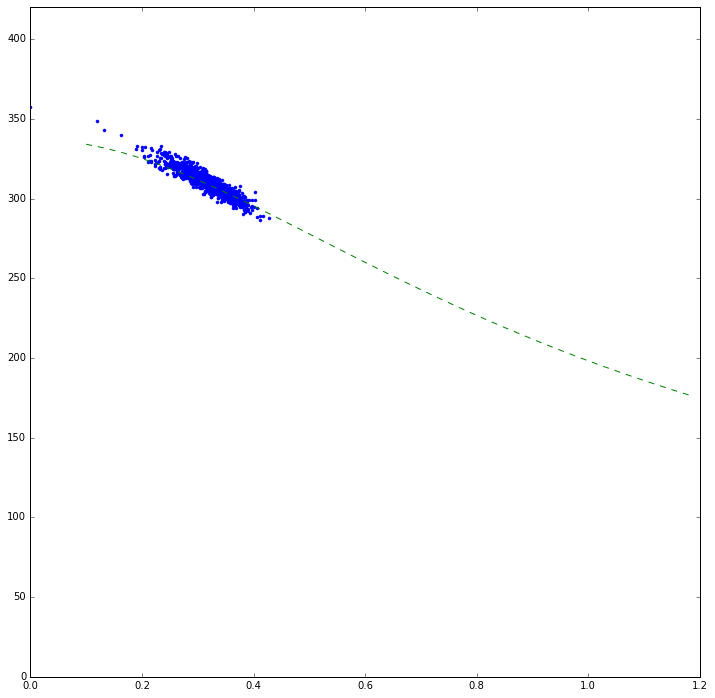

In [72]:
s, _, _ = zip(*result)
s,a = zip(*s)
plt.plot(a, s, '.')
plt.plot(alphas, map(main_slice, alphas), '--')
# plt.xlim(0.0, 0.99)
plt.ylim(0, 420)
plt.show()

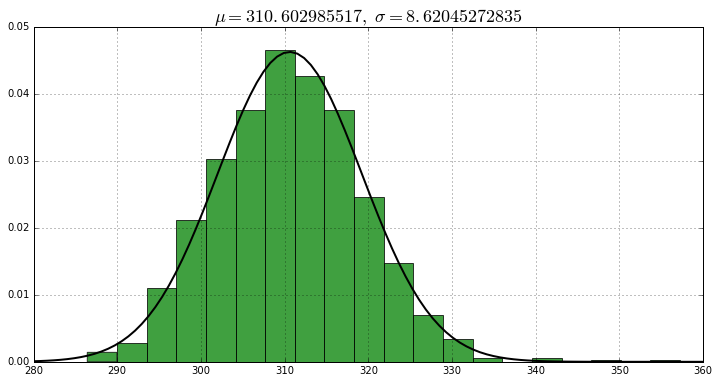

In [73]:
from scipy.stats import norm

fig = plt.figure(figsize=(12,6))
ax = fig.add_subplot(111)

n, bins, patches = ax.hist(s, 20, normed=1, facecolor='green', alpha=0.75)
mu, std = norm.fit(s)

xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)
plt.plot(x, p, 'k', linewidth=2)

ax.set_title('$\mu=%s,\ \sigma=%s$' % (mu, std), fontsize=18)
ax.grid(True)

plt.show()

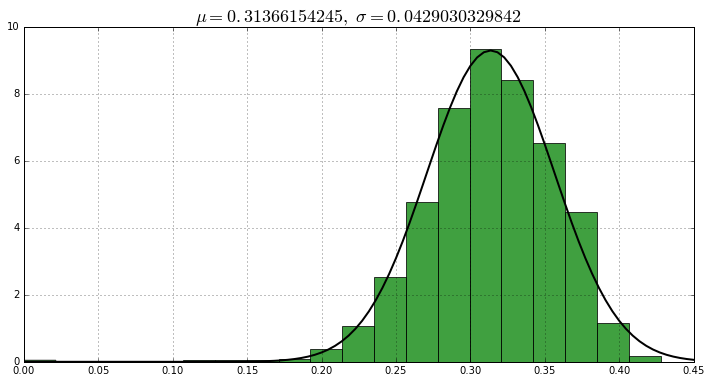

In [74]:
from scipy.stats import norm

fig = plt.figure(figsize=(12,6))
ax = fig.add_subplot(111)

n, bins, patches = ax.hist(a, 20, normed=1, facecolor='green', alpha=0.75)
mu, std = norm.fit(a)

xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)
plt.plot(x, p, 'k', linewidth=2)

ax.set_title('$\mu=%s,\ \sigma=%s$' % (mu, std), fontsize=18)
ax.grid(True)

plt.show()

# 3. r_ef=0, sig_R_0=spline(0)

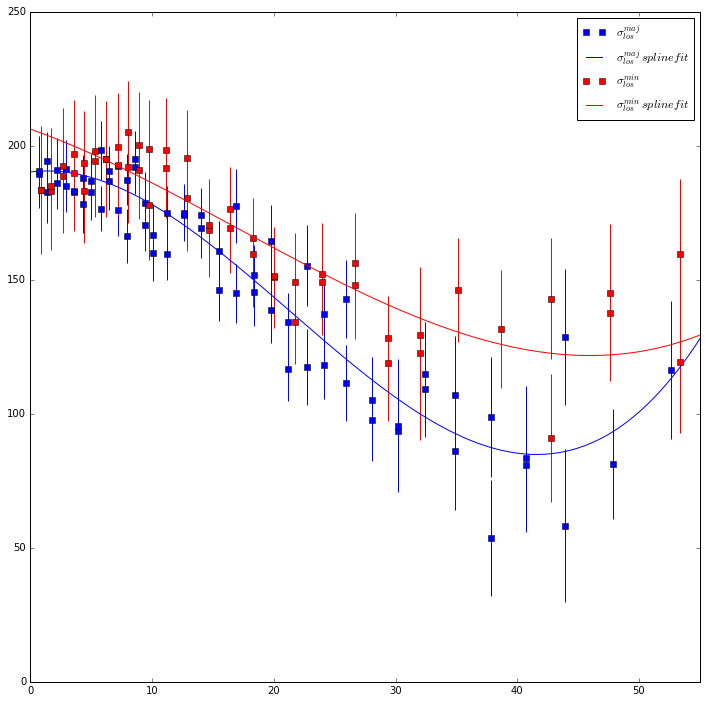

In [75]:
# Граница. по которой обрезаем
cutted = 0.0

sig_maj_data = zip(radii_maj1, sig_maj_p1, e_sig_maj_p1)
sig_maj_data = filter(lambda l: l[0] > cutted, sig_maj_data)
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data) 

sig_min_data = zip(radii_min1, sig_min_p1, e_sig_min_p1)
sig_min_data = filter(lambda l: l[0] > cutted, sig_min_data)
radii_min, sig_min_p, e_sig_min_p = zip(*sig_min_data) 

points = np.arange(cutted, max(radii_min), 0.1)

def w(arr):
    return map(lambda l: 1/(1. + l**2), arr)

spl_maj = inter.UnivariateSpline(radii_maj[::-1], sig_maj_p[::-1], k=3, s=10000., w=w(e_sig_maj_p))
spl_min = inter.UnivariateSpline(radii_min[::-1], sig_min_p[::-1], k=3, s=10000., w=w(e_sig_min_p))

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='.', marker='.', mew=0, color='blue')
plt.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
plt.plot(radii_min, sig_min_p, 's', label='$\sigma_{los}^{min}$', color='red')
plt.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='.', marker='.', mew=0, color='red')
plt.plot(points, spl_min(points), label = '$\sigma_{los}^{min}\, splinefit$', color='red')
plt.axvline(x=cutted, color='black')
plt.legend()
plt.ylim(0,250)
plt.xlim(0,55)
plt.show()

poly_sig_maj = spl_maj
poly_sig_min = spl_min

In [76]:
#Значение sig_los_min в 0
sig_min_0 = poly_sig_min(0)
print sig_min_0

206.342212584


И восстановим профили $\sigma_{los}^{maj}$ и $\sigma_{los}^{min}$. Связь профилей описывается следующими уравнениями: $$\sigma_{los,maj}^2=\sigma_{\varphi}^2\sin^2i+\sigma_Z^2\cos^2i$$ $$\sigma_{los,min}^2=\sigma_R^2\sin^2i+\sigma_Z^2\cos^2i$$

In [77]:
# def sig_maj_exp(R):
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

# def sig_min_exp(R):
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)


cos_i, sin_i = cos(incl * pi / 180), sin(incl * pi / 180)


def sig_maj_exp(R):
    tmp = sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2
    if tmp > 0:
        return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2)
    else:
        return -1000000
#     return sig_R_0*spl_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR(R)**2 * sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

def sig_min_exp(R):
    return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

Теперь то, с чего надо было начинать - построим картинки для разных значений $\alpha$ и $\sigma_{R,0}$. Для того, чтобы найти где минимум, попробуем построить просто двумерные карты $\chi^2$ для разных $\sigma_{R,0}$  $\alpha$: (это очень долго, так что пересчитывать в крайнем случае) 

In [78]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

def compute_chi2_maps(alphas=(), sigmas=()):
    '''Вычисляем все изображения, чтобы потом только настройки менять'''
    image_min = np.random.uniform(size=(len(sigmas), len(alphas)))
    image_maj = np.random.uniform(size=(len(sigmas), len(alphas)))
    image = np.random.uniform(size=(len(sigmas), len(alphas)))
    for i,si in enumerate(sigmas):
        for j,al in enumerate(alphas):
            global alpha, sig_R_0
            alpha = al
            sig_R_0 = si
            sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
            sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
            sqerr_sum = 0.5*sqerr_maj+0.5*sqerr_min
            image[i][j] = sqerr_sum
            image_maj[i][j] = sqerr_maj
            image_min[i][j] = sqerr_min
    return image, image_maj, image_min
    
image, image_maj, image_min = compute_chi2_maps(alphas=alphas, sigmas=sigmas)

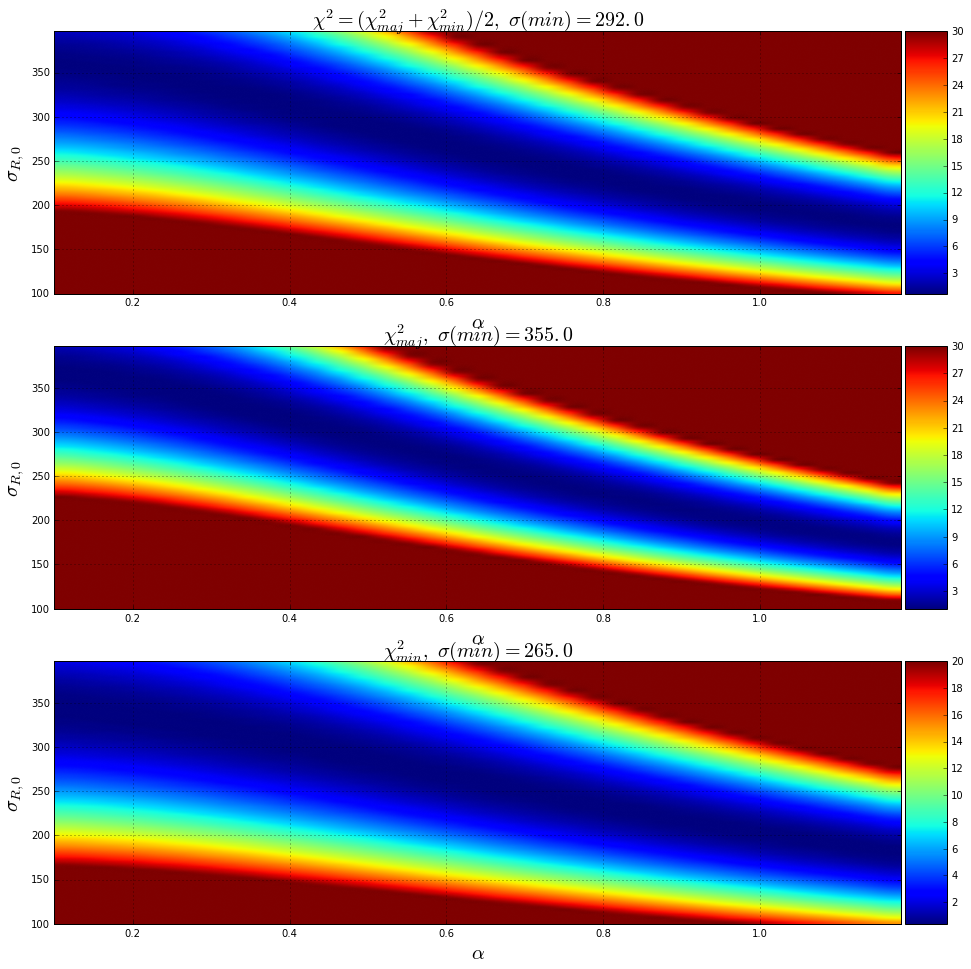

In [79]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_chi2_map(image, ax, log_scale=False, title='$\chi^2$', is_contour=False, vmax=0.):
    '''Рисуем получившиеся карты.
    Colormaps: http://wiki.scipy.org/Cookbook/Matplotlib/Show_colormaps'''
    if image is not None:
        if log_scale:
            image_log = np.apply_along_axis(np.log, 1, image)
            vmax = image_log.max()
        else:
            image_log = image
        if is_contour:
            norm = plt.cm.colors.Normalize(vmax=image.max(), vmin=-image.max())
            cmap = plt.cm.PRGn
            levels = np.concatenate([np.array([image_log.min()*1.1,]), np.linspace(start=image_log.min(), stop=vmax, num=10)])
            levels = sorted(levels)
            cset=ax.contour(image_log, levels, hold='on', colors = 'k', origin='lower', 
                            extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
            ax.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
        im = ax.imshow(image_log, cmap='jet', vmin=image_log.min(), vmax=vmax, interpolation='spline16', 
                   origin="lower", extent=[alphas[0], alphas[-1],sigmas[0],sigmas[-1]], aspect="auto")
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
        min_sigma = sigmas[int(np.where(image == image.min())[0])]        
        ax.set_title(title + '$,\ \sigma(min)=%s$' % min_sigma, size=20.)
        ax.set_ylabel('$\sigma_{R,0}$', size=20.)
        ax.set_xlabel(r'$\alpha$', size=20.)
        ax.grid(True)
 
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[16,16])
plot_chi2_map(image, axes[0], log_scale=False, title='$\chi^2 = (\chi^2_{maj} + \chi^2_{min})/2$', is_contour=False, vmax=30.)
plot_chi2_map(image_maj, axes[1], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=30.)
plot_chi2_map(image_min, axes[2], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=20.)
plt.show()

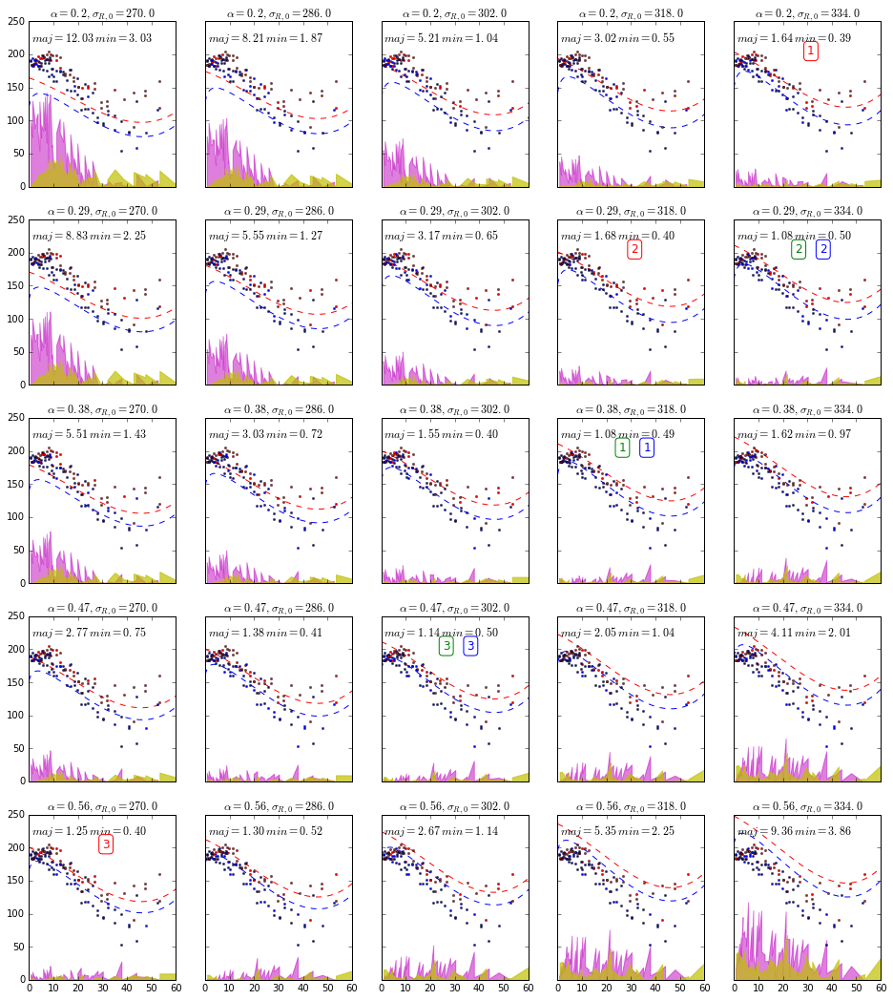

In [80]:
# Перебор alpha
alphas = np.arange(0.2, 0.65, 0.09)

# Перебор sig_R_0
sigmas = np.arange(270., 350., 16.)

# Те картинки, на которые стоит обратить особое внимание
good_pics = []

# def plot_ranges(sigmas_range, alphas_range, good_pics=[], calc_chi=False, best_err=3):
#     '''
#     Для всех предложенных вариантов sigR и alpha
#     рисует графики исходных и восстановленных дисперсий скоростей los.
#     Если calc_chi = True, то также считает ошибку по наблюдаемым точкам.
#     Если ошибка считается, то отмечаются best_err лучших (наименьших) результата.
#     Синий - для большой оси, красный - малой, зеленый - полусумма.
#     Изменяет глобальные значения sig_R_0 и alpha!'''
#     nrows = alphas.size
#     ncols = sigmas.size
#     fig, axes = plt.subplots(nrows=nrows, ncols=ncols, sharex=True, sharey=True, figsize=[16,12])
#     plt_index = 0
#     # Последнее - среднее геометрическое
#     sqerr_majs, sqerr_mins, sqerr_mean = [],[],[]
#     for al in alphas_range:
#         for si in sigmas_range:
#             global alpha, sig_R_0
#             alpha = al
#             sig_R_0 = si
#             ax = axes[plt_index/ncols, plt_index % ncols]
#             ax.set_title(r'$\alpha = %s, \sigma_{R,0}=%s$' % (al,si))
#             ax.plot(points, poly_sig_maj(points), '-', color='blue')
#             ax.plot(points, [sig_maj_exp(Rr) for Rr in points], '--', color='blue')
#             ax.plot(points, poly_sig_min(points), '-', color='red')
#             ax.plot(points, [sig_min_exp(R) for R in points], '--', color='red')
#             if calc_chi:
#                 sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(p[0]) for p in sig_maj_data])
#                 sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(p[0]) for p in sig_min_data])
# #                 sqerr_maj = sum(power([sig_maj_exp(p[0]) - p[1] for p in sig_maj_data], 2))/len(sig_maj_data)
# #                 sqerr_min = sum(power([sig_min_exp(p[0]) - p[1] for p in sig_min_data], 2))/len(sig_min_data)
#                 ax.text(1, 5, "$\chi^2_{maj}=%5.0f\, \chi^2_{min}=%5.0f$" % (sqerr_maj, sqerr_min), fontsize=12)
#                 sqerr_majs.append(sqerr_maj);sqerr_mins.append(sqerr_min)
#                 sqerr_mean.append(0.5*sqerr_maj+0.5*sqerr_min)
#             ax.set_ylim(0, 250)
#             ax.set_xlim(0, 50)
#             if (plt_index/ncols, plt_index % ncols) in good_pics:
#                 ax.plot([40], [200], 'o', markersize=12., color=(0.2,1.0,0.))
#             plt_index = plt_index + 1
#     if calc_chi:
#         best_maj_err = heapq.nsmallest(best_err, sqerr_majs)
#         for b_maj in best_maj_err:
#             b_maj_ind = sqerr_majs.index(b_maj)
#             ax = axes[b_maj_ind/ncols, b_maj_ind % ncols]
#             #ax.plot([35], [200], 'o', markersize=12., color='b')
#             ax.text(35, 200, "%s" % (best_maj_err.index(b_maj)+1), fontsize=12, color='b', 
#                     bbox=dict(facecolor='none', edgecolor='b', boxstyle='round'))
#         best_min_err = heapq.nsmallest(best_err, sqerr_mins)
#         for b_min in best_min_err:
#             b_min_ind = sqerr_mins.index(b_min)
#             ax = axes[b_min_ind/ncols, b_min_ind % ncols]
#             #ax.plot([30], [200], 'o', markersize=12., color='r')
#             ax.text(30, 200, "%s" % (best_min_err.index(b_min)+1), fontsize=12, color='r', 
#                     bbox=dict(facecolor='none', edgecolor='r', boxstyle='round'))
#         best_mean_err = heapq.nsmallest(best_err, sqerr_mean)
#         for b_mean in best_mean_err:
#             b_mean_ind = sqerr_mean.index(b_mean)
#             ax = axes[b_mean_ind/ncols, b_mean_ind % ncols]
#             ax.text(25, 200, "%s" % (best_mean_err.index(b_mean)+1), fontsize=12, color='g', 
#                     bbox=dict(facecolor='none', edgecolor='g', boxstyle='round'))

plot_ranges(sigmas, alphas, good_pics=good_pics, calc_chi=True)
plt.show()

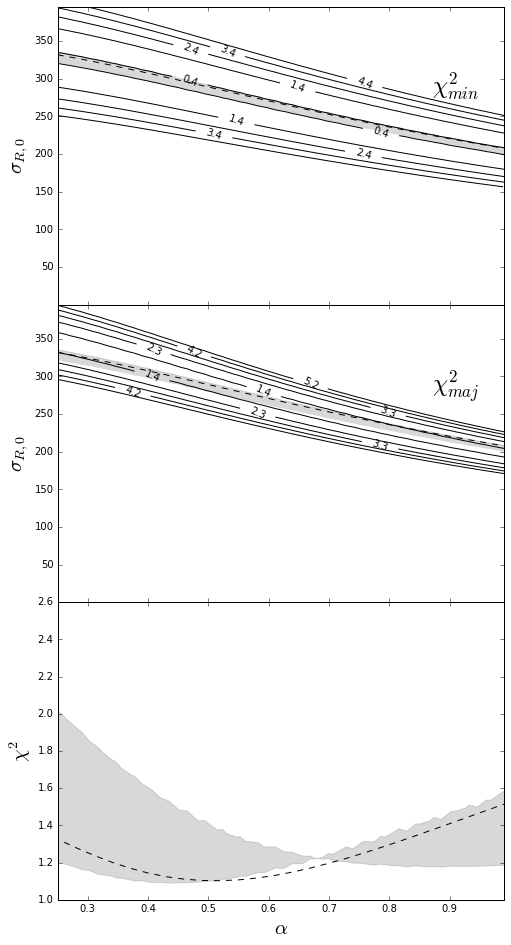

In [81]:
main_slice = lambda l: sig_min_0/sqrt(sin_i**2 + cos_i**2 * l**2)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

# os.chdir("C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\paper1\\text\\imgs")

alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
# levels = np.linspace(start=image_min.min(), stop=20., num=5)
# levels = [100., 125., 150., 175., 200.]
# levels = [image_min.min()+0.02, image_min.min()+0.4, image_min.min()+1.1, image_min.min()+2., 
#           image_min.min()+3.1, image_min.min()+4.1]
# levels = np.linspace(start=image_min.min()+0.1, stop=image_min.min()+4.1, num=5)
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
# im = ax.imshow(image_min, cmap='jet', vmin=image_min.min(), vmax=20., interpolation='spline16', 
#                    origin="lower", aspect="auto")
# plt.show()
cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()
v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
# ax.set_ylim(180, 300)
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')

ax = axes[1]
# levels = np.linspace(start=image_maj.min()-4.3, stop=10., num=10)
# levels = [7., 10., 50., 100.]
# levels = [image_maj.min()+0.2, image_maj.min()+0.7, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = np.linspace(start=image_maj.min()+0.3, stop=image_maj.min()+4.1, num=5)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')

ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
# ax.set_ylim(150, 320)

ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)

ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

# ax.set_ylim(3.1, 3.5)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)

plt.show()

N1_maj=66,	 N2_min=54,	 chi^2_corr[0][0]=74.7096778883 (was 36.8368231288 and 105.696559055)


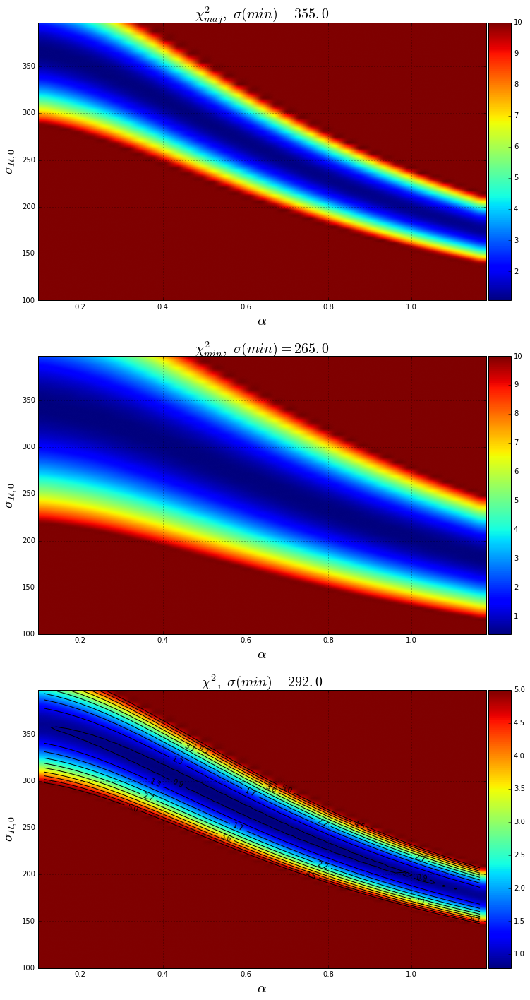

In [82]:
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[12,24])
plot_chi2_map(image_maj, axes[0], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=10.)
plot_chi2_map(image_min, axes[1], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=10.)
corr_image = (image_min*len(sig_min_p) + image_maj*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
print 'N1_maj={},\t N2_min={},\t chi^2_corr[0][0]={} (was {} and {})'.format(len(sig_maj_p), len(sig_min_p), corr_image[0][0], 
                                                                            image_min[0][0], image_maj[0][0])
plot_chi2_map(corr_image, axes[2], log_scale=False, title='$\chi^2$', is_contour=True, vmax=5.)
plt.show()

In [83]:
import scipy.optimize as opt

def chisqfunc((x_sig, x_alpha)):
    global sig_R_0, alpha
    sig_R_0 = x_sig
    alpha = x_alpha
    sqerr_ma = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    sqerr_mi = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
    chisq = (sqerr_mi*len(sig_min_p) + sqerr_ma*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
    return chisq

x0 = np.array([100., 0.5])

res = opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B')
print res

      fun: 0.78745799776331726
 hess_inv: <2x2 LbfgsInvHessProduct with dtype=float64>
      jac: array([  0.00000000e+00,   7.07212067e-06])
  message: 'CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL'
     nfev: 75
      nit: 18
   status: 0
  success: True
        x: array([ 283.87953624,    0.52554789])


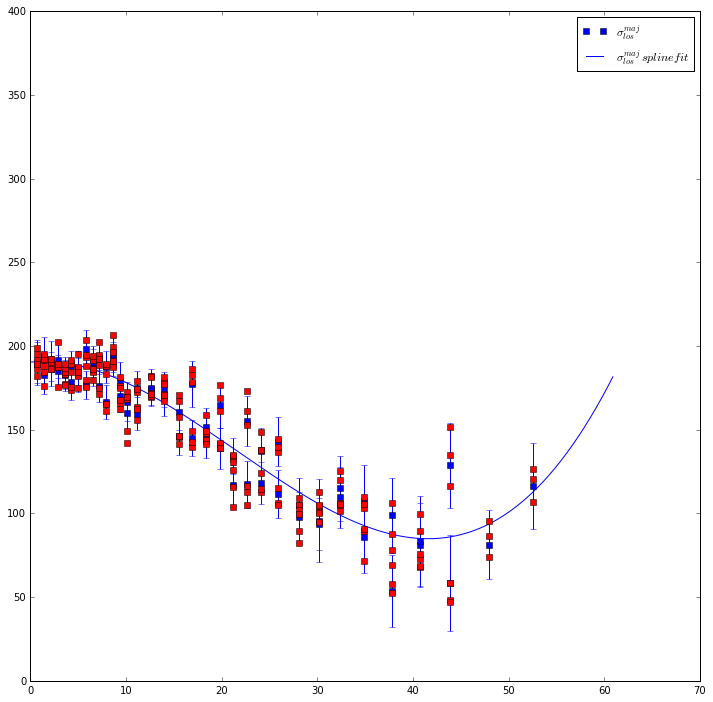

In [84]:
def gen_next_normal(radii, sig, esig):
    randomDelta =  np.array([np.random.normal(0., derr/2, 1)[0] for derr in esig] ) 
    randomdataY = sig + randomDelta
    return zip(radii, randomdataY)

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='o', marker='.', color='blue')
plt.plot(points, poly_sig_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
 
for i in range(3):
    r, s = zip(*gen_next_normal(radii_maj, sig_maj_p, e_sig_maj_p))
    plt.plot(r, s, 's', color='red')

plt.ylim(0., 400.)
plt.legend()
plt.show()

In [85]:
import time

N = 300

result = []

start_time = time.time()

for i in log_progress(range(N)):
    global poly_sig_maj, poly_sig_min
    r, s = zip(*gen_next_normal(radii_maj, sig_maj_p, e_sig_maj_p))
    poly_sig_maj = inter.UnivariateSpline(r, s, k=3, s=10000., w=w(e_sig_maj_p))
#     poly_sig_maj = poly1d(polyfit(r, s,  deg=9))
    
    r, s = zip(*gen_next_normal(radii_min, sig_min_p, e_sig_min_p))
    poly_sig_min = inter.UnivariateSpline(r, s, k=3, s=10000., w=w(e_sig_min_p))
#     poly_sig_min = poly1d(polyfit(r, s,  deg=9))
    
    result.append((opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B').x,
                  poly_sig_maj.get_coeffs(), poly_sig_min.get_coeffs()))
#     result.append((opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B').x,
#                   poly_sig_maj.coeffs, poly_sig_min.coeffs))
print("--- %s seconds ---" % (time.time() - start_time))

--- 182.780999899 seconds ---


In [86]:
len(result)

300

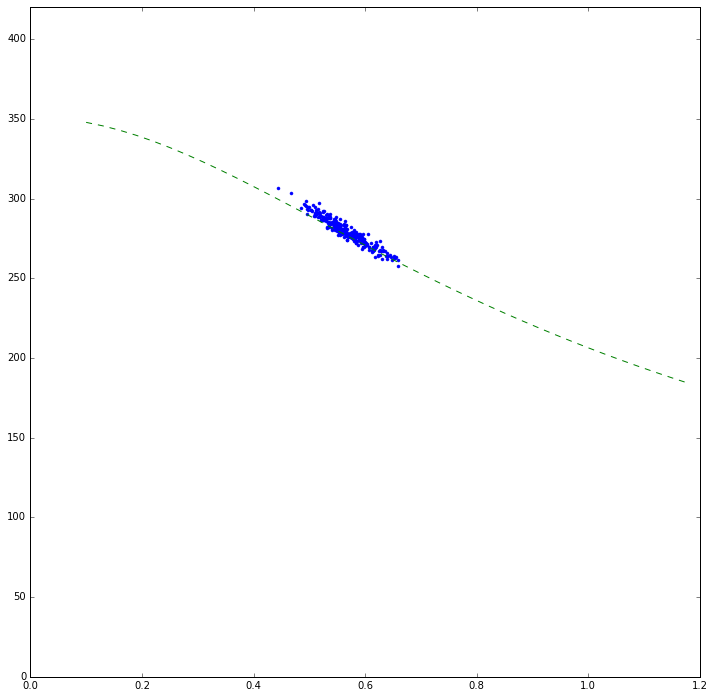

In [87]:
s, _, _ = zip(*result)
s,a = zip(*s)
plt.plot(a, s, '.')
plt.plot(alphas, map(main_slice, alphas), '--')
# plt.xlim(0.0, 0.99)
plt.ylim(0, 420)
plt.show()

# 4. r_ef=4.5, sig_R_0=170

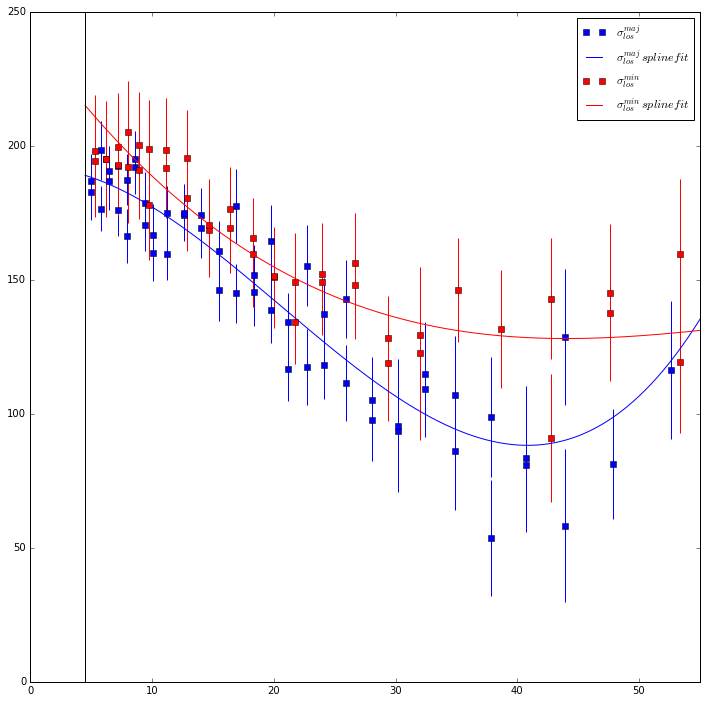

In [88]:
# Граница. по которой обрезаем
cutted = 4.5

sig_maj_data = zip(radii_maj1, sig_maj_p1, e_sig_maj_p1)
sig_maj_data = filter(lambda l: l[0] > cutted, sig_maj_data)
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data) 

sig_min_data = zip(radii_min1, sig_min_p1, e_sig_min_p1)
sig_min_data = filter(lambda l: l[0] > cutted, sig_min_data)
radii_min, sig_min_p, e_sig_min_p = zip(*sig_min_data) 

points = np.arange(cutted, max(radii_min), 0.1)

def w(arr):
    return map(lambda l: 1/(1. + l**2), arr)

spl_maj = inter.UnivariateSpline(radii_maj[::-1], sig_maj_p[::-1], k=3, s=10000., w=w(e_sig_maj_p))
spl_min = inter.UnivariateSpline(radii_min[::-1], sig_min_p[::-1], k=3, s=10000., w=w(e_sig_min_p))

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='.', marker='.', mew=0, color='blue')
plt.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
plt.plot(radii_min, sig_min_p, 's', label='$\sigma_{los}^{min}$', color='red')
plt.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='.', marker='.', mew=0, color='red')
plt.plot(points, spl_min(points), label = '$\sigma_{los}^{min}\, splinefit$', color='red')
plt.axvline(x=cutted, color='black')
plt.legend()
plt.ylim(0,250)
plt.xlim(0,55)
plt.show()

poly_sig_maj = spl_maj
poly_sig_min = spl_min

In [89]:
#Значение sig_los_min в 0
# sig_min_0 = poly_sig_min(0)
sig_min_0 = 170
print sig_min_0

170


И восстановим профили $\sigma_{los}^{maj}$ и $\sigma_{los}^{min}$. Связь профилей описывается следующими уравнениями: $$\sigma_{los,maj}^2=\sigma_{\varphi}^2\sin^2i+\sigma_Z^2\cos^2i$$ $$\sigma_{los,min}^2=\sigma_R^2\sin^2i+\sigma_Z^2\cos^2i$$

In [90]:
# def sig_maj_exp(R):
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

# def sig_min_exp(R):
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)


cos_i, sin_i = cos(incl * pi / 180), sin(incl * pi / 180)


def sig_maj_exp(R):
    tmp = sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2
    if tmp > 0:
        return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2)
    else:
        return -1000000
#     return sig_R_0*spl_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR(R)**2 * sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

def sig_min_exp(R):
    return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

Теперь то, с чего надо было начинать - построим картинки для разных значений $\alpha$ и $\sigma_{R,0}$. Для того, чтобы найти где минимум, попробуем построить просто двумерные карты $\chi^2$ для разных $\sigma_{R,0}$  $\alpha$: (это очень долго, так что пересчитывать в крайнем случае) 

In [91]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

def compute_chi2_maps(alphas=(), sigmas=()):
    '''Вычисляем все изображения, чтобы потом только настройки менять'''
    image_min = np.random.uniform(size=(len(sigmas), len(alphas)))
    image_maj = np.random.uniform(size=(len(sigmas), len(alphas)))
    image = np.random.uniform(size=(len(sigmas), len(alphas)))
    for i,si in enumerate(sigmas):
        for j,al in enumerate(alphas):
            global alpha, sig_R_0
            alpha = al
            sig_R_0 = si
            sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
            sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
            sqerr_sum = 0.5*sqerr_maj+0.5*sqerr_min
            image[i][j] = sqerr_sum
            image_maj[i][j] = sqerr_maj
            image_min[i][j] = sqerr_min
    return image, image_maj, image_min
    
image, image_maj, image_min = compute_chi2_maps(alphas=alphas, sigmas=sigmas)

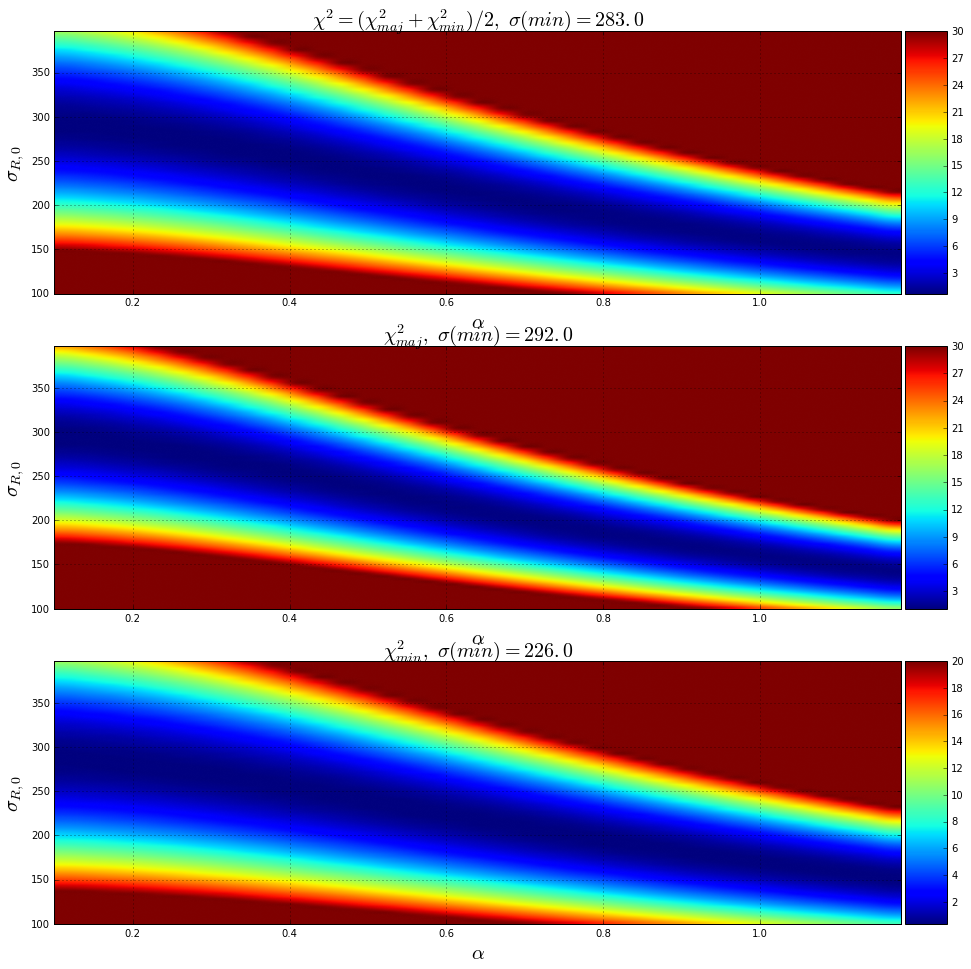

In [92]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_chi2_map(image, ax, log_scale=False, title='$\chi^2$', is_contour=False, vmax=0.):
    '''Рисуем получившиеся карты.
    Colormaps: http://wiki.scipy.org/Cookbook/Matplotlib/Show_colormaps'''
    if image is not None:
        if log_scale:
            image_log = np.apply_along_axis(np.log, 1, image)
            vmax = image_log.max()
        else:
            image_log = image
        if is_contour:
            norm = plt.cm.colors.Normalize(vmax=image.max(), vmin=-image.max())
            cmap = plt.cm.PRGn
            levels = np.concatenate([np.array([image_log.min()*1.1,]), np.linspace(start=image_log.min(), stop=vmax, num=10)])
            levels = sorted(levels)
            cset=ax.contour(image_log, levels, hold='on', colors = 'k', origin='lower', 
                            extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
            ax.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
        im = ax.imshow(image_log, cmap='jet', vmin=image_log.min(), vmax=vmax, interpolation='spline16', 
                   origin="lower", extent=[alphas[0], alphas[-1],sigmas[0],sigmas[-1]], aspect="auto")
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
        min_sigma = sigmas[int(np.where(image == image.min())[0])]        
        ax.set_title(title + '$,\ \sigma(min)=%s$' % min_sigma, size=20.)
        ax.set_ylabel('$\sigma_{R,0}$', size=20.)
        ax.set_xlabel(r'$\alpha$', size=20.)
        ax.grid(True)
 
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[16,16])
plot_chi2_map(image, axes[0], log_scale=False, title='$\chi^2 = (\chi^2_{maj} + \chi^2_{min})/2$', is_contour=False, vmax=30.)
plot_chi2_map(image_maj, axes[1], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=30.)
plot_chi2_map(image_min, axes[2], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=20.)
plt.show()

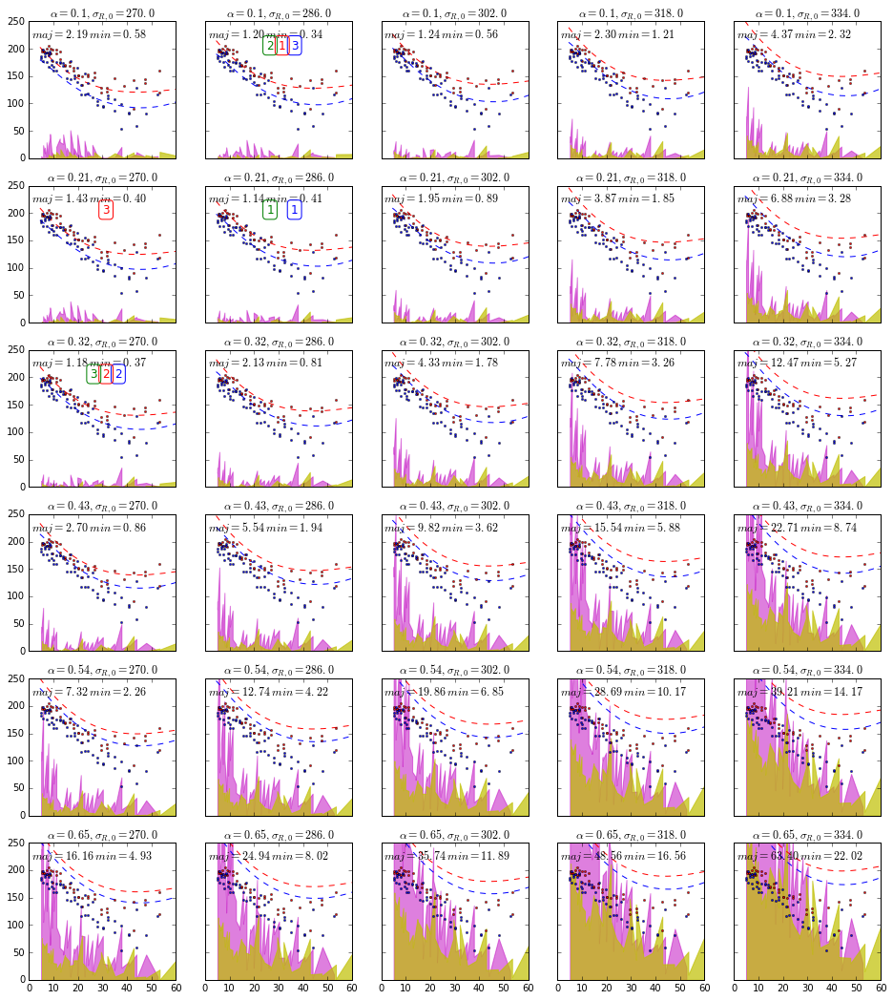

In [93]:
# Перебор alpha
alphas = np.arange(0.1, 0.7, 0.11)

# Перебор sig_R_0
sigmas = np.arange(270., 350., 16.)

# Те картинки, на которые стоит обратить особое внимание
good_pics = []

# def plot_ranges(sigmas_range, alphas_range, good_pics=[], calc_chi=False, best_err=3):
#     '''
#     Для всех предложенных вариантов sigR и alpha
#     рисует графики исходных и восстановленных дисперсий скоростей los.
#     Если calc_chi = True, то также считает ошибку по наблюдаемым точкам.
#     Если ошибка считается, то отмечаются best_err лучших (наименьших) результата.
#     Синий - для большой оси, красный - малой, зеленый - полусумма.
#     Изменяет глобальные значения sig_R_0 и alpha!'''
#     nrows = alphas.size
#     ncols = sigmas.size
#     fig, axes = plt.subplots(nrows=nrows, ncols=ncols, sharex=True, sharey=True, figsize=[16,12])
#     plt_index = 0
#     # Последнее - среднее геометрическое
#     sqerr_majs, sqerr_mins, sqerr_mean = [],[],[]
#     for al in alphas_range:
#         for si in sigmas_range:
#             global alpha, sig_R_0
#             alpha = al
#             sig_R_0 = si
#             ax = axes[plt_index/ncols, plt_index % ncols]
#             ax.set_title(r'$\alpha = %s, \sigma_{R,0}=%s$' % (al,si))
#             ax.plot(points, poly_sig_maj(points), '-', color='blue')
#             ax.plot(points, [sig_maj_exp(Rr) for Rr in points], '--', color='blue')
#             ax.plot(points, poly_sig_min(points), '-', color='red')
#             ax.plot(points, [sig_min_exp(R) for R in points], '--', color='red')
#             if calc_chi:
#                 sqerr_maj = sum(power([sig_maj_exp(p[0]) - p[1] for p in sig_maj_data], 2))/len(sig_maj_data)
#                 sqerr_min = sum(power([sig_min_exp(p[0]) - p[1] for p in sig_min_data], 2))/len(sig_min_data)
#                 ax.text(1, 5, "$\chi^2_{maj}=%5.0f\, \chi^2_{min}=%5.0f$" % (sqerr_maj, sqerr_min), fontsize=12)
#                 sqerr_majs.append(sqerr_maj);sqerr_mins.append(sqerr_min)
#                 sqerr_mean.append(0.5*sqerr_maj+0.5*sqerr_min)
#             ax.set_ylim(0, 250)
#             ax.set_xlim(0, 50)
#             if (plt_index/ncols, plt_index % ncols) in good_pics:
#                 ax.plot([40], [200], 'o', markersize=12., color=(0.2,1.0,0.))
#             plt_index = plt_index + 1
#     if calc_chi:
#         best_maj_err = heapq.nsmallest(best_err, sqerr_majs)
#         for b_maj in best_maj_err:
#             b_maj_ind = sqerr_majs.index(b_maj)
#             ax = axes[b_maj_ind/ncols, b_maj_ind % ncols]
#             #ax.plot([35], [200], 'o', markersize=12., color='b')
#             ax.text(35, 200, "%s" % (best_maj_err.index(b_maj)+1), fontsize=12, color='b', 
#                     bbox=dict(facecolor='none', edgecolor='b', boxstyle='round'))
#         best_min_err = heapq.nsmallest(best_err, sqerr_mins)
#         for b_min in best_min_err:
#             b_min_ind = sqerr_mins.index(b_min)
#             ax = axes[b_min_ind/ncols, b_min_ind % ncols]
#             #ax.plot([30], [200], 'o', markersize=12., color='r')
#             ax.text(30, 200, "%s" % (best_min_err.index(b_min)+1), fontsize=12, color='r', 
#                     bbox=dict(facecolor='none', edgecolor='r', boxstyle='round'))
#         best_mean_err = heapq.nsmallest(best_err, sqerr_mean)
#         for b_mean in best_mean_err:
#             b_mean_ind = sqerr_mean.index(b_mean)
#             ax = axes[b_mean_ind/ncols, b_mean_ind % ncols]
#             ax.text(25, 200, "%s" % (best_mean_err.index(b_mean)+1), fontsize=12, color='g', 
#                     bbox=dict(facecolor='none', edgecolor='g', boxstyle='round'))

plot_ranges(sigmas, alphas, good_pics=good_pics, calc_chi=True)
plt.show()

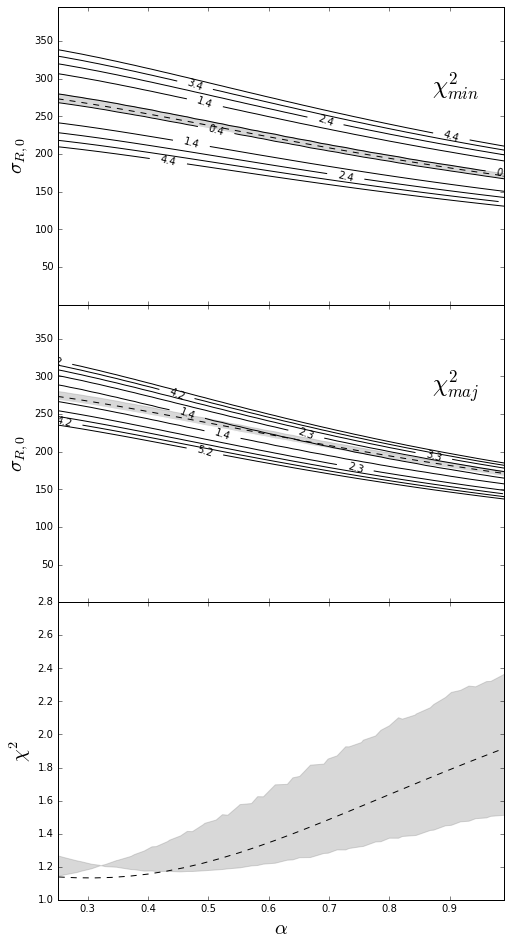

In [94]:
main_slice = lambda l: sig_min_0/sqrt(sin_i**2 + cos_i**2 * l**2)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

# os.chdir("C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\paper1\\text\\imgs")

alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
# levels = np.linspace(start=image_min.min(), stop=20., num=5)
# levels = [100., 125., 150., 175., 200.]
# levels = [image_min.min()+0.02, image_min.min()+0.4, image_min.min()+1.1, image_min.min()+2., 
#           image_min.min()+3.1, image_min.min()+4.1]
# levels = np.linspace(start=image_min.min()+0.1, stop=image_min.min()+4.1, num=5)
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
# im = ax.imshow(image_min, cmap='jet', vmin=image_min.min(), vmax=20., interpolation='spline16', 
#                    origin="lower", aspect="auto")
# plt.show()
cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()
v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
# ax.set_ylim(180, 300)
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')

ax = axes[1]
# levels = np.linspace(start=image_maj.min()-4.3, stop=10., num=10)
# levels = [7., 10., 50., 100.]
# levels = [image_maj.min()+0.2, image_maj.min()+0.7, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = np.linspace(start=image_maj.min()+0.3, stop=image_maj.min()+4.1, num=5)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')

ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
# ax.set_ylim(150, 320)

ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)


ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

# ax.set_ylim(3.1, 3.5)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)

plt.show()

N1_maj=54,	 N2_min=44,	 chi^2_corr[0][0]=55.470314217 (was 30.6777581139 and 75.6716562269)


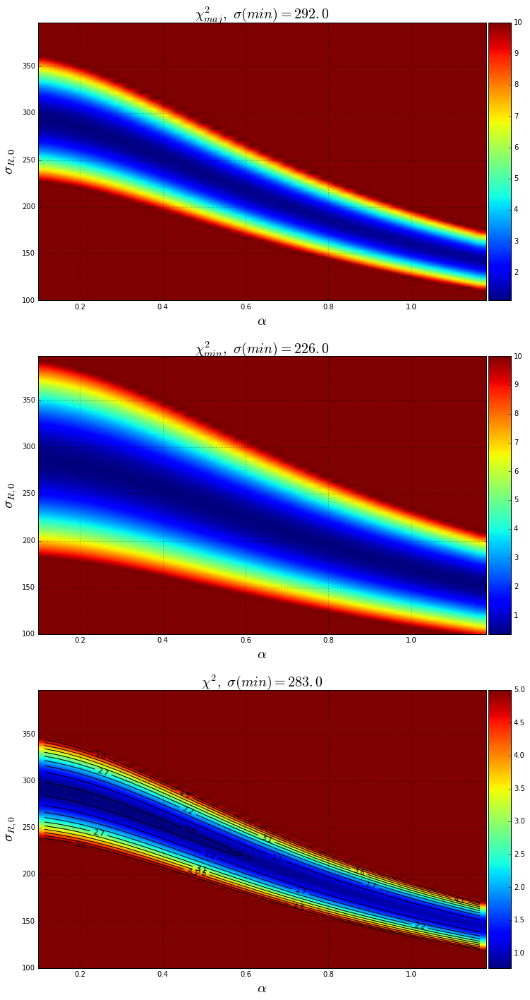

In [95]:
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[12,24])
plot_chi2_map(image_maj, axes[0], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=10.)
plot_chi2_map(image_min, axes[1], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=10.)
corr_image = (image_min*len(sig_min_p) + image_maj*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
print 'N1_maj={},\t N2_min={},\t chi^2_corr[0][0]={} (was {} and {})'.format(len(sig_maj_p), len(sig_min_p), corr_image[0][0], 
                                                                            image_min[0][0], image_maj[0][0])
plot_chi2_map(corr_image, axes[2], log_scale=False, title='$\chi^2$', is_contour=True, vmax=5.)
plt.show()

# 5. r_ef=4.5, sig_R_0=230

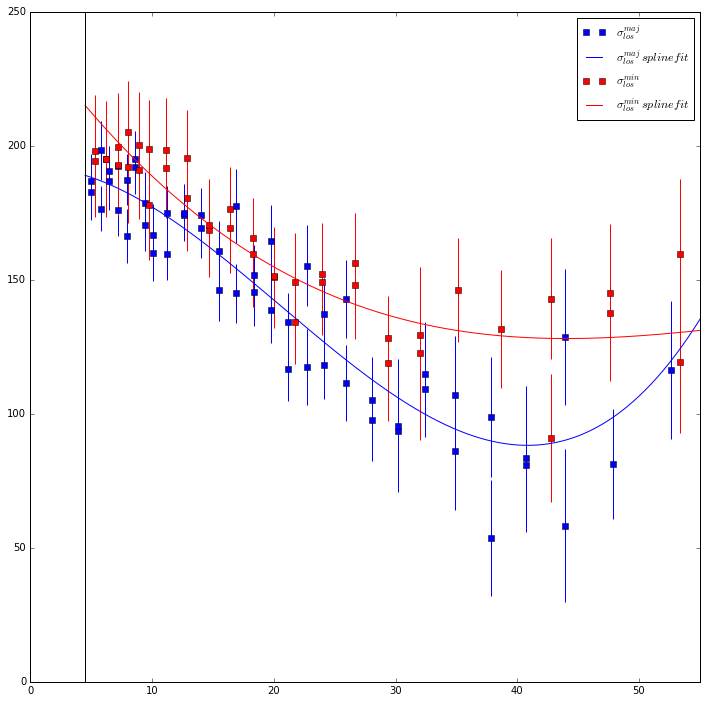

In [96]:
# Граница. по которой обрезаем
cutted = 4.5

sig_maj_data = zip(radii_maj1, sig_maj_p1, e_sig_maj_p1)
sig_maj_data = filter(lambda l: l[0] > cutted, sig_maj_data)
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data) 

sig_min_data = zip(radii_min1, sig_min_p1, e_sig_min_p1)
sig_min_data = filter(lambda l: l[0] > cutted, sig_min_data)
radii_min, sig_min_p, e_sig_min_p = zip(*sig_min_data) 

points = np.arange(cutted, max(radii_min), 0.1)

def w(arr):
    return map(lambda l: 1/(1. + l**2), arr)

spl_maj = inter.UnivariateSpline(radii_maj[::-1], sig_maj_p[::-1], k=3, s=10000., w=w(e_sig_maj_p))
spl_min = inter.UnivariateSpline(radii_min[::-1], sig_min_p[::-1], k=3, s=10000., w=w(e_sig_min_p))

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='.', marker='.', mew=0, color='blue')
plt.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
plt.plot(radii_min, sig_min_p, 's', label='$\sigma_{los}^{min}$', color='red')
plt.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='.', marker='.', mew=0, color='red')
plt.plot(points, spl_min(points), label = '$\sigma_{los}^{min}\, splinefit$', color='red')
plt.axvline(x=cutted, color='black')
plt.legend()
plt.ylim(0,250)
plt.xlim(0,55)
plt.show()

poly_sig_maj = spl_maj
poly_sig_min = spl_min

In [97]:
#Значение sig_los_min в 0
sig_min_0 = 230
print sig_min_0

230


И восстановим профили $\sigma_{los}^{maj}$ и $\sigma_{los}^{min}$. Связь профилей описывается следующими уравнениями: $$\sigma_{los,maj}^2=\sigma_{\varphi}^2\sin^2i+\sigma_Z^2\cos^2i$$ $$\sigma_{los,min}^2=\sigma_R^2\sin^2i+\sigma_Z^2\cos^2i$$

In [98]:
# def sig_maj_exp(R):
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

# def sig_min_exp(R):
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)


cos_i, sin_i = cos(incl * pi / 180), sin(incl * pi / 180)


def sig_maj_exp(R):
    tmp = sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2
    if tmp > 0:
        return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2)
    else:
        return -1000000
#     return sig_R_0*spl_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR(R)**2 * sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

def sig_min_exp(R):
    return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

Теперь то, с чего надо было начинать - построим картинки для разных значений $\alpha$ и $\sigma_{R,0}$. Для того, чтобы найти где минимум, попробуем построить просто двумерные карты $\chi^2$ для разных $\sigma_{R,0}$  $\alpha$: (это очень долго, так что пересчитывать в крайнем случае) 

In [99]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

def compute_chi2_maps(alphas=(), sigmas=()):
    '''Вычисляем все изображения, чтобы потом только настройки менять'''
    image_min = np.random.uniform(size=(len(sigmas), len(alphas)))
    image_maj = np.random.uniform(size=(len(sigmas), len(alphas)))
    image = np.random.uniform(size=(len(sigmas), len(alphas)))
    for i,si in enumerate(sigmas):
        for j,al in enumerate(alphas):
            global alpha, sig_R_0
            alpha = al
            sig_R_0 = si
            sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
            sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
            sqerr_sum = 0.5*sqerr_maj+0.5*sqerr_min
            image[i][j] = sqerr_sum
            image_maj[i][j] = sqerr_maj
            image_min[i][j] = sqerr_min
    return image, image_maj, image_min
    
image, image_maj, image_min = compute_chi2_maps(alphas=alphas, sigmas=sigmas)

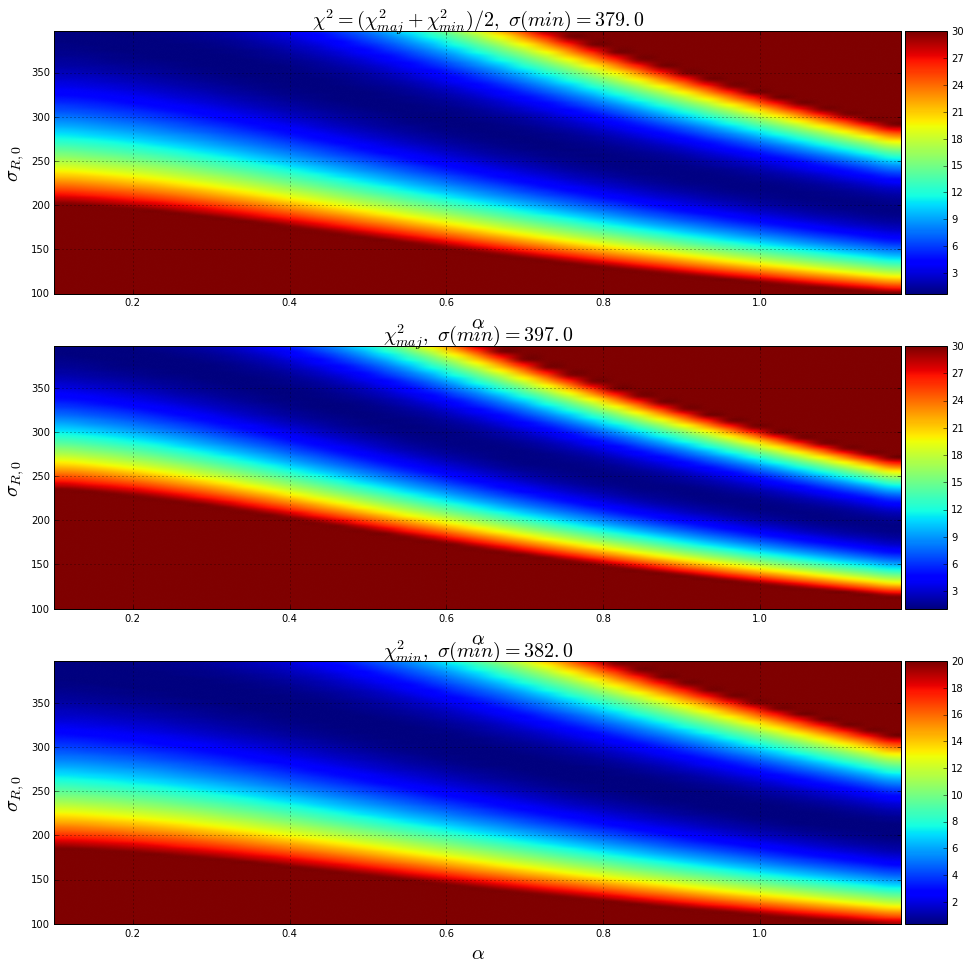

In [100]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_chi2_map(image, ax, log_scale=False, title='$\chi^2$', is_contour=False, vmax=0.):
    '''Рисуем получившиеся карты.
    Colormaps: http://wiki.scipy.org/Cookbook/Matplotlib/Show_colormaps'''
    if image is not None:
        if log_scale:
            image_log = np.apply_along_axis(np.log, 1, image)
            vmax = image_log.max()
        else:
            image_log = image
        if is_contour:
            norm = plt.cm.colors.Normalize(vmax=image.max(), vmin=-image.max())
            cmap = plt.cm.PRGn
            levels = np.concatenate([np.array([image_log.min()*1.1,]), np.linspace(start=image_log.min(), stop=vmax, num=10)])
            levels = sorted(levels)
            cset=ax.contour(image_log, levels, hold='on', colors = 'k', origin='lower', 
                            extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
            ax.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
        im = ax.imshow(image_log, cmap='jet', vmin=image_log.min(), vmax=vmax, interpolation='spline16', 
                   origin="lower", extent=[alphas[0], alphas[-1],sigmas[0],sigmas[-1]], aspect="auto")
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
        min_sigma = sigmas[int(np.where(image == image.min())[0])]        
        ax.set_title(title + '$,\ \sigma(min)=%s$' % min_sigma, size=20.)
        ax.set_ylabel('$\sigma_{R,0}$', size=20.)
        ax.set_xlabel(r'$\alpha$', size=20.)
        ax.grid(True)
 
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[16,16])
plot_chi2_map(image, axes[0], log_scale=False, title='$\chi^2 = (\chi^2_{maj} + \chi^2_{min})/2$', is_contour=False, vmax=30.)
plot_chi2_map(image_maj, axes[1], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=30.)
plot_chi2_map(image_min, axes[2], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=20.)
plt.show()

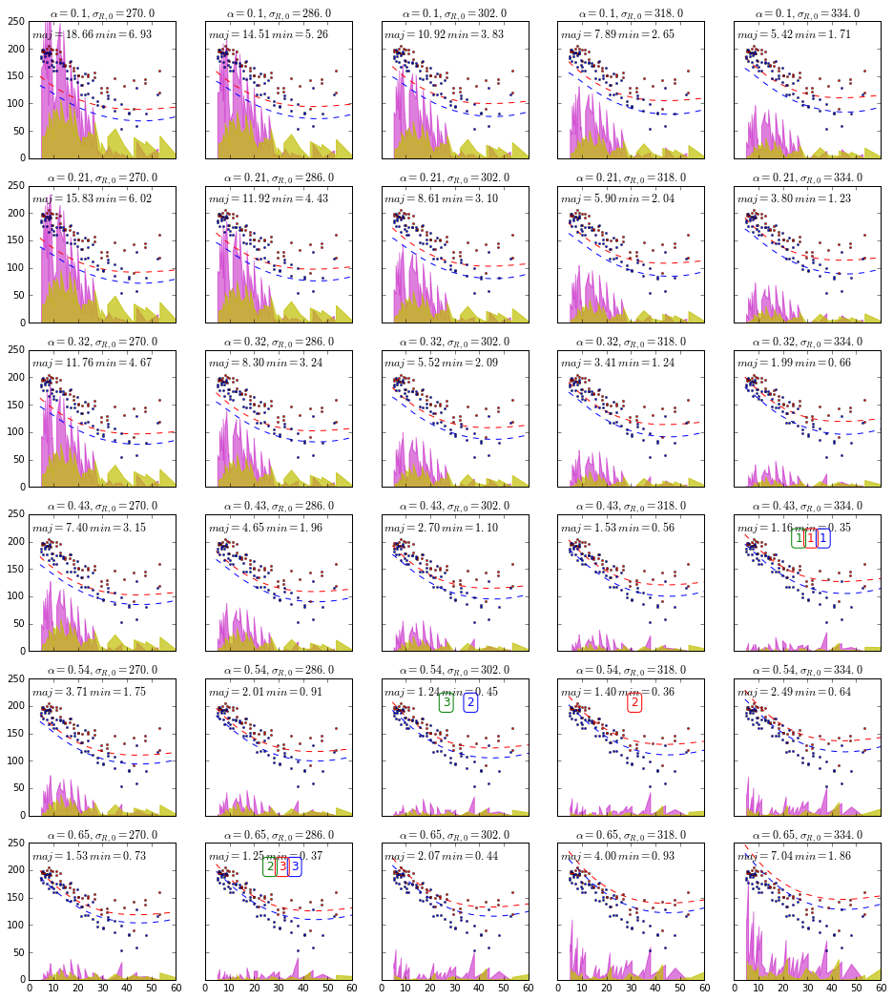

In [101]:
# Перебор alpha
alphas = np.arange(0.1, 0.7, 0.11)

# Перебор sig_R_0
sigmas = np.arange(270., 350., 16.)

# Те картинки, на которые стоит обратить особое внимание
good_pics = []

# def plot_ranges(sigmas_range, alphas_range, good_pics=[], calc_chi=False, best_err=3):
#     '''
#     Для всех предложенных вариантов sigR и alpha
#     рисует графики исходных и восстановленных дисперсий скоростей los.
#     Если calc_chi = True, то также считает ошибку по наблюдаемым точкам.
#     Если ошибка считается, то отмечаются best_err лучших (наименьших) результата.
#     Синий - для большой оси, красный - малой, зеленый - полусумма.
#     Изменяет глобальные значения sig_R_0 и alpha!'''
#     nrows = alphas.size
#     ncols = sigmas.size
#     fig, axes = plt.subplots(nrows=nrows, ncols=ncols, sharex=True, sharey=True, figsize=[16,12])
#     plt_index = 0
#     # Последнее - среднее геометрическое
#     sqerr_majs, sqerr_mins, sqerr_mean = [],[],[]
#     for al in alphas_range:
#         for si in sigmas_range:
#             global alpha, sig_R_0
#             alpha = al
#             sig_R_0 = si
#             ax = axes[plt_index/ncols, plt_index % ncols]
#             ax.set_title(r'$\alpha = %s, \sigma_{R,0}=%s$' % (al,si))
#             ax.plot(points, poly_sig_maj(points), '-', color='blue')
#             ax.plot(points, [sig_maj_exp(Rr) for Rr in points], '--', color='blue')
#             ax.plot(points, poly_sig_min(points), '-', color='red')
#             ax.plot(points, [sig_min_exp(R) for R in points], '--', color='red')
#             if calc_chi:
#                 sqerr_maj = sum(power([sig_maj_exp(p[0]) - p[1] for p in sig_maj_data], 2))/len(sig_maj_data)
#                 sqerr_min = sum(power([sig_min_exp(p[0]) - p[1] for p in sig_min_data], 2))/len(sig_min_data)
#                 ax.text(1, 5, "$\chi^2_{maj}=%5.0f\, \chi^2_{min}=%5.0f$" % (sqerr_maj, sqerr_min), fontsize=12)
#                 sqerr_majs.append(sqerr_maj);sqerr_mins.append(sqerr_min)
#                 sqerr_mean.append(0.5*sqerr_maj+0.5*sqerr_min)
#             ax.set_ylim(0, 250)
#             ax.set_xlim(0, 50)
#             if (plt_index/ncols, plt_index % ncols) in good_pics:
#                 ax.plot([40], [200], 'o', markersize=12., color=(0.2,1.0,0.))
#             plt_index = plt_index + 1
#     if calc_chi:
#         best_maj_err = heapq.nsmallest(best_err, sqerr_majs)
#         for b_maj in best_maj_err:
#             b_maj_ind = sqerr_majs.index(b_maj)
#             ax = axes[b_maj_ind/ncols, b_maj_ind % ncols]
#             #ax.plot([35], [200], 'o', markersize=12., color='b')
#             ax.text(35, 200, "%s" % (best_maj_err.index(b_maj)+1), fontsize=12, color='b', 
#                     bbox=dict(facecolor='none', edgecolor='b', boxstyle='round'))
#         best_min_err = heapq.nsmallest(best_err, sqerr_mins)
#         for b_min in best_min_err:
#             b_min_ind = sqerr_mins.index(b_min)
#             ax = axes[b_min_ind/ncols, b_min_ind % ncols]
#             #ax.plot([30], [200], 'o', markersize=12., color='r')
#             ax.text(30, 200, "%s" % (best_min_err.index(b_min)+1), fontsize=12, color='r', 
#                     bbox=dict(facecolor='none', edgecolor='r', boxstyle='round'))
#         best_mean_err = heapq.nsmallest(best_err, sqerr_mean)
#         for b_mean in best_mean_err:
#             b_mean_ind = sqerr_mean.index(b_mean)
#             ax = axes[b_mean_ind/ncols, b_mean_ind % ncols]
#             ax.text(25, 200, "%s" % (best_mean_err.index(b_mean)+1), fontsize=12, color='g', 
#                     bbox=dict(facecolor='none', edgecolor='g', boxstyle='round'))

plot_ranges(sigmas, alphas, good_pics=good_pics, calc_chi=True)
plt.show()

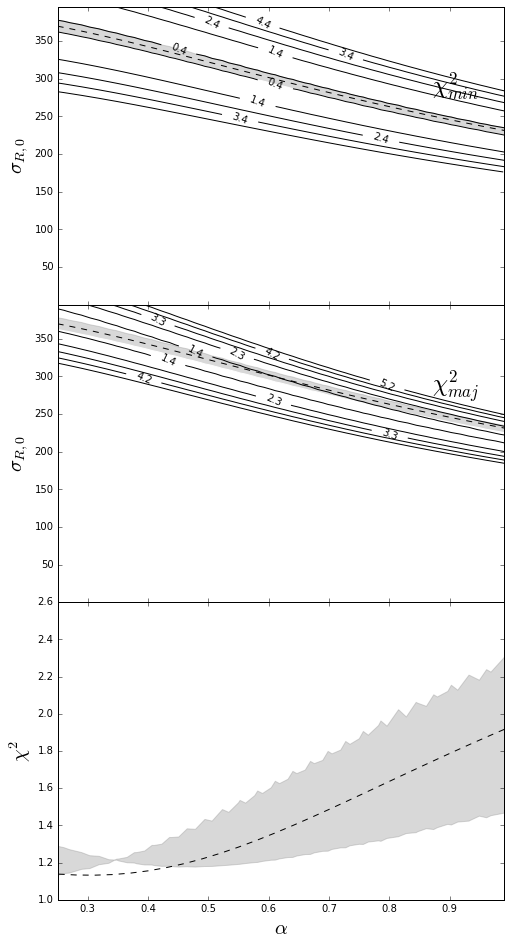

In [102]:
main_slice = lambda l: sig_min_0/sqrt(sin_i**2 + cos_i**2 * l**2)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

# os.chdir("C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\paper1\\text\\imgs")

alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
# levels = np.linspace(start=image_min.min(), stop=20., num=5)
# levels = [100., 125., 150., 175., 200.]
# levels = [image_min.min()+0.02, image_min.min()+0.4, image_min.min()+1.1, image_min.min()+2., 
#           image_min.min()+3.1, image_min.min()+4.1]
# levels = np.linspace(start=image_min.min()+0.1, stop=image_min.min()+4.1, num=5)
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
# im = ax.imshow(image_min, cmap='jet', vmin=image_min.min(), vmax=20., interpolation='spline16', 
#                    origin="lower", aspect="auto")
# plt.show()
cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()
v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
# ax.set_ylim(180, 300)
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')

ax = axes[1]
# levels = np.linspace(start=image_maj.min()-4.3, stop=10., num=10)
# levels = [7., 10., 50., 100.]
# levels = [image_maj.min()+0.2, image_maj.min()+0.7, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = np.linspace(start=image_maj.min()+0.3, stop=image_maj.min()+4.1, num=5)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')

ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
# ax.set_ylim(150, 320)

ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)


ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

# ax.set_ylim(3.1, 3.5)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)

plt.show()

N1_maj=54,	 N2_min=44,	 chi^2_corr[0][0]=71.3797290547 (was 39.7623152833 and 97.1420662018)


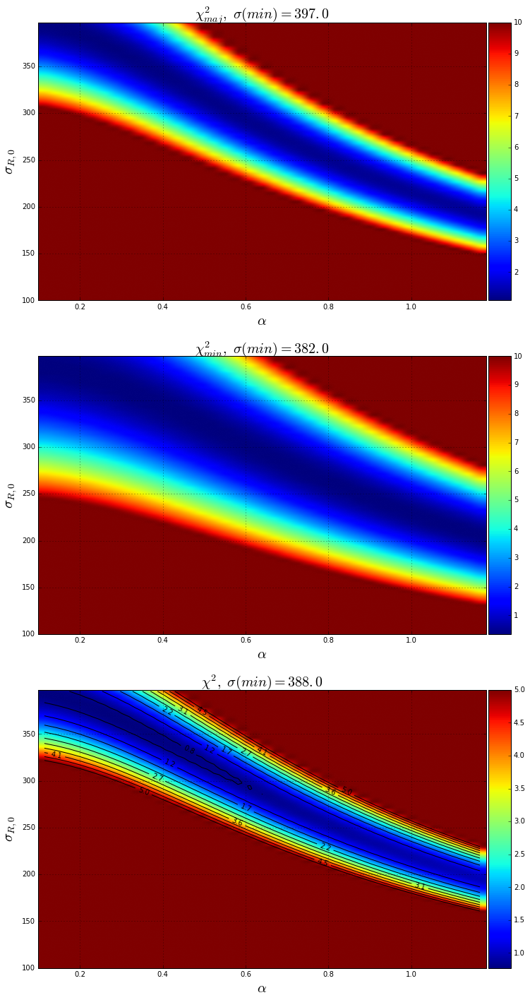

In [103]:
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[12,24])
plot_chi2_map(image_maj, axes[0], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=10.)
plot_chi2_map(image_min, axes[1], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=10.)
corr_image = (image_min*len(sig_min_p) + image_maj*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
print 'N1_maj={},\t N2_min={},\t chi^2_corr[0][0]={} (was {} and {})'.format(len(sig_maj_p), len(sig_min_p), corr_image[0][0], 
                                                                            image_min[0][0], image_maj[0][0])
plot_chi2_map(corr_image, axes[2], log_scale=False, title='$\chi^2$', is_contour=True, vmax=5.)
plt.show()

# 6. r_ef=2.5, sig_R_0=spline(0)

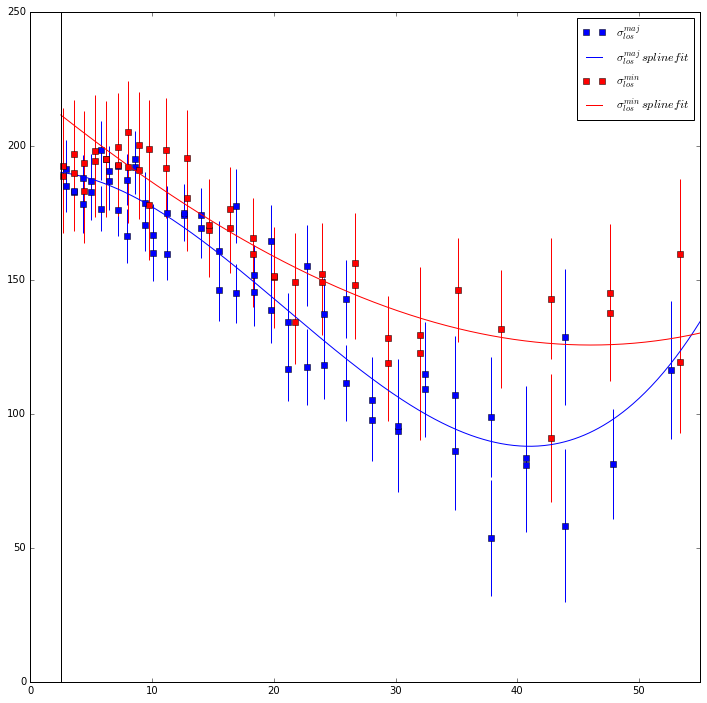

In [104]:
# Граница. по которой обрезаем
cutted = 2.5

sig_maj_data = zip(radii_maj1, sig_maj_p1, e_sig_maj_p1)
sig_maj_data = filter(lambda l: l[0] > cutted, sig_maj_data)
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data) 

sig_min_data = zip(radii_min1, sig_min_p1, e_sig_min_p1)
sig_min_data = filter(lambda l: l[0] > cutted, sig_min_data)
radii_min, sig_min_p, e_sig_min_p = zip(*sig_min_data) 

points = np.arange(cutted, max(radii_min), 0.1)

def w(arr):
    return map(lambda l: 1/(1. + l**2), arr)

spl_maj = inter.UnivariateSpline(radii_maj[::-1], sig_maj_p[::-1], k=3, s=10000., w=w(e_sig_maj_p))
spl_min = inter.UnivariateSpline(radii_min[::-1], sig_min_p[::-1], k=3, s=10000., w=w(e_sig_min_p))

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='.', marker='.', mew=0, color='blue')
plt.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
plt.plot(radii_min, sig_min_p, 's', label='$\sigma_{los}^{min}$', color='red')
plt.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='.', marker='.', mew=0, color='red')
plt.plot(points, spl_min(points), label = '$\sigma_{los}^{min}\, splinefit$', color='red')
plt.axvline(x=cutted, color='black')
plt.legend()
plt.ylim(0,250)
plt.xlim(0,55)
plt.show()

poly_sig_maj = spl_maj
poly_sig_min = spl_min

In [105]:
#Значение sig_los_min в 0
sig_min_0 = poly_sig_min(0)
print sig_min_0

220.744659815


И восстановим профили $\sigma_{los}^{maj}$ и $\sigma_{los}^{min}$. Связь профилей описывается следующими уравнениями: $$\sigma_{los,maj}^2=\sigma_{\varphi}^2\sin^2i+\sigma_Z^2\cos^2i$$ $$\sigma_{los,min}^2=\sigma_R^2\sin^2i+\sigma_Z^2\cos^2i$$

In [106]:
# def sig_maj_exp(R):
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

# def sig_min_exp(R):
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)


cos_i, sin_i = cos(incl * pi / 180), sin(incl * pi / 180)


def sig_maj_exp(R):
    tmp = sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2
    if tmp > 0:
        return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2)
    else:
        return -1000000
#     return sig_R_0*spl_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR(R)**2 * sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

def sig_min_exp(R):
    return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

Теперь то, с чего надо было начинать - построим картинки для разных значений $\alpha$ и $\sigma_{R,0}$. Для того, чтобы найти где минимум, попробуем построить просто двумерные карты $\chi^2$ для разных $\sigma_{R,0}$  $\alpha$: (это очень долго, так что пересчитывать в крайнем случае) 

In [107]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

def compute_chi2_maps(alphas=(), sigmas=()):
    '''Вычисляем все изображения, чтобы потом только настройки менять'''
    image_min = np.random.uniform(size=(len(sigmas), len(alphas)))
    image_maj = np.random.uniform(size=(len(sigmas), len(alphas)))
    image = np.random.uniform(size=(len(sigmas), len(alphas)))
    for i,si in enumerate(sigmas):
        for j,al in enumerate(alphas):
            global alpha, sig_R_0
            alpha = al
            sig_R_0 = si
            sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
            sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
            sqerr_sum = 0.5*sqerr_maj+0.5*sqerr_min
            image[i][j] = sqerr_sum
            image_maj[i][j] = sqerr_maj
            image_min[i][j] = sqerr_min
    return image, image_maj, image_min
    
image, image_maj, image_min = compute_chi2_maps(alphas=alphas, sigmas=sigmas)

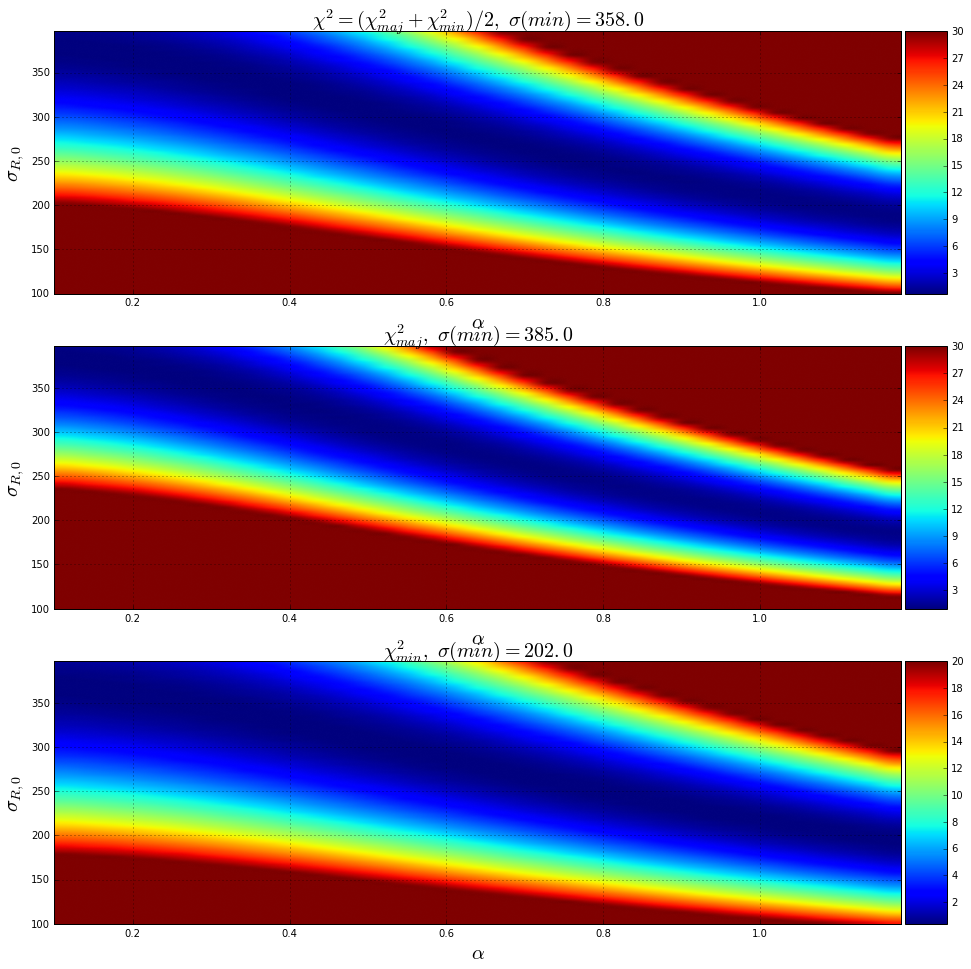

In [108]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_chi2_map(image, ax, log_scale=False, title='$\chi^2$', is_contour=False, vmax=0.):
    '''Рисуем получившиеся карты.
    Colormaps: http://wiki.scipy.org/Cookbook/Matplotlib/Show_colormaps'''
    if image is not None:
        if log_scale:
            image_log = np.apply_along_axis(np.log, 1, image)
            vmax = image_log.max()
        else:
            image_log = image
        if is_contour:
            norm = plt.cm.colors.Normalize(vmax=image.max(), vmin=-image.max())
            cmap = plt.cm.PRGn
            levels = np.concatenate([np.array([image_log.min()*1.1,]), np.linspace(start=image_log.min(), stop=vmax, num=10)])
            levels = sorted(levels)
            cset=ax.contour(image_log, levels, hold='on', colors = 'k', origin='lower', 
                            extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
            ax.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
        im = ax.imshow(image_log, cmap='jet', vmin=image_log.min(), vmax=vmax, interpolation='spline16', 
                   origin="lower", extent=[alphas[0], alphas[-1],sigmas[0],sigmas[-1]], aspect="auto")
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
        min_sigma = sigmas[int(np.where(image == image.min())[0])]        
        ax.set_title(title + '$,\ \sigma(min)=%s$' % min_sigma, size=20.)
        ax.set_ylabel('$\sigma_{R,0}$', size=20.)
        ax.set_xlabel(r'$\alpha$', size=20.)
        ax.grid(True)
 
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[16,16])
plot_chi2_map(image, axes[0], log_scale=False, title='$\chi^2 = (\chi^2_{maj} + \chi^2_{min})/2$', is_contour=False, vmax=30.)
plot_chi2_map(image_maj, axes[1], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=30.)
plot_chi2_map(image_min, axes[2], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=20.)
plt.show()

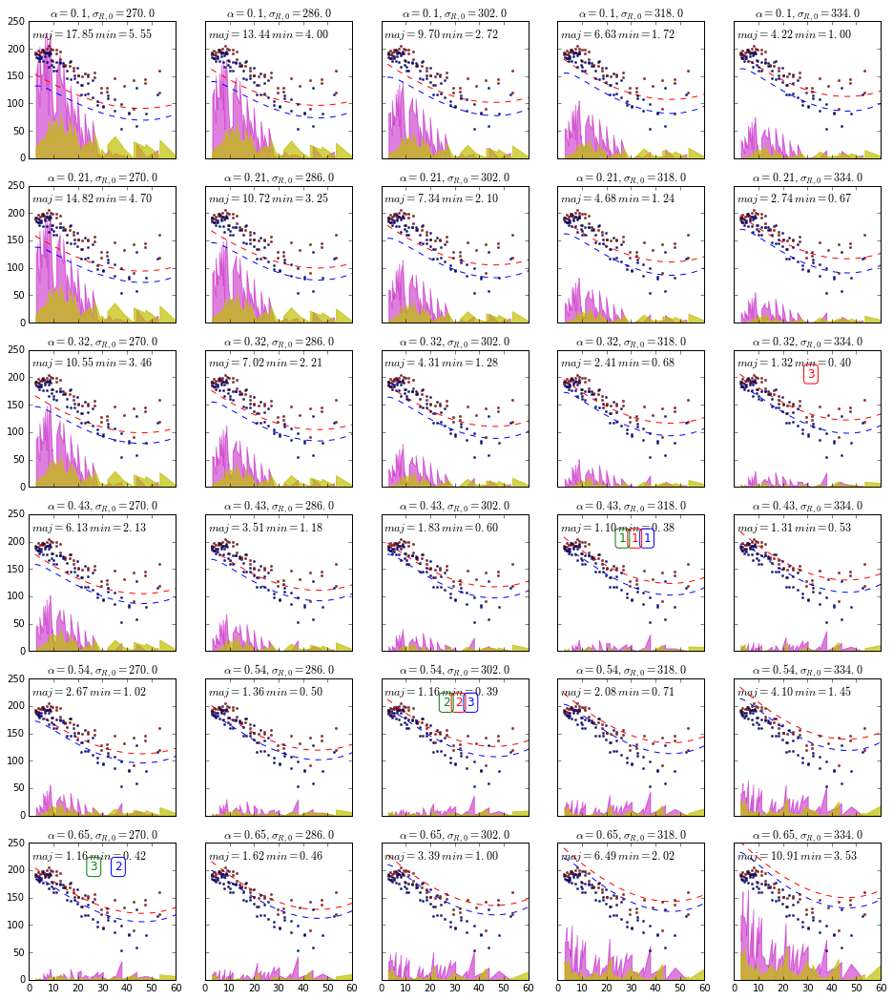

In [109]:
# Перебор alpha
alphas = np.arange(0.1, 0.7, 0.11)

# Перебор sig_R_0
sigmas = np.arange(270., 350., 16.)

# Те картинки, на которые стоит обратить особое внимание
good_pics = []

# def plot_ranges(sigmas_range, alphas_range, good_pics=[], calc_chi=False, best_err=3):
#     '''
#     Для всех предложенных вариантов sigR и alpha
#     рисует графики исходных и восстановленных дисперсий скоростей los.
#     Если calc_chi = True, то также считает ошибку по наблюдаемым точкам.
#     Если ошибка считается, то отмечаются best_err лучших (наименьших) результата.
#     Синий - для большой оси, красный - малой, зеленый - полусумма.
#     Изменяет глобальные значения sig_R_0 и alpha!'''
#     nrows = alphas.size
#     ncols = sigmas.size
#     fig, axes = plt.subplots(nrows=nrows, ncols=ncols, sharex=True, sharey=True, figsize=[16,12])
#     plt_index = 0
#     # Последнее - среднее геометрическое
#     sqerr_majs, sqerr_mins, sqerr_mean = [],[],[]
#     for al in alphas_range:
#         for si in sigmas_range:
#             global alpha, sig_R_0
#             alpha = al
#             sig_R_0 = si
#             ax = axes[plt_index/ncols, plt_index % ncols]
#             ax.set_title(r'$\alpha = %s, \sigma_{R,0}=%s$' % (al,si))
#             ax.plot(points, poly_sig_maj(points), '-', color='blue')
#             ax.plot(points, [sig_maj_exp(Rr) for Rr in points], '--', color='blue')
#             ax.plot(points, poly_sig_min(points), '-', color='red')
#             ax.plot(points, [sig_min_exp(R) for R in points], '--', color='red')
#             if calc_chi:
#                 sqerr_maj = sum(power([sig_maj_exp(p[0]) - p[1] for p in sig_maj_data], 2))/len(sig_maj_data)
#                 sqerr_min = sum(power([sig_min_exp(p[0]) - p[1] for p in sig_min_data], 2))/len(sig_min_data)
#                 ax.text(1, 5, "$\chi^2_{maj}=%5.0f\, \chi^2_{min}=%5.0f$" % (sqerr_maj, sqerr_min), fontsize=12)
#                 sqerr_majs.append(sqerr_maj);sqerr_mins.append(sqerr_min)
#                 sqerr_mean.append(0.5*sqerr_maj+0.5*sqerr_min)
#             ax.set_ylim(0, 250)
#             ax.set_xlim(0, 50)
#             if (plt_index/ncols, plt_index % ncols) in good_pics:
#                 ax.plot([40], [200], 'o', markersize=12., color=(0.2,1.0,0.))
#             plt_index = plt_index + 1
#     if calc_chi:
#         best_maj_err = heapq.nsmallest(best_err, sqerr_majs)
#         for b_maj in best_maj_err:
#             b_maj_ind = sqerr_majs.index(b_maj)
#             ax = axes[b_maj_ind/ncols, b_maj_ind % ncols]
#             #ax.plot([35], [200], 'o', markersize=12., color='b')
#             ax.text(35, 200, "%s" % (best_maj_err.index(b_maj)+1), fontsize=12, color='b', 
#                     bbox=dict(facecolor='none', edgecolor='b', boxstyle='round'))
#         best_min_err = heapq.nsmallest(best_err, sqerr_mins)
#         for b_min in best_min_err:
#             b_min_ind = sqerr_mins.index(b_min)
#             ax = axes[b_min_ind/ncols, b_min_ind % ncols]
#             #ax.plot([30], [200], 'o', markersize=12., color='r')
#             ax.text(30, 200, "%s" % (best_min_err.index(b_min)+1), fontsize=12, color='r', 
#                     bbox=dict(facecolor='none', edgecolor='r', boxstyle='round'))
#         best_mean_err = heapq.nsmallest(best_err, sqerr_mean)
#         for b_mean in best_mean_err:
#             b_mean_ind = sqerr_mean.index(b_mean)
#             ax = axes[b_mean_ind/ncols, b_mean_ind % ncols]
#             ax.text(25, 200, "%s" % (best_mean_err.index(b_mean)+1), fontsize=12, color='g', 
#                     bbox=dict(facecolor='none', edgecolor='g', boxstyle='round'))

plot_ranges(sigmas, alphas, good_pics=good_pics, calc_chi=True)
plt.show()

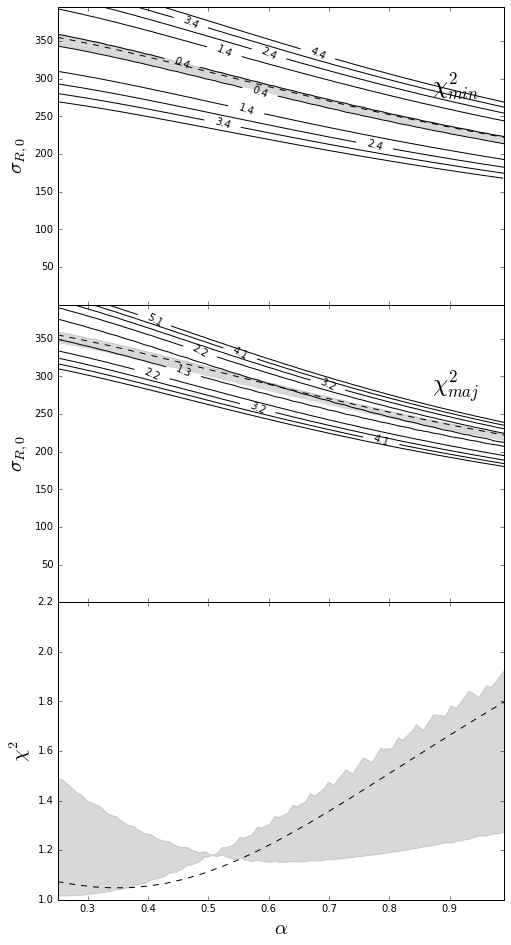

In [110]:
main_slice = lambda l: sig_min_0/sqrt(sin_i**2 + cos_i**2 * l**2)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

# os.chdir("C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\paper1\\text\\imgs")

alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
# levels = np.linspace(start=image_min.min(), stop=20., num=5)
# levels = [100., 125., 150., 175., 200.]
# levels = [image_min.min()+0.02, image_min.min()+0.4, image_min.min()+1.1, image_min.min()+2., 
#           image_min.min()+3.1, image_min.min()+4.1]
# levels = np.linspace(start=image_min.min()+0.1, stop=image_min.min()+4.1, num=5)
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
# im = ax.imshow(image_min, cmap='jet', vmin=image_min.min(), vmax=20., interpolation='spline16', 
#                    origin="lower", aspect="auto")
# plt.show()
cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()
v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
# ax.set_ylim(180, 300)
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')

ax = axes[1]
# levels = np.linspace(start=image_maj.min()-4.3, stop=10., num=10)
# levels = [7., 10., 50., 100.]
# levels = [image_maj.min()+0.2, image_maj.min()+0.7, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = np.linspace(start=image_maj.min()+0.3, stop=image_maj.min()+4.1, num=5)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')

ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
# ax.set_ylim(150, 320)

ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)


ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

# ax.set_ylim(3.1, 3.5)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)

plt.show()

N1_maj=60,	 N2_min=50,	 chi^2_corr[0][0]=75.4721304269 (was 39.2145970579 and 105.686741568)


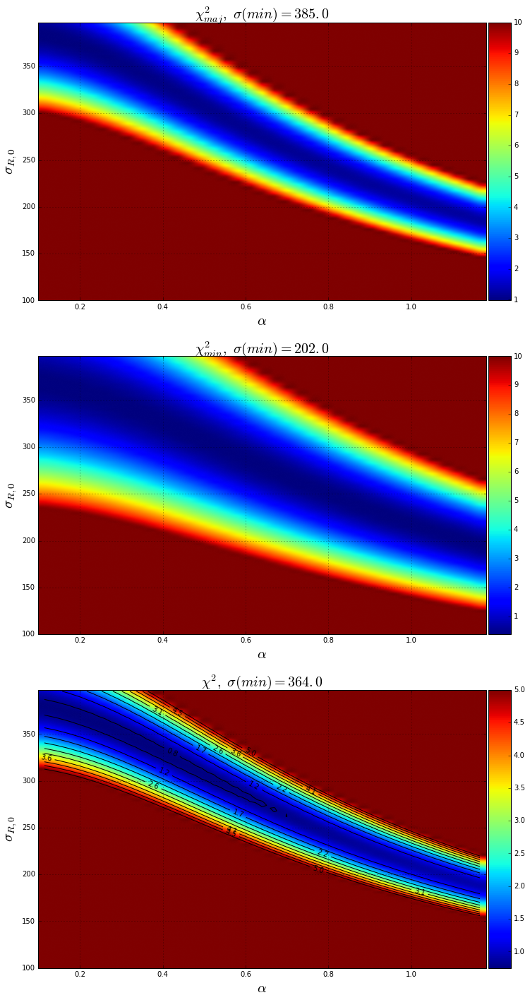

In [111]:
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[12,24])
plot_chi2_map(image_maj, axes[0], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=10.)
plot_chi2_map(image_min, axes[1], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=10.)
corr_image = (image_min*len(sig_min_p) + image_maj*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
print 'N1_maj={},\t N2_min={},\t chi^2_corr[0][0]={} (was {} and {})'.format(len(sig_maj_p), len(sig_min_p), corr_image[0][0], 
                                                                            image_min[0][0], image_maj[0][0])
plot_chi2_map(corr_image, axes[2], log_scale=False, title='$\chi^2$', is_contour=True, vmax=5.)
plt.show()

# 8. r_ef=15., sig_R_0=spline(cutted)

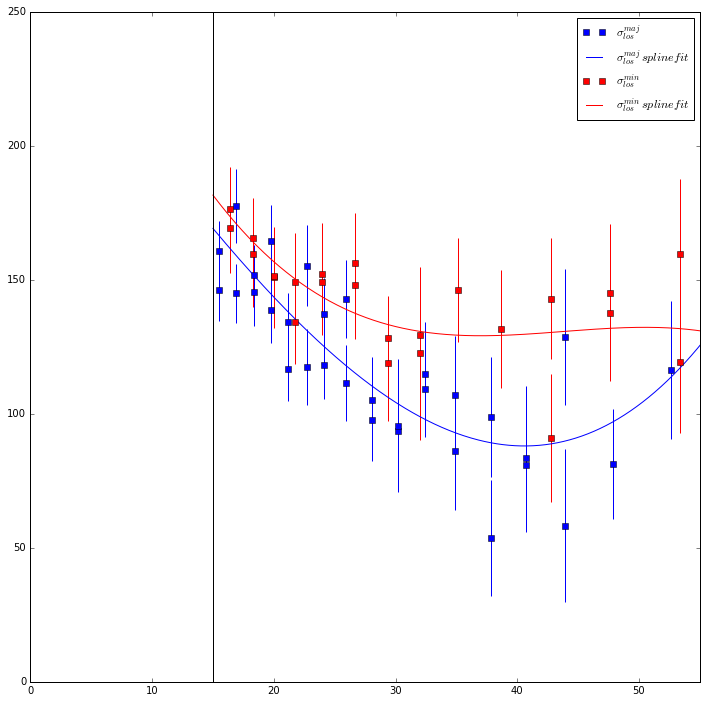

In [112]:
# Граница. по которой обрезаем
cutted = 15.0

sig_maj_data = zip(radii_maj1, sig_maj_p1, e_sig_maj_p1)
sig_maj_data = filter(lambda l: l[0] > cutted, sig_maj_data)
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data) 

sig_min_data = zip(radii_min1, sig_min_p1, e_sig_min_p1)
sig_min_data = filter(lambda l: l[0] > cutted, sig_min_data)
radii_min, sig_min_p, e_sig_min_p = zip(*sig_min_data) 

points = np.arange(cutted, max(radii_min), 0.1)

def w(arr):
    return map(lambda l: 1/(1. + l**2), arr)

spl_maj = inter.UnivariateSpline(radii_maj[::-1], sig_maj_p[::-1], k=3, s=10000., w=w(e_sig_maj_p))
spl_min = inter.UnivariateSpline(radii_min[::-1], sig_min_p[::-1], k=3, s=10000., w=w(e_sig_min_p))

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='.', marker='.', mew=0, color='blue')
plt.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
plt.plot(radii_min, sig_min_p, 's', label='$\sigma_{los}^{min}$', color='red')
plt.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='.', marker='.', mew=0, color='red')
plt.plot(points, spl_min(points), label = '$\sigma_{los}^{min}\, splinefit$', color='red')
plt.axvline(x=cutted, color='black')
plt.legend()
plt.ylim(0,250)
plt.xlim(0,55)
plt.show()

poly_sig_maj = spl_maj
poly_sig_min = spl_min

In [113]:
#Значение sig_los_min в 0
sig_min_0 = poly_sig_min(cutted)
print sig_min_0

181.711704128


И восстановим профили $\sigma_{los}^{maj}$ и $\sigma_{los}^{min}$. Связь профилей описывается следующими уравнениями: $$\sigma_{los,maj}^2=\sigma_{\varphi}^2\sin^2i+\sigma_Z^2\cos^2i$$ $$\sigma_{los,min}^2=\sigma_R^2\sin^2i+\sigma_Z^2\cos^2i$$

In [114]:
# def sig_maj_exp(R):
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

# def sig_min_exp(R):
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)


cos_i, sin_i = cos(incl * pi / 180), sin(incl * pi / 180)


def sig_maj_exp(R):
    tmp = sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2
    if tmp > 0:
        return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR_real(R) * sin_i**2 + alpha**2 * cos_i**2)
    else:
        return -1000000
#     return sig_R_0*spl_min(R)/sig_min_0 * sqrt(sigPhi_to_sigR(R)**2 * sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigPhi_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

def sig_min_exp(R):
    return sig_R_0*poly_sig_min(R)/sig_min_0 * sqrt(sin_i**2 + alpha**2 * cos_i**2)
#     return sqrt(sigR_exp(R)**2 * sin(incl*pi/180)**2 + sigZ_exp(R)**2 * cos(incl*pi/180)**2)

Теперь то, с чего надо было начинать - построим картинки для разных значений $\alpha$ и $\sigma_{R,0}$. Для того, чтобы найти где минимум, попробуем построить просто двумерные карты $\chi^2$ для разных $\sigma_{R,0}$  $\alpha$: (это очень долго, так что пересчитывать в крайнем случае) 

In [115]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

def compute_chi2_maps(alphas=(), sigmas=()):
    '''Вычисляем все изображения, чтобы потом только настройки менять'''
    image_min = np.random.uniform(size=(len(sigmas), len(alphas)))
    image_maj = np.random.uniform(size=(len(sigmas), len(alphas)))
    image = np.random.uniform(size=(len(sigmas), len(alphas)))
    for i,si in enumerate(sigmas):
        for j,al in enumerate(alphas):
            global alpha, sig_R_0
            alpha = al
            sig_R_0 = si
            sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
            sqerr_min = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
            sqerr_sum = 0.5*sqerr_maj+0.5*sqerr_min
            image[i][j] = sqerr_sum
            image_maj[i][j] = sqerr_maj
            image_min[i][j] = sqerr_min
    return image, image_maj, image_min
    
image, image_maj, image_min = compute_chi2_maps(alphas=alphas, sigmas=sigmas)

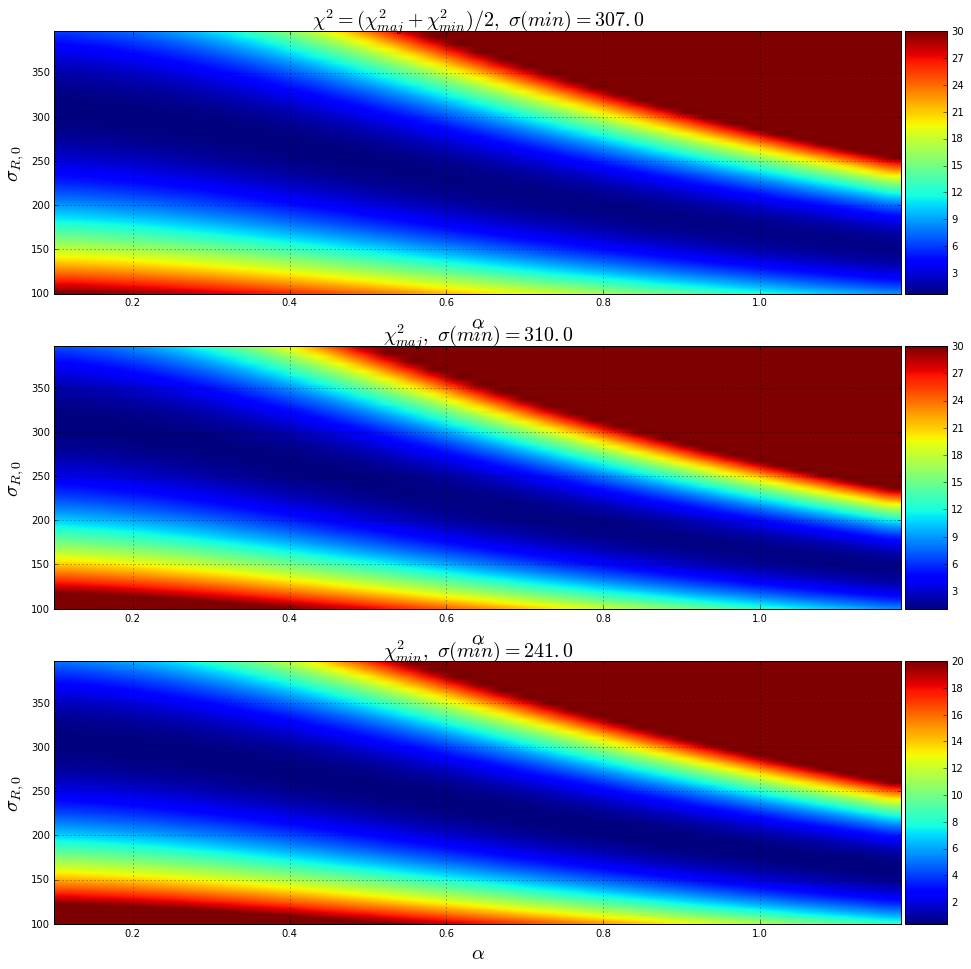

In [116]:
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_chi2_map(image, ax, log_scale=False, title='$\chi^2$', is_contour=False, vmax=0.):
    '''Рисуем получившиеся карты.
    Colormaps: http://wiki.scipy.org/Cookbook/Matplotlib/Show_colormaps'''
    if image is not None:
        if log_scale:
            image_log = np.apply_along_axis(np.log, 1, image)
            vmax = image_log.max()
        else:
            image_log = image
        if is_contour:
            norm = plt.cm.colors.Normalize(vmax=image.max(), vmin=-image.max())
            cmap = plt.cm.PRGn
            levels = np.concatenate([np.array([image_log.min()*1.1,]), np.linspace(start=image_log.min(), stop=vmax, num=10)])
            levels = sorted(levels)
            cset=ax.contour(image_log, levels, hold='on', colors = 'k', origin='lower', 
                            extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
            ax.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
        im = ax.imshow(image_log, cmap='jet', vmin=image_log.min(), vmax=vmax, interpolation='spline16', 
                   origin="lower", extent=[alphas[0], alphas[-1],sigmas[0],sigmas[-1]], aspect="auto")
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(im, cax=cax)
        min_sigma = sigmas[int(np.where(image == image.min())[0])]        
        ax.set_title(title + '$,\ \sigma(min)=%s$' % min_sigma, size=20.)
        ax.set_ylabel('$\sigma_{R,0}$', size=20.)
        ax.set_xlabel(r'$\alpha$', size=20.)
        ax.grid(True)
 
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[16,16])
plot_chi2_map(image, axes[0], log_scale=False, title='$\chi^2 = (\chi^2_{maj} + \chi^2_{min})/2$', is_contour=False, vmax=30.)
plot_chi2_map(image_maj, axes[1], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=30.)
plot_chi2_map(image_min, axes[2], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=20.)
plt.show()

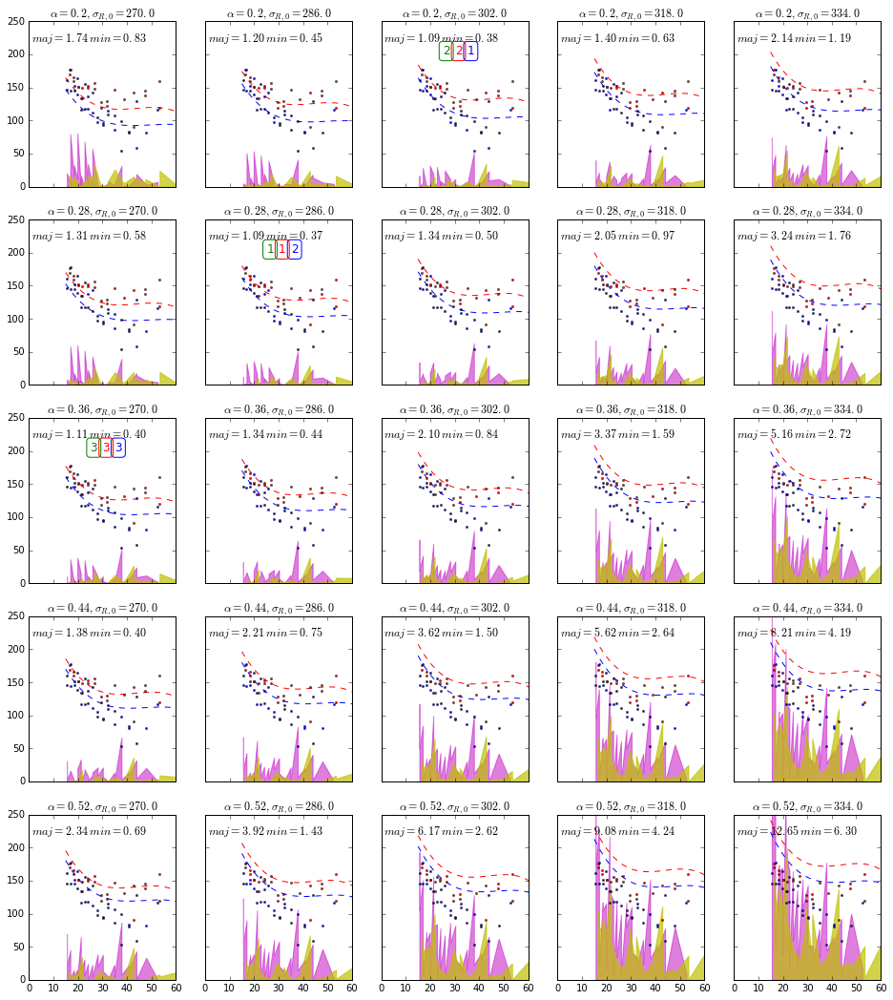

In [117]:
# Перебор alpha
alphas = np.arange(0.2, 0.6, 0.08)

# Перебор sig_R_0
sigmas = np.arange(270., 350., 16.)

# Те картинки, на которые стоит обратить особое внимание
good_pics = []

# def plot_ranges(sigmas_range, alphas_range, good_pics=[], calc_chi=False, best_err=3):
#     '''
#     Для всех предложенных вариантов sigR и alpha
#     рисует графики исходных и восстановленных дисперсий скоростей los.
#     Если calc_chi = True, то также считает ошибку по наблюдаемым точкам.
#     Если ошибка считается, то отмечаются best_err лучших (наименьших) результата.
#     Синий - для большой оси, красный - малой, зеленый - полусумма.
#     Изменяет глобальные значения sig_R_0 и alpha!'''
#     nrows = alphas.size
#     ncols = sigmas.size
#     fig, axes = plt.subplots(nrows=nrows, ncols=ncols, sharex=True, sharey=True, figsize=[16,12])
#     plt_index = 0
#     # Последнее - среднее геометрическое
#     sqerr_majs, sqerr_mins, sqerr_mean = [],[],[]
#     for al in alphas_range:
#         for si in sigmas_range:
#             global alpha, sig_R_0
#             alpha = al
#             sig_R_0 = si
#             ax = axes[plt_index/ncols, plt_index % ncols]
#             ax.set_title(r'$\alpha = %s, \sigma_{R,0}=%s$' % (al,si))
#             ax.plot(points, poly_sig_maj(points), '-', color='blue')
#             ax.plot(points, [sig_maj_exp(Rr) for Rr in points], '--', color='blue')
#             ax.plot(points, poly_sig_min(points), '-', color='red')
#             ax.plot(points, [sig_min_exp(R) for R in points], '--', color='red')
            
#             ax.plot(radii_min, sig_min_p, 's', color='red', ms=1)
#             ax.plot(radii_maj, sig_maj_p, 's', color='blue', ms=1)
            
#             if calc_chi:
#                 sqerr_maj = sum(power([sig_maj_exp(p[0]) - p[1] for p in sig_maj_data], 2))/len(sig_maj_data)
#                 sqerr_min = sum(power([sig_min_exp(p[0]) - p[1] for p in sig_min_data], 2))/len(sig_min_data)
#                 ax.text(1, 5, "$\chi^2_{maj}=%5.0f\, \chi^2_{min}=%5.0f$" % (sqerr_maj, sqerr_min), fontsize=12)
#                 sqerr_majs.append(sqerr_maj);sqerr_mins.append(sqerr_min)
#                 sqerr_mean.append(0.5*sqerr_maj+0.5*sqerr_min)
#             ax.set_ylim(0, 250)
#             ax.set_xlim(0, 50)
#             if (plt_index/ncols, plt_index % ncols) in good_pics:
#                 ax.plot([40], [200], 'o', markersize=12., color=(0.2,1.0,0.))
#             plt_index = plt_index + 1
#     if calc_chi:
#         best_maj_err = heapq.nsmallest(best_err, sqerr_majs)
#         for b_maj in best_maj_err:
#             b_maj_ind = sqerr_majs.index(b_maj)
#             ax = axes[b_maj_ind/ncols, b_maj_ind % ncols]
#             #ax.plot([35], [200], 'o', markersize=12., color='b')
#             ax.text(35, 200, "%s" % (best_maj_err.index(b_maj)+1), fontsize=12, color='b', 
#                     bbox=dict(facecolor='none', edgecolor='b', boxstyle='round'))
#         best_min_err = heapq.nsmallest(best_err, sqerr_mins)
#         for b_min in best_min_err:
#             b_min_ind = sqerr_mins.index(b_min)
#             ax = axes[b_min_ind/ncols, b_min_ind % ncols]
#             #ax.plot([30], [200], 'o', markersize=12., color='r')
#             ax.text(30, 200, "%s" % (best_min_err.index(b_min)+1), fontsize=12, color='r', 
#                     bbox=dict(facecolor='none', edgecolor='r', boxstyle='round'))
#         best_mean_err = heapq.nsmallest(best_err, sqerr_mean)
#         for b_mean in best_mean_err:
#             b_mean_ind = sqerr_mean.index(b_mean)
#             ax = axes[b_mean_ind/ncols, b_mean_ind % ncols]
#             ax.text(25, 200, "%s" % (best_mean_err.index(b_mean)+1), fontsize=12, color='g', 
#                     bbox=dict(facecolor='none', edgecolor='g', boxstyle='round'))

plot_ranges(sigmas, alphas, good_pics=good_pics, calc_chi=True)
plt.show()

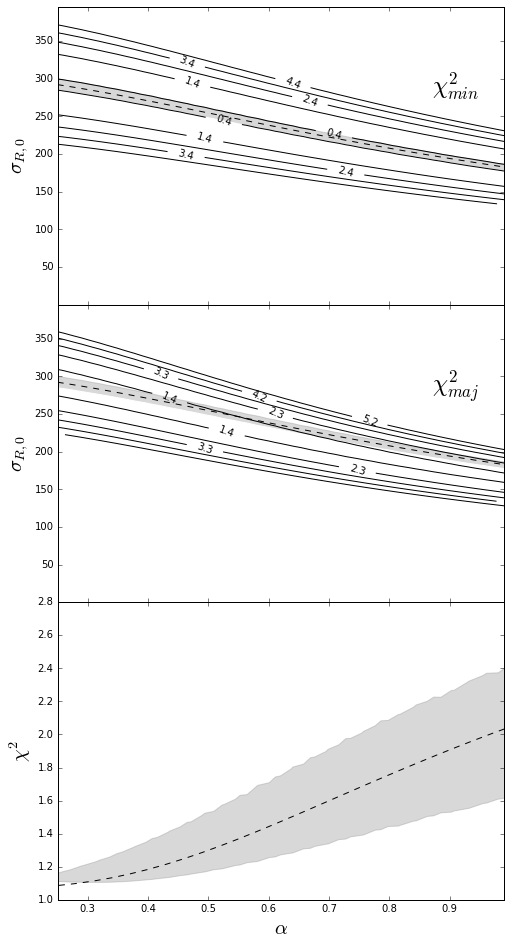

In [118]:
main_slice = lambda l: sig_min_0/sqrt(sin_i**2 + cos_i**2 * l**2)

def calc_chi2_normal(obs, obserr, predicted):
    return sum([(o-p)**2/err**2 for (o,p,err) in zip(obs, predicted, obserr)])/len(obs)

# os.chdir("C:\\Users\\root\\Dropbox\\RotationCurves\\PhD\\paper1\\text\\imgs")

alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
# levels = np.linspace(start=image_min.min(), stop=20., num=5)
# levels = [100., 125., 150., 175., 200.]
# levels = [image_min.min()+0.02, image_min.min()+0.4, image_min.min()+1.1, image_min.min()+2., 
#           image_min.min()+3.1, image_min.min()+4.1]
# levels = np.linspace(start=image_min.min()+0.1, stop=image_min.min()+4.1, num=5)
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
# im = ax.imshow(image_min, cmap='jet', vmin=image_min.min(), vmax=20., interpolation='spline16', 
#                    origin="lower", aspect="auto")
# plt.show()
cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()
v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
# ax.set_ylim(180, 300)
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')

ax = axes[1]
# levels = np.linspace(start=image_maj.min()-4.3, stop=10., num=10)
# levels = [7., 10., 50., 100.]
# levels = [image_maj.min()+0.2, image_maj.min()+0.7, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = np.linspace(start=image_maj.min()+0.3, stop=image_maj.min()+4.1, num=5)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
ax.text(0.87, 280, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')

ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
# ax.set_ylim(150, 320)

ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)

ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

# ax.set_ylim(3.1, 3.5)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)

plt.show()

N1_maj=32,	 N2_min=26,	 chi^2_corr[0][0]=30.5284790532 (was 24.7736781267 and 35.2042548059)


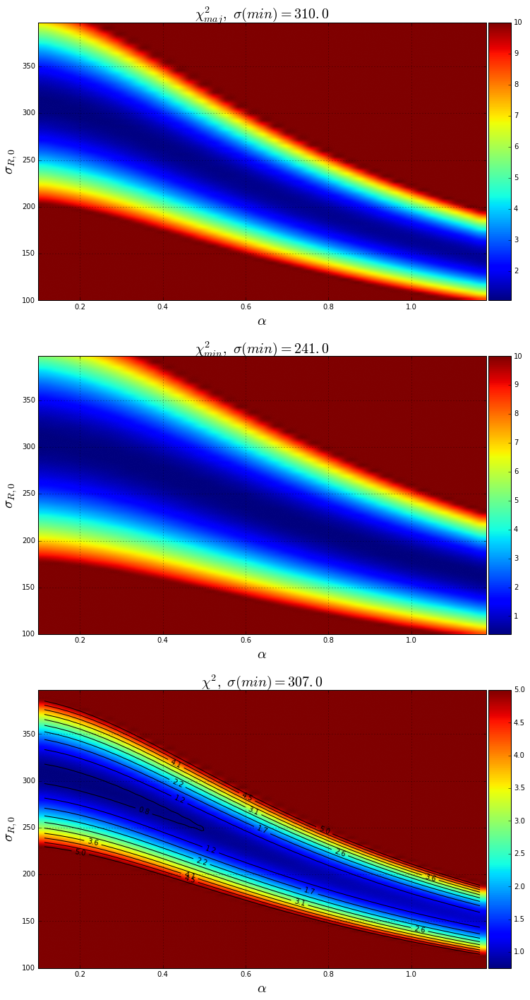

In [119]:
fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[12,24])
plot_chi2_map(image_maj, axes[0], log_scale=False, title='$\chi^2_{maj}$', is_contour=False, vmax=10.)
plot_chi2_map(image_min, axes[1], log_scale=False, title='$\chi^2_{min}$', is_contour=False, vmax=10.)
corr_image = (image_min*len(sig_min_p) + image_maj*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
print 'N1_maj={},\t N2_min={},\t chi^2_corr[0][0]={} (was {} and {})'.format(len(sig_maj_p), len(sig_min_p), corr_image[0][0], 
                                                                            image_min[0][0], image_maj[0][0])
plot_chi2_map(corr_image, axes[2], log_scale=False, title='$\chi^2$', is_contour=True, vmax=5.)
plt.show()

In [120]:
import scipy.optimize as opt

def chisqfunc((x_sig, x_alpha)):
    global sig_R_0, alpha
    sig_R_0 = x_sig
    alpha = x_alpha
    sqerr_ma = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    sqerr_mi = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
    chisq = (sqerr_mi*len(sig_min_p) + sqerr_ma*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
    return chisq

x0 = np.array([100., 0.5])

res = opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B')
print res

      fun: 0.75398050780696935
 hess_inv: <2x2 LbfgsInvHessProduct with dtype=float64>
      jac: array([ -1.11022302e-08,   2.57958432e-02])
  message: 'CONVERGENCE: NORM_OF_PROJECTED_GRADIENT_<=_PGTOL'
     nfev: 81
      nit: 18
   status: 0
  success: True
        x: array([  3.08010764e+02,   1.00000000e-01])


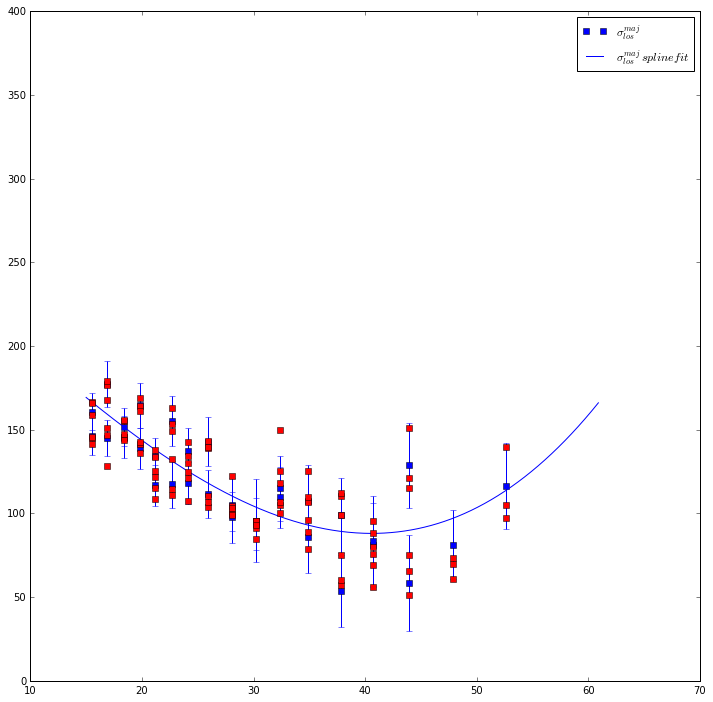

In [121]:
def gen_next_normal(radii, sig, esig):
    randomDelta =  np.array([np.random.normal(0., derr/2, 1)[0] for derr in esig] ) 
    randomdataY = sig + randomDelta
    return zip(radii, randomdataY)

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='o', marker='.', color='blue')
plt.plot(points, poly_sig_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
 
for i in range(3):
    r, s = zip(*gen_next_normal(radii_maj, sig_maj_p, e_sig_maj_p))
    plt.plot(r, s, 's', color='red')

plt.ylim(0., 400.)
plt.legend()
plt.show()

In [122]:
import time

N = 300

result = []

start_time = time.time()

for i in log_progress(range(N)):
    global poly_sig_maj, poly_sig_min
    r, s = zip(*gen_next_normal(radii_maj, sig_maj_p, e_sig_maj_p))
    poly_sig_maj = inter.UnivariateSpline(r, s, k=3, s=10000., w=w(e_sig_maj_p))
#     poly_sig_maj = poly1d(polyfit(r, s,  deg=9))
    
    r, s = zip(*gen_next_normal(radii_min, sig_min_p, e_sig_min_p))
    poly_sig_min = inter.UnivariateSpline(r, s, k=3, s=10000., w=w(e_sig_min_p))
#     poly_sig_min = poly1d(polyfit(r, s,  deg=9))
    
    result.append((opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B').x,
                  poly_sig_maj.get_coeffs(), poly_sig_min.get_coeffs()))
#     result.append((opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B').x,
#                   poly_sig_maj.coeffs, poly_sig_min.coeffs))
print("--- %s seconds ---" % (time.time() - start_time))

--- 95.6759998798 seconds ---


In [123]:
len(result)

300

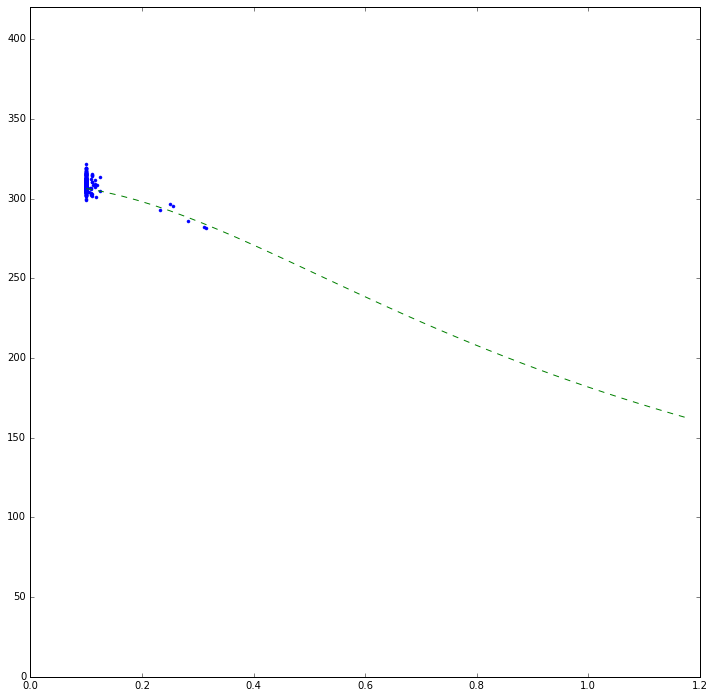

In [124]:
s, _, _ = zip(*result)
s,a = zip(*s)
plt.plot(a, s, '.')
plt.plot(alphas, map(main_slice, alphas), '--')
# plt.xlim(0.0, 0.99)
plt.ylim(0, 420)
plt.show()

# Monte-Carlo

In [125]:
import scipy.optimize as opt

def chisqfunc((x_sig, x_alpha)):
    global sig_R_0, alpha
    sig_R_0 = x_sig
    alpha = x_alpha
    sqerr_ma = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    sqerr_mi = calc_chi2_normal(sig_min_p, e_sig_min_p, [sig_min_exp(r) for r in radii_min])
    chisq = (sqerr_mi*len(sig_min_p) + sqerr_ma*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
#     print sig_R_0, alpha, chisq
    return chisq

x0 = np.array([100., 0.5])

res = opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B')
print res

      fun: 0.86618271977764238
 hess_inv: <2x2 LbfgsInvHessProduct with dtype=float64>
      jac: array([ 0.0001448 ,  0.06706294])
  message: 'CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH'
     nfev: 87
      nit: 18
   status: 0
  success: True
        x: array([  3.15057499e+02,   1.09635220e-01])


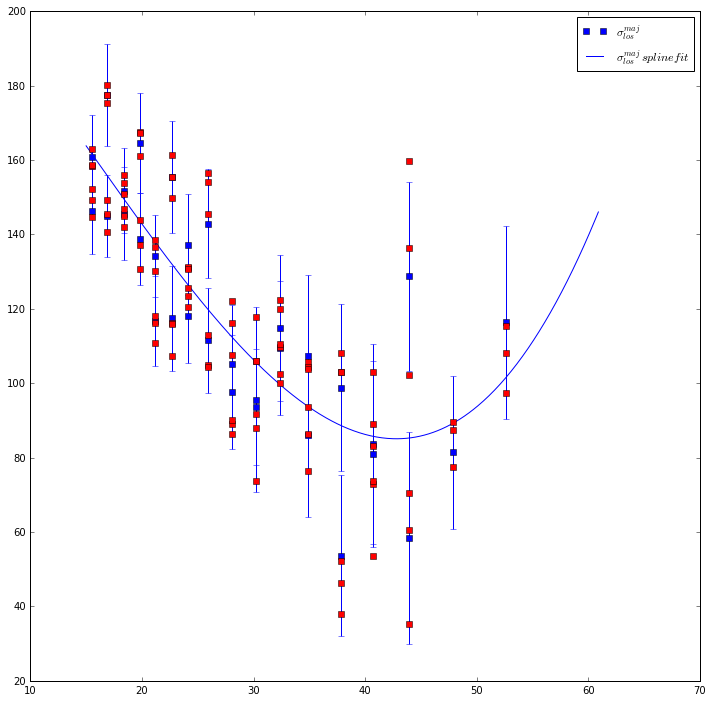

In [126]:
def gen_next_normal(radii, sig, esig):
    randomDelta =  np.array([np.random.normal(0., derr/2, 1)[0] for derr in esig] ) 
    randomdataY = sig + randomDelta
    return zip(radii, randomdataY)

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='o', marker='.', color='blue')
plt.plot(points, poly_sig_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
 
for i in range(3):
    r, s = zip(*gen_next_normal(radii_maj, sig_maj_p, e_sig_maj_p))
    plt.plot(r, s, 's', color='red')

# plt.ylim(0., 80.)
plt.legend()
plt.show()

In [127]:
os.chdir("C:\\science\\2FInstability\\data\\ngc1167")
pics_path = '.cutted\\pics\\'
import time

sig_min_0 = 200.
N = 100000

result = []

start_time = time.time()
# fig, (ax1, ax2) = plt.subplots(nrows=2, ncols=1, figsize=(16, 16))

if not os.path.exists(pics_path):
    os.makedirs(pics_path)
if os.path.isfile(pics_path + 'monte_carlo.npy'):
    result = np.load(pics_path + "monte_carlo.npy")
else:
    for i in log_progress(range(N)):
        global poly_sig_maj, poly_sig_min
        r, s = zip(*gen_next_normal(radii_maj, sig_maj_p, e_sig_maj_p))
        poly_sig_maj = inter.UnivariateSpline(r, s, k=3, s=10000., w=w(e_sig_maj_p))
#         poly_sig_maj = inter.UnivariateSpline(r, s, k=3, s=10000.)
#         ax1.plot(points, poly_sig_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
        
        r, s = zip(*gen_next_normal(radii_min, sig_min_p, e_sig_min_p))
        poly_sig_min = inter.UnivariateSpline(r, s, k=3, s=10000., w=w(e_sig_min_p))
#         poly_sig_min = inter.UnivariateSpline(r, s, k=3, s=10000.)
        
#         ax2.plot(points, poly_sig_min(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='red')
        
        result.append((opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B').x,
                      poly_sig_maj.get_coeffs(), poly_sig_min.get_coeffs()))
    np.save(pics_path + 'monte_carlo', np.array(result))
    print("--- %s seconds ---" % (time.time() - start_time))
    
# ax1.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='o', marker='.', color='red')
# ax2.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='o', marker='.', color='blue')    
# ax1.set_ylim(0., 250.)
# ax2.set_ylim(0., 250.)
# plt.show()

In [128]:
len(result)

2000

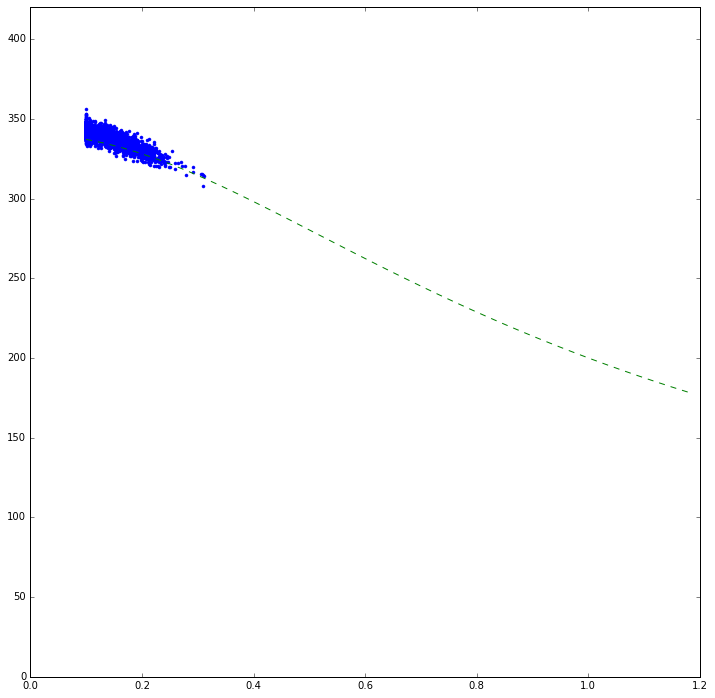

In [129]:
s, _, _ = zip(*result)
s,a = zip(*s)
plt.plot(a, s, '.')
plt.plot(alphas, map(main_slice, alphas), '--')
# plt.xlim(0.0, 0.99)
plt.ylim(0, 420)
plt.show()

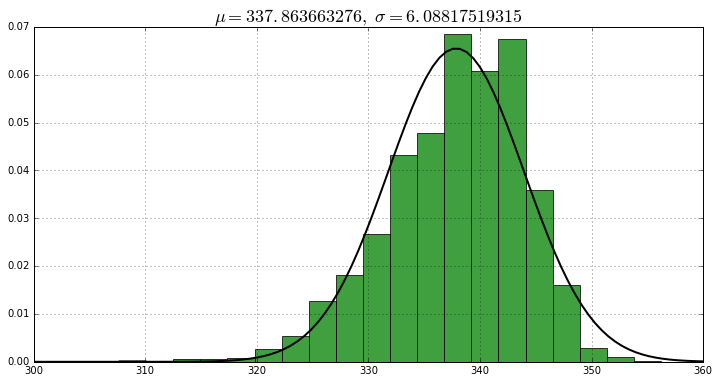

In [130]:
from scipy.stats import norm

fig = plt.figure(figsize=(12,6))
ax = fig.add_subplot(111)

n, bins, patches = ax.hist(s, 20, normed=1, facecolor='green', alpha=0.75)
mu, std = norm.fit(s)

xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)
plt.plot(x, p, 'k', linewidth=2)

ax.set_title('$\mu=%s,\ \sigma=%s$' % (mu, std), fontsize=18)
ax.grid(True)

plt.show()

In [131]:
min_n = len(radii_min)

def func(x, alph, sig):
    global alpha, sig_R_0
    alpha = alph
    sig_R_0 = sig
    return [sig_min_exp(x[l]) if l > min_n else sig_maj_exp(x[l]) for l in range(len(x))]

In [132]:
rr = radii_maj + radii_min
print len(rr), min_n
sgs = sig_maj_p + sig_min_p
esgs = e_sig_maj_p + e_sig_min_p
esgs = [l/2 for l in esgs]

58 26


In [133]:
popt, pcov = opt.curve_fit(func, rr, sgs, sigma=esgs, absolute_sigma=True)
print popt, pcov

s_sq = np.array([((np.array(func(rr, popt[0], popt[1]))-np.array(sgs))**2)[l]/esgs[l] for l in range(len(rr))]).sum()/(len(rr)-2)
pcov = pcov * s_sq
for i in range(len(pcov)):
    print sqrt(pcov[i][i])

[  3.10782301e-01   3.14518819e+02] [[  1.11503518e-02  -2.05639302e+00]
 [ -2.05639302e+00   3.85816144e+02]]
0.723777702393
134.632872917


In [134]:
def err_pcov(popt, pcov):
    s_sq = np.array([((np.array(func(rr, popt[0], popt[1]))-np.array(sgs))**2)[l]
                     /esgs[l]**2 for l in range(len(rr))]).sum()/(len(rr)-2)
    pcov = pcov * s_sq
    return (sqrt(pcov[0][0]), sqrt(pcov[1][1]))

In [135]:
import time

N = 100

result1 = []
start_time = time.time()

for i in log_progress(range(N)):
    global spl_maj, spl_min
    r, s = zip(*gen_next_normal(radii_maj, sig_maj_p, e_sig_maj_p))
    r1, s1 = zip(*gen_next_normal(radii_min, sig_min_p, e_sig_min_p))
    rr = r + r1
    sgs = s + s1
    popt, pcov = opt.curve_fit(func, rr, sgs, sigma=esgs, absolute_sigma=True)
    err = err_pcov(popt, pcov)
    result1.append((popt[0], popt[1], err[0], err[1]))
print("--- %s seconds ---" % (time.time() - start_time))

--- 87.4949998856 seconds ---


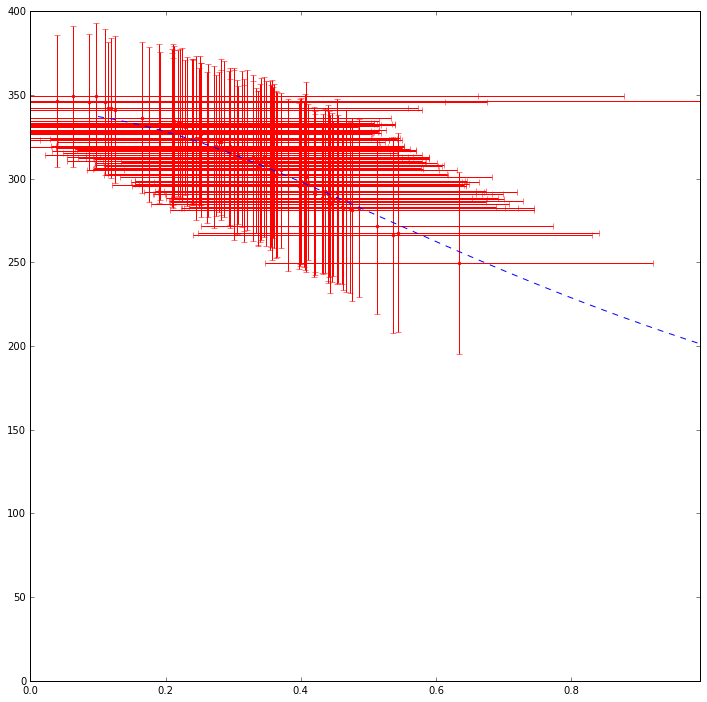

In [136]:
a,s,erra,errs = zip(*result1)
# plt.plot(a, s, '.')
plt.errorbar(a, s, yerr=errs, xerr=erra, fmt='o', marker='.', color='red')
plt.plot(alphas, map(main_slice, alphas), '--')
plt.xlim(0.0, 0.99)
plt.ylim(0, 400)
plt.show()

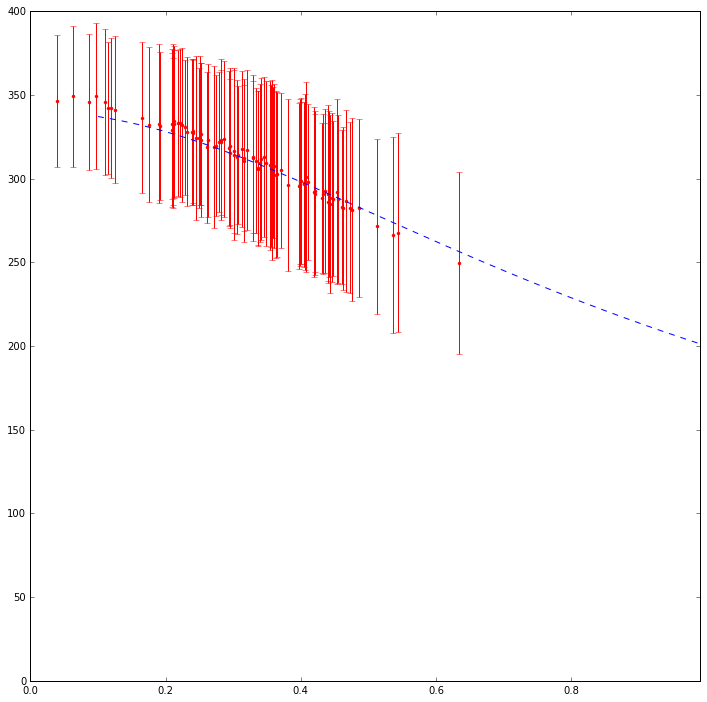

In [137]:
plt.errorbar(a, s, yerr=errs, fmt='o', marker='.', color='red')
plt.plot(alphas, map(main_slice, alphas), '--')
plt.xlim(0.0, 0.99)
plt.ylim(0, 400)
plt.show()

# Exponent on the edge

In [138]:
cutted = 15.0

bind_curve = lambda p: (abs(p[0]), abs(p[1]), p[2])
sig_maj_data = zip(r_ma, sig_ma, e_sig_ma)
sig_maj_data = map(bind_curve, sig_maj_data)
sig_maj_data.sort()
sig_maj_data = filter(lambda l: l[0] > cutted, sig_maj_data)
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data) 

sig_min_data = zip(r_mi_extend, sig_mi, e_sig_mi)
sig_min_data = map(bind_curve, sig_min_data)
sig_min_data.sort()
sig_min_data = filter(lambda l: l[0] > cutted, sig_min_data)
radii_min, sig_min_p, e_sig_min_p = zip(*sig_min_data)


def fuu(x, A, B):
    return A*x + B

# ind = [True if radii_min[l] > 15. and radii_min[l] < 30. else False for l in range(len(radii_min))]
#from 15'' to 30''
A,B = curve_fit(fuu, radii_min[:14], map(np.log, sig_min_p[:14]))[0]
print A, B

-0.0190221634649 5.4363013152


In [139]:
def fuu1(x, A, B):
    return np.exp(A*x+B)

52.57


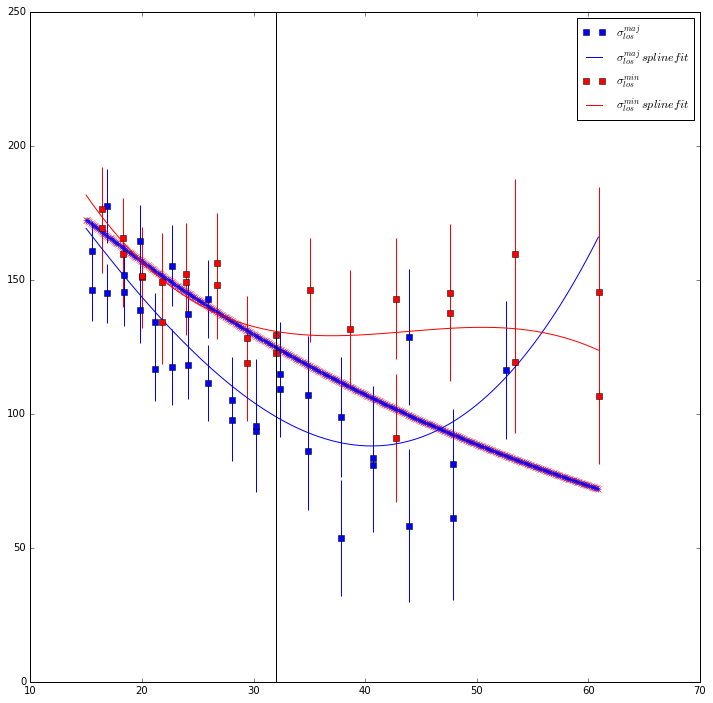

In [140]:
h_kin = float("{0:.2f}".format(-1./A))
print h_kin

plt.plot(points, fuu1(points, A, B), 'x', color='red')
plt.plot(points, map(lambda l: np.exp(B)*np.exp(-l/h_kin), points), '+')

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='.', marker='.', mew=0, color='blue')
plt.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
plt.plot(radii_min, sig_min_p, 's', label='$\sigma_{los}^{min}$', color='red')
plt.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='.', marker='.', mew=0, color='red')
plt.plot(points, spl_min(points), label = '$\sigma_{los}^{min}\, splinefit$', color='red')
plt.axvline(x=radii_min[14], color='black')
plt.legend()
plt.ylim(0, 250)
plt.show()

In [141]:
def sigR_ger_exp(R):
    return sig_R_0*exp(-R/h_kin)

def sigZ_ger_exp(R):
    return sigR_ger_exp(R)*alpha

def sigPhi_ger_exp(R):
    return sigPhi_to_sigR_real(R) * sigR_ger_exp(R)

def sig_maj_exp(R):
    return sqrt(sigPhi_ger_exp(R)**2 * sin_i**2 + sigZ_ger_exp(R)**2 * cos_i**2)

def sig_min_exp(R):
    return sqrt(sigR_ger_exp(R)**2 * sin_i**2 + sigZ_ger_exp(R)**2 * cos_i**2)

In [142]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

radii_maj1, sig_maj_p1, e_sig_maj_p1 = radii_maj, sig_maj_p, e_sig_maj_p
radii_min1, sig_min_p1, e_sig_min_p1 = radii_min, sig_min_p, e_sig_min_p

sig_maj_data = zip(radii_maj, sig_maj_p, e_sig_maj_p)
sig_maj_data = filter(lambda l: l[0] < radii_min[14], sig_maj_data)
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data) 
radii_min, sig_min_p, e_sig_min_p = radii_min[:14], sig_min_p[:14], e_sig_min_p[:14]

image, image_maj, image_min = compute_chi2_maps(alphas=alphas, sigmas=sigmas)

radii_maj, sig_maj_p, e_sig_maj_p = radii_maj1, sig_maj_p1, e_sig_maj_p1
radii_min, sig_min_p, e_sig_min_p = radii_min1, sig_min_p1, e_sig_min_p1

sig_maj_data = zip(radii_maj, sig_maj_p, e_sig_maj_p)
sig_min_data = zip(radii_min, sig_min_p, e_sig_min_p)

N1_maj=33,	 N2_min=26,	 chi^2_corr[0][0]=55.8507334797 (was 40.6304165742 and 67.8424983143)


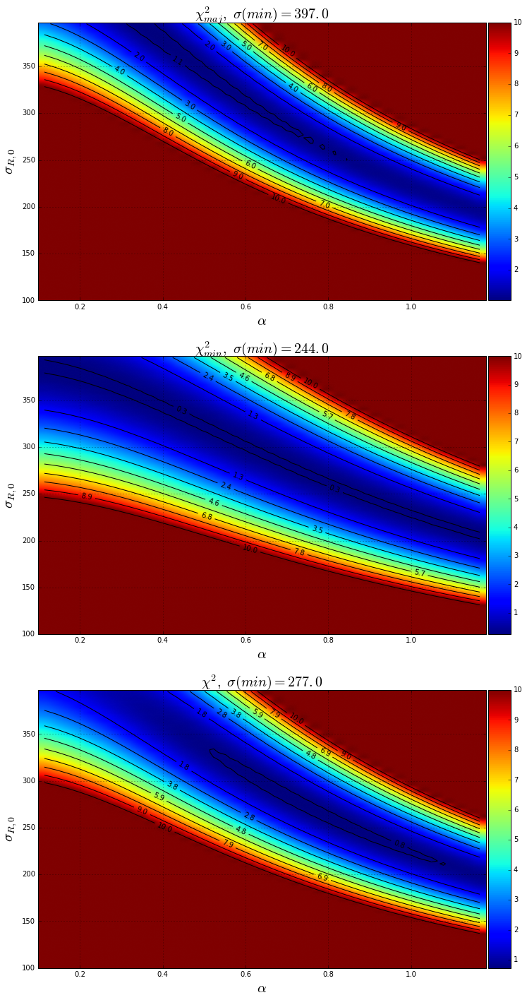

In [143]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[12,24])
plot_chi2_map(image_maj, axes[0], log_scale=False, title='$\chi^2_{maj}$', is_contour=True, vmax=10.)
plot_chi2_map(image_min, axes[1], log_scale=False, title='$\chi^2_{min}$', is_contour=True, vmax=10.)
corr_image = (image_min*len(sig_min_p) + image_maj*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
print 'N1_maj={},\t N2_min={},\t chi^2_corr[0][0]={} (was {} and {})'.format(len(sig_maj_p), len(sig_min_p), corr_image[0][0], 
                                                                            image_min[0][0], image_maj[0][0])
plot_chi2_map(corr_image, axes[2], log_scale=False, title='$\chi^2$', is_contour=True, vmax=10.)
plt.show()

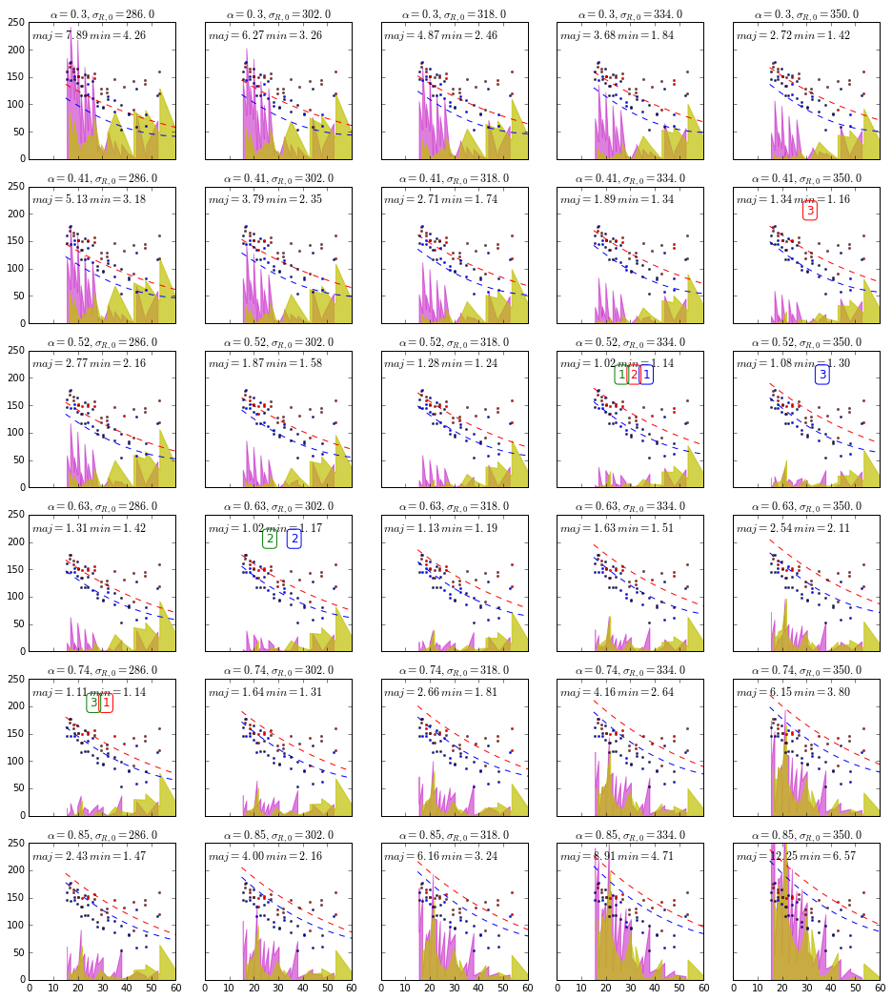

In [144]:
alphas = np.arange(0.3, 0.9, 0.11)
sigmas = np.arange(286., 366., 16.)

plot_ranges(sigmas, alphas, good_pics=good_pics, calc_chi=True)
plt.show()

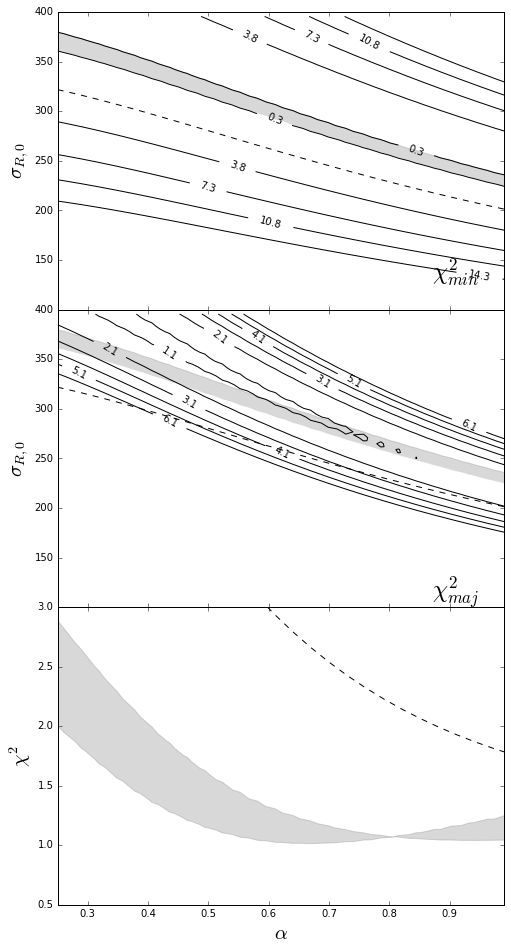

In [145]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
levels = np.linspace(start=image_min.min()*1.2, stop=image_min.min()*1.1+14, num=5)

cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()

v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
# ax.text(0.87, 172, '$\chi^2_{min}$', size = 24.)
ax.text(0.87, 130, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
ax.set_ylim(100, 400)
# ax.set_ylim(40, 200)


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')

ax = axes[1]
# levels = np.append(np.linspace(start=image_maj.min()+0.1, stop=image_maj.min()+4.1, num=6), np.array([image_maj.min()+0.25]))
levels = np.linspace(start=image_maj.min()*1.1, stop=image_maj.min()*1.1+5, num=6)
# levels = [image_maj.min()+0.1, image_maj.min()+0.25, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = sorted(levels)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
# ax.text(0.87, 172, '$\chi^2_{maj}$', size = 24.)
ax.text(0.87, 110, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')

ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
ax.set_ylim(100, 400)
# ax.set_ylim(50, 120)

ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)


import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)

ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

ax.set_ylim(0.5, 3.)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)

plt.show()

--- 7.375 seconds ---


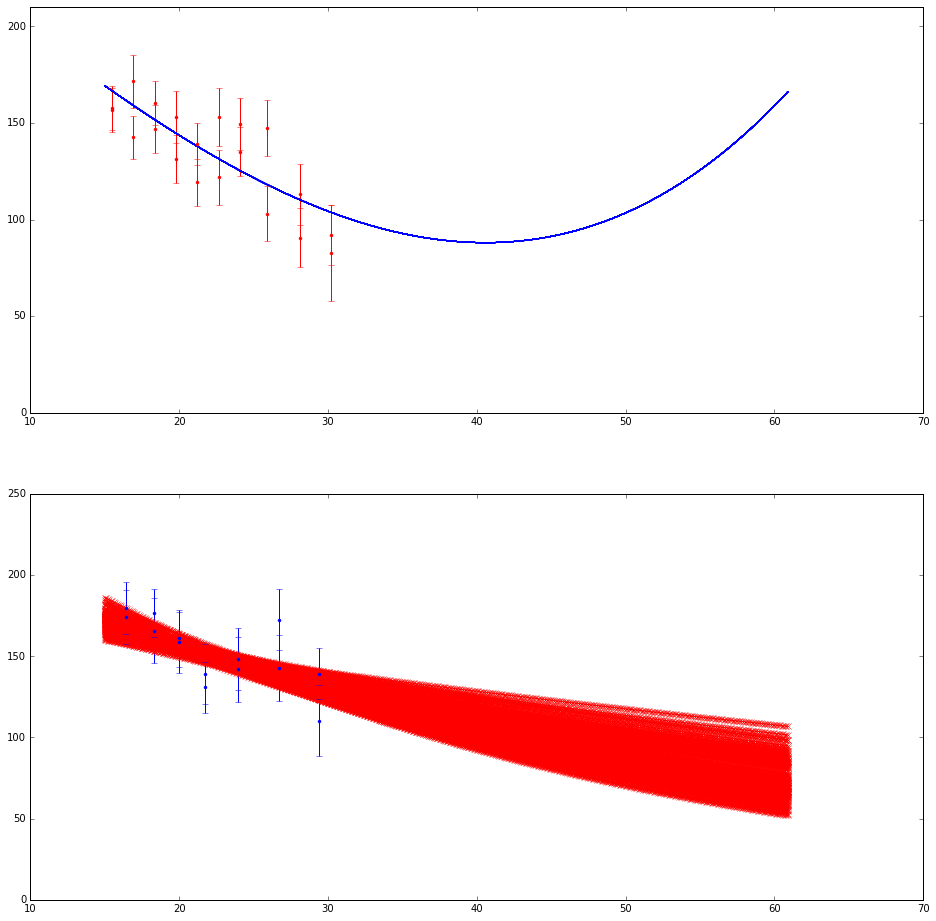

In [146]:
import time

N = 100

result = []
start_time = time.time()

fig, (ax1, ax2) = plt.subplots(nrows=2, ncols=1, figsize=(16, 16))

sig_maj_data = zip(radii_maj, sig_maj_p, e_sig_maj_p)
sig_maj_data = filter(lambda l: l[0] < radii_min[14], sig_maj_data)
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data) 
radii_min, sig_min_p, e_sig_min_p = radii_min[:14], sig_min_p[:14], e_sig_min_p[:14]

radii_maj2, sig_maj_p2, e_sig_maj_p2 = radii_maj, sig_maj_p, e_sig_maj_p
radii_min2, sig_min_p2, e_sig_min_p2 = radii_min, sig_min_p, e_sig_min_p

for i in log_progress(range(N)):
    global radii_min, radii_maj, sig_min_p, sig_maj_p
    global A,B,h_kin

    r, s = zip(*gen_next_normal(radii_maj2, sig_maj_p2, e_sig_maj_p2))
    radii_maj, sig_maj_p = r, s

    ax1.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')

    r, s = zip(*gen_next_normal(radii_min2, sig_min_p2, e_sig_min_p2))
    A, B = curve_fit(fuu, r, map(np.log, s))[0]
#     print A,B
    h_kin = float("{0:.2f}".format(-1./A))
#     print h_kin
    radii_min, sig_min_p = r, s

    ax2.plot(points, map(lambda l: np.exp(B)*np.exp(-l/h_kin), points), '-', color='red')
    ax2.plot(points, fuu1(points, A, B), 'x', color='red')

    res = opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B')
    result.append(res.x)
print("--- %s seconds ---" % (time.time() - start_time))
    
ax1.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='o', marker='.', color='red')
ax2.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='o', marker='.', color='blue')    
ax1.set_ylim(0., 210.)
ax2.set_ylim(0., 250.)
plt.show()

radii_maj, sig_maj_p, e_sig_maj_p = radii_maj1, sig_maj_p1, e_sig_maj_p1
radii_min, sig_min_p, e_sig_min_p = radii_min1, sig_min_p1, e_sig_min_p1

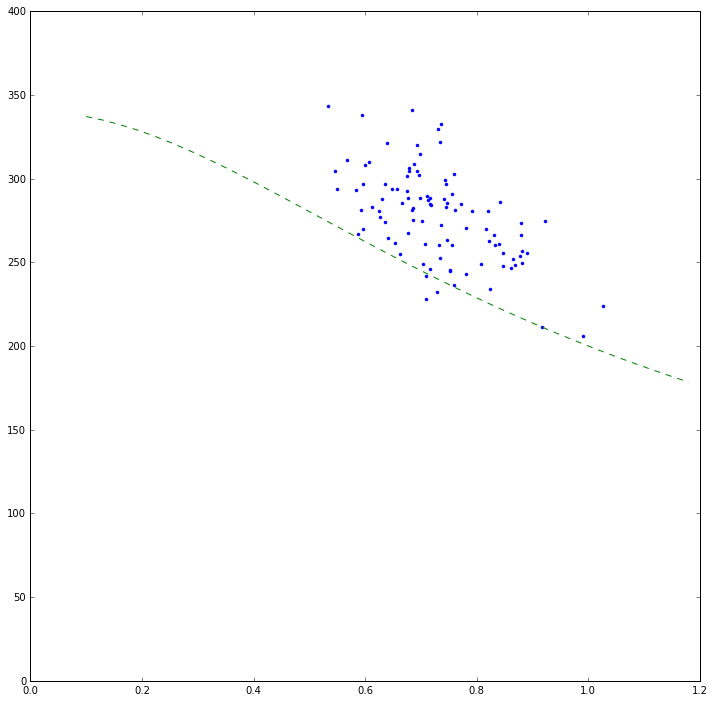

In [147]:
s,a = zip(*result)
plt.plot(a, s, '.')
plt.plot(alphas, map(main_slice, alphas), '--')
# plt.xlim(0.0, 0.99)
plt.ylim(0, 400)
plt.show()

# Exponent on the edge 2

Возьмем прямой участок и подгоним экспонентами: 
$$\sigma_R = \sigma_{R,0}e^{-R/h}$$ $$\sigma_Z = \sigma_{Z,0}e^{-R/h}$$

In [148]:
bind_curve = lambda p: (abs(p[0]), abs(p[1]), p[2])
sig_maj_data = zip(r_ma, sig_ma, e_sig_ma)
sig_maj_data = map(bind_curve, sig_maj_data)
sig_maj_data.sort()
sig_maj_data = filter(lambda l: l[0] > 30. and l[0] < 62., sig_maj_data)
radii_maj, sig_maj_p, e_sig_maj_p = zip(*sig_maj_data) 

sig_min_data = zip(r_mi_extend, sig_mi, e_sig_mi)
sig_min_data = map(bind_curve, sig_min_data)
sig_min_data.sort()
sig_min_data = filter(lambda l: l[0] > 30. and l[0] < 62. and l[1] > 100., sig_min_data)
radii_min, sig_min_p, e_sig_min_p = zip(*sig_min_data)


points = np.arange(30., 62., 0.1)

def fuu(x, A, B):
    return A*x + B

#from 30'' to 60''
A,B = curve_fit(fuu, radii_min, map(np.log, sig_min_p))[0]
print A, B

-0.000744089214043 4.93524296143


In [149]:
def fuu1(x, A, B):
    return np.exp(A*x+B)

1343.92


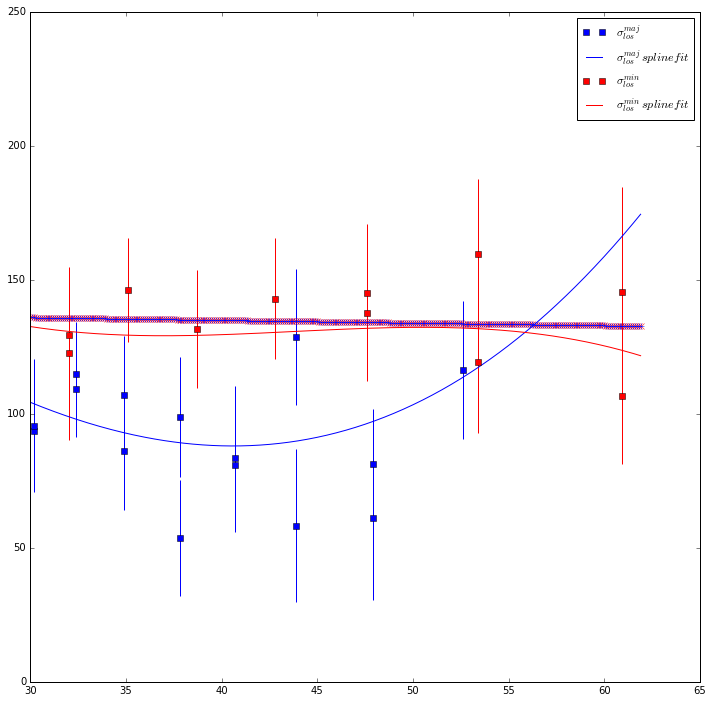

In [150]:
h_kin = float("{0:.2f}".format(-1./A))
print h_kin

plt.plot(points, fuu1(points, A, B), 'x', color='red')
plt.plot(points, map(lambda l: np.exp(B)*np.exp(-l/h_kin), points), '+')

plt.plot(radii_maj, sig_maj_p, 's', label='$\sigma_{los}^{maj}$', color='blue')
plt.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='.', marker='.', mew=0, color='blue')
plt.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')
plt.plot(radii_min, sig_min_p, 's', label='$\sigma_{los}^{min}$', color='red')
plt.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='.', marker='.', mew=0, color='red')
plt.plot(points, spl_min(points), label = '$\sigma_{los}^{min}\, splinefit$', color='red')
# plt.axvline(x=radii_min[14], color='black')
plt.legend()
plt.ylim(0, 250)
plt.show()

In [151]:
def sigR_ger_exp(R):
    return sig_R_0*exp(-R/h_kin)

def sigZ_ger_exp(R):
    return sigR_ger_exp(R)*alpha

def sigPhi_ger_exp(R):
    return sigPhi_to_sigR_real(R) * sigR_ger_exp(R)

def sig_maj_exp(R):
    return sqrt(sigPhi_ger_exp(R)**2 * sin_i**2 + sigZ_ger_exp(R)**2 * cos_i**2)

def sig_min_exp(R):
    return sqrt(sigR_ger_exp(R)**2 * sin_i**2 + sigZ_ger_exp(R)**2 * cos_i**2)

In [152]:
alpha = 0.25
sig_R_0 = main_slice(alpha)
print sig_min_exp(0.0), fuu1(0.0, A, B)

200.0 139.106936047


In [153]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(100.0, 400, 3.)

radii_maj1, sig_maj_p1, e_sig_maj_p1 = radii_maj, sig_maj_p, e_sig_maj_p
radii_min1, sig_min_p1, e_sig_min_p1 = radii_min, sig_min_p, e_sig_min_p

image, image_maj, image_min = compute_chi2_maps(alphas=alphas, sigmas=sigmas)

radii_maj, sig_maj_p, e_sig_maj_p = radii_maj1, sig_maj_p1, e_sig_maj_p1
radii_min, sig_min_p, e_sig_min_p = radii_min1, sig_min_p1, e_sig_min_p1

sig_maj_data = zip(radii_maj, sig_maj_p, e_sig_maj_p)
sig_min_data = zip(radii_min, sig_min_p, e_sig_min_p)

N1_maj=15,	 N2_min=11,	 chi^2_corr[0][0]=8.97232638418 (was 11.1565190511 and 7.37058509512)


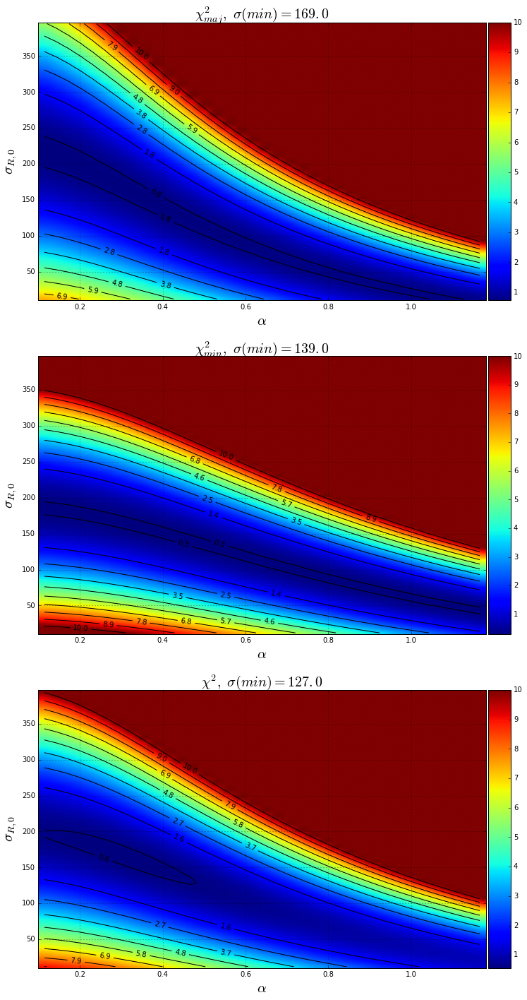

In [154]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(10.0, 400, 3.)

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=False, sharey=True, figsize=[12,24])
plot_chi2_map(image_maj, axes[0], log_scale=False, title='$\chi^2_{maj}$', is_contour=True, vmax=10.)
plot_chi2_map(image_min, axes[1], log_scale=False, title='$\chi^2_{min}$', is_contour=True, vmax=10.)
corr_image = (image_min*len(sig_min_p) + image_maj*len(sig_maj_p)) / (len(sig_min_p) + len(sig_maj_p))
print 'N1_maj={},\t N2_min={},\t chi^2_corr[0][0]={} (was {} and {})'.format(len(sig_maj_p), len(sig_min_p), corr_image[0][0], 
                                                                            image_min[0][0], image_maj[0][0])
plot_chi2_map(corr_image, axes[2], log_scale=False, title='$\chi^2$', is_contour=True, vmax=10.)
plt.show()

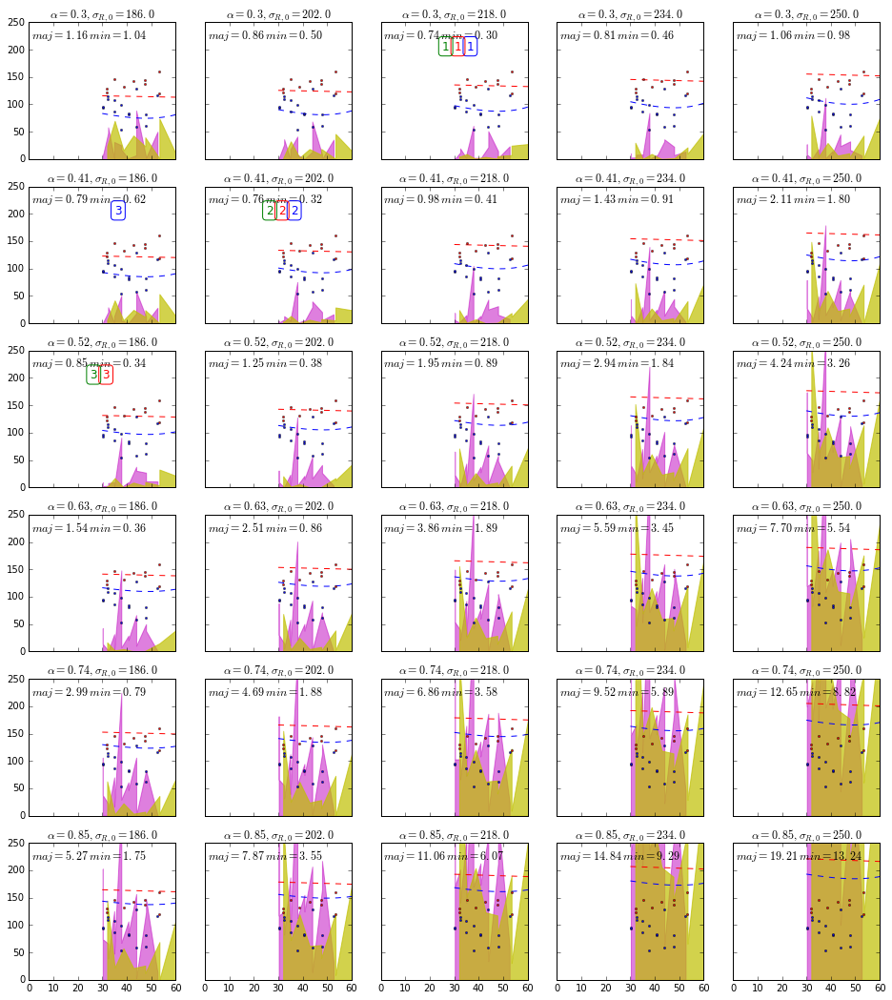

In [155]:
alphas = np.arange(0.3, 0.9, 0.11)
sigmas = np.arange(186., 266., 16.)

plot_ranges(sigmas, alphas, good_pics=good_pics, calc_chi=True)
plt.show()

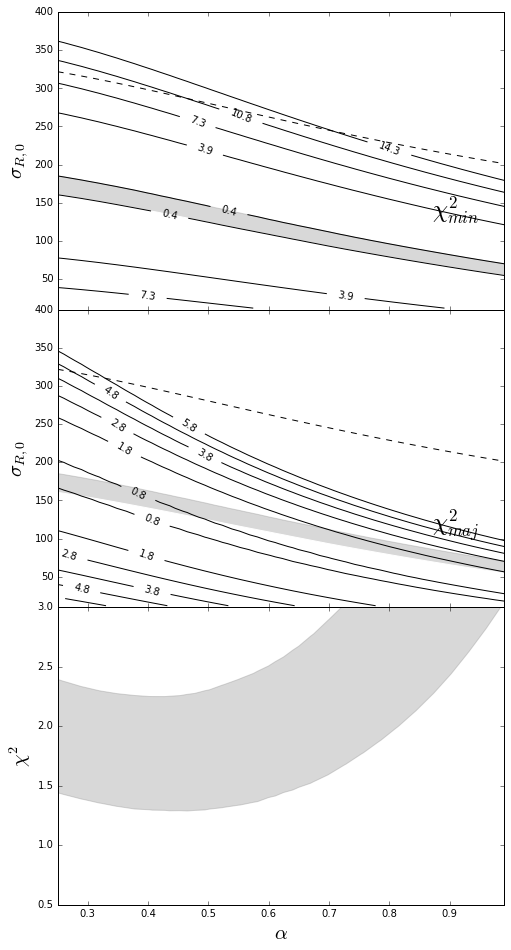

In [156]:
alphas = np.arange(0.1, 1.2, 0.03)
sigmas = np.arange(10.0, 400, 3.)

import matplotlib.mlab as mlab
import matplotlib

fig, axes = plt.subplots(nrows=3, ncols=1, sharex=True, sharey=False, figsize=[8,16])
ax = axes[0]
levels = np.linspace(start=image_min.min()*1.1, stop=image_min.min()*1.1+4, num=5)
levels = np.linspace(start=image_min.min()*1.2, stop=image_min.min()*1.1+14, num=5)

cset=ax.contour(image_min, levels,  colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
min_map_gutter = cset.collections[0].get_paths()

v1,v2 = min_map_gutter[1].vertices, min_map_gutter[0].vertices
x1,x2 = v1[:,0], v2[:,0]
y1,y2 = v1[:,1], v2[:,1]
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
# ax.text(0.87, 172, '$\chi^2_{min}$', size = 24.)
ax.text(0.87, 130, '$\chi^2_{min}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')
ax.set_ylim(10, 400)
# ax.set_ylim(40, 200)


min_sigmas = np.where(image_min < image_min.min() + 0.03)
slice_alph, slice_sig = min_sigmas[1], min_sigmas[0]
slice_alph = map(lambda l: alphas[0] + (alphas[-1] - alphas[0])*l/len(image_min[0]) , slice_alph)
slice_sig = map(lambda l: sigmas[0] + (sigmas[-1] - sigmas[0])*l/len(image_min), slice_sig)
# ax.plot(slice_alph, slice_sig, '.', color='pink')
poly_slice = poly1d(polyfit(slice_alph, slice_sig, deg=3))
# ax.plot(xx, poly_slice(xx), '.-', color='black')
ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')

ax = axes[1]
# levels = np.append(np.linspace(start=image_maj.min()+0.1, stop=image_maj.min()+4.1, num=6), np.array([image_maj.min()+0.25]))
levels = np.linspace(start=image_maj.min()*1.1, stop=image_maj.min()*1.1+5, num=6)
# levels = [image_maj.min()+0.1, image_maj.min()+0.25, image_maj.min()+1.1, image_maj.min()+2.1, image_maj.min()+3.1, 
#           image_maj.min()+4.1]
levels = sorted(levels)
cset=ax.contour(image_maj, levels, hold='on', colors = 'k', origin='lower', extent=[alphas[0],alphas[-1],sigmas[0],sigmas[-1]])
plt.clabel(cset, inline=1, fontsize=10, fmt='%1.1f',)
# ax.text(0.87, 172, '$\chi^2_{maj}$', size = 24.)
ax.text(0.87, 110, '$\chi^2_{maj}$', size = 24.)
ax.set_ylabel('$\sigma_{R,0}$', size=20.)
xx = np.arange(0.25, 1.0, 0.01)
ax.plot(xx, map(main_slice, xx), '--', color='black')

ax.fill_between(x1, y1, 0, color='gray', alpha=0.3)
ax.fill_between(x2, y2, 0, color='white')
ax.set_ylim(10, 400)
# ax.set_ylim(50, 120)

ax = axes[2]
err_maj = []
for al in alphas:
    global alpha, sig_R_0
    alpha = al
    sig_R_0 = main_slice(al)
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj.append(sqerr_maj)
ax.plot(alphas, err_maj, '--', color='black')
err_maj1 = []
for pa in zip(x2,y2):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj1.append(sqerr_maj)
# ax.plot(x2, err_maj1, '-', color='black')
err_maj2 = []
for pa in zip(x1,y1):
    global alpha, sig_R_0
    alpha = pa[0]
    sig_R_0 = pa[1]
    sqerr_maj = calc_chi2_normal(sig_maj_p, e_sig_maj_p, [sig_maj_exp(r) for r in radii_maj])
    err_maj2.append(sqerr_maj)
# ax.plot(x1, err_maj2, '-', color='black')
ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)


import scipy.interpolate as sp
try:
    f1 = sp.interp1d(x2, err_maj1, kind='linear')
    ax.fill_between(x1, map(f1, x1), err_maj2, color='grey', alpha=0.3)
except Exception:
    f2 = sp.interp1d(x1, err_maj2, kind='linear')
    ax.fill_between(x2, map(f2, x2), err_maj1, color='grey', alpha=0.3)

ax.set_ylabel(r'$\chi^2$', size=20.)
ax.set_xlabel(r'$\alpha$', size=20.)

ax.set_ylim(0.5, 3.)


fig.subplots_adjust(hspace=0.)
axes[0].yaxis.get_major_ticks()[0].set_visible(False)
axes[1].yaxis.get_major_ticks()[0].set_visible(False)
ax.set_xlim(0.25, 0.99)

plt.show()

--- 5.8900001049 seconds ---


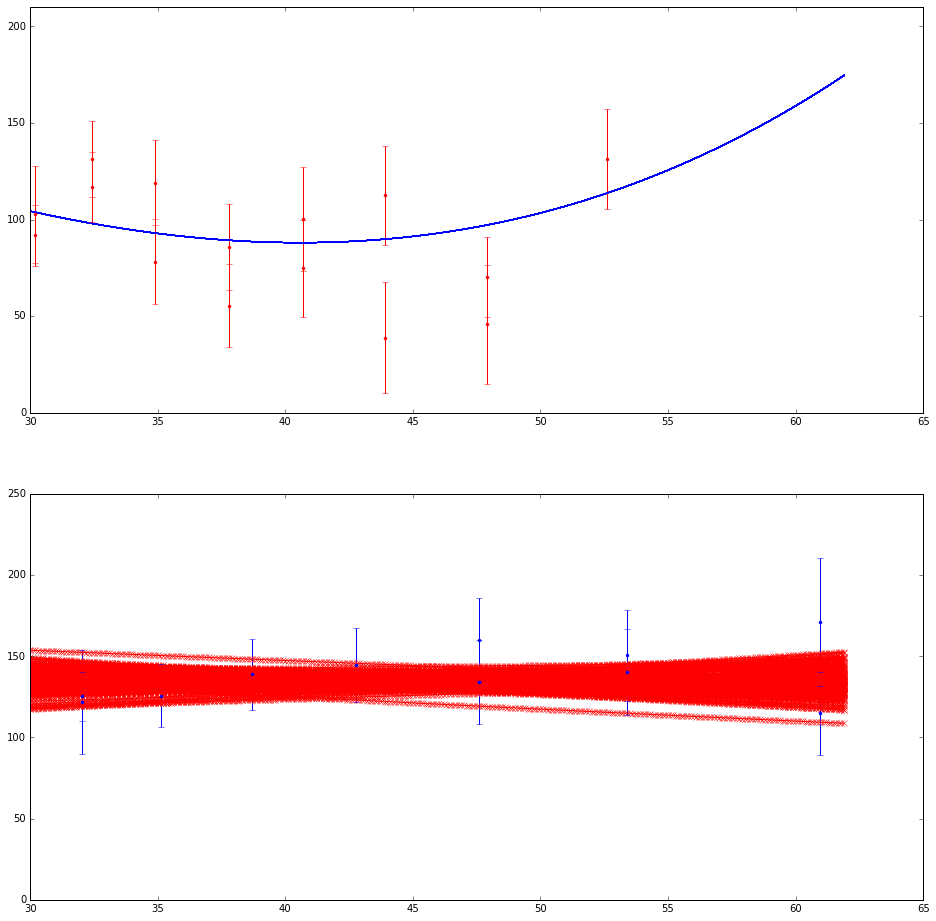

In [157]:
import time

N = 100

result = []
start_time = time.time()

fig, (ax1, ax2) = plt.subplots(nrows=2, ncols=1, figsize=(16, 16))

radii_maj2, sig_maj_p2, e_sig_maj_p2 = radii_maj, sig_maj_p, e_sig_maj_p
radii_min2, sig_min_p2, e_sig_min_p2 = radii_min, sig_min_p, e_sig_min_p

for i in log_progress(range(N)):
    global radii_min, radii_maj, sig_min_p, sig_maj_p
    global A,B,h_kin

    r, s = zip(*gen_next_normal(radii_maj2, sig_maj_p2, e_sig_maj_p2))
    radii_maj, sig_maj_p = r, s

    ax1.plot(points, spl_maj(points), label = '$\sigma_{los}^{maj}\, splinefit$', color='blue')

    r, s = zip(*gen_next_normal(radii_min2, sig_min_p2, e_sig_min_p2))
    A, B = curve_fit(fuu, r, map(np.log, s))[0]
#     print A,B
    h_kin = float("{0:.2f}".format(-1./A))
#     print h_kin
    radii_min, sig_min_p = r, s

    ax2.plot(points, map(lambda l: np.exp(B)*np.exp(-l/h_kin), points), '-', color='red')
    ax2.plot(points, fuu1(points, A, B), 'x', color='red')

    res = opt.minimize(chisqfunc, x0, bounds=[(sigmas[0], sigmas[-1]), (alphas[0], alphas[-1])], method='L-BFGS-B')
    result.append(res.x)
print("--- %s seconds ---" % (time.time() - start_time))
    
ax1.errorbar(radii_maj, sig_maj_p, yerr=e_sig_maj_p, fmt='o', marker='.', color='red')
ax2.errorbar(radii_min, sig_min_p, yerr=e_sig_min_p, fmt='o', marker='.', color='blue')    
ax1.set_ylim(0., 210.)
ax2.set_ylim(0., 250.)
plt.show()

radii_maj, sig_maj_p, e_sig_maj_p = radii_maj1, sig_maj_p1, e_sig_maj_p1
radii_min, sig_min_p, e_sig_min_p = radii_min1, sig_min_p1, e_sig_min_p1

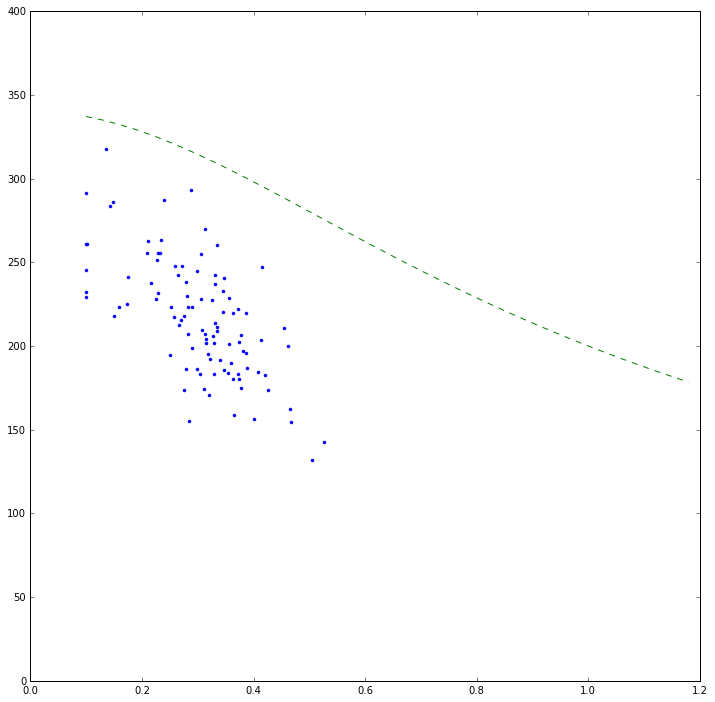

In [158]:
s,a = zip(*result)
plt.plot(a, s, '.')
plt.plot(alphas, map(main_slice, alphas), '--')
# plt.xlim(0.0, 0.99)
plt.ylim(0, 400)
plt.show()